### Least square solving with u.n_s = v_s.n_s

In [11]:
import numpy as np
import scipy.optimize
import math
import matplotlib.pyplot as plt


def velocity_frame(pos, vel, size):
    frame = np.zeros(size * size * 2)
    for p in pos:
        frame[(p[0] * size + p[1]) * 2] = vel[0]
        frame[(p[0] * size + p[1]) * 2 + 1] = vel[1]

    return frame

def normals_frame(pos, normals, size):
    frame = np.zeros(size * size * 2)
    for p, n in zip(pos, normals):
        frame[(p[0] * size + p[1]) * 2] = n[0]
        frame[(p[0] * size + p[1]) * 2 + 1] = n[1]

    return frame

# Positions = np.array([])
Velocities = np.array([])
Normals = np.array([])
Times = np.array([])

BodyNormals = []
grid_res = 0
N_points = 0
skipped = 0

min_x = 20
max_x = 0
min_y = 20
max_y = 0

file = "accelerations_input"
print("Opening file:", file)
print("Reading...")
with open(file) as acc_file:
    N_boundary_cells = int(acc_file.readline())
    N_inner_cells = int(acc_file.readline())
    N_curves = int(acc_file.readline())
    grid_res = int(acc_file.readline())
    grid_res = 8
    print("curves:", N_curves)
    print("boundary cells:", N_boundary_cells)
    print("inner cells:", N_inner_cells)
    print("grid size: ", grid_res)

    # read normals
    for _ in range(N_boundary_cells):
        BodyNormals.append(list(map(float, acc_file.readline().split())))
    
    for _ in range(min(1, N_curves)):
        N_points = int(acc_file.readline())
        print("size of curve:", N_points)
        for i in range(N_points):
            boundary_pos = []
            inner_pos = []
            times = []

            # times.append(float(acc_file.readline()))  # should be added when a point is passed

            # read body pos
            for _ in range(N_boundary_cells):
                boundary_pos.append(list(map(int, acc_file.readline().split())))

                min_x = min(min_x, boundary_pos[-1][0])
                max_x = max(max_x, boundary_pos[-1][0])
                min_y = min(min_y, boundary_pos[-1][1])
                max_y = max(max_y, boundary_pos[-1][1])

            for _ in range(N_inner_cells):
                inner_pos.append(list(map(int, acc_file.readline().split())))
                if i == 0 or i == N_points - 1:
                    print(inner_pos[0])

            # read velocity (and acceleration that is not used)
            # pos = list(map(float, acc_file.readline().split()))
            vel = list(map(float, acc_file.readline().split()))
            acc = list(map(float, acc_file.readline().split()))

            if not math.isnan(vel[0]):
                # Positions += inner_pos
                Velocities = np.concatenate((Velocities, velocity_frame(boundary_pos + inner_pos, vel, grid_res)))
                Normals = np.concatenate((Normals, normals_frame(boundary_pos, BodyNormals, grid_res)))
                # Times = np.concatenate((Times, np.array(times)))
            else:
                skipped += 1


N_points -= skipped
print("Points skipped:", skipped)

print('Finished reading the file, total:')
print('Velocities shape:', Velocities.shape)
print('Normals shape:', Normals.shape)

# Times.reshape((N_curves, N_points))

print(min_x, min_y, max_x, max_y)

Opening file: accelerations_input
Reading...
curves: 1
boundary cells: 8
inner cells: 1
grid size:  8
size of curve: 60
[1, 1]
[5, 3]
Points skipped: 1
Finished reading the file, total:
Velocities shape: (7552,)
Normals shape: (7552,)
0 0 6 4


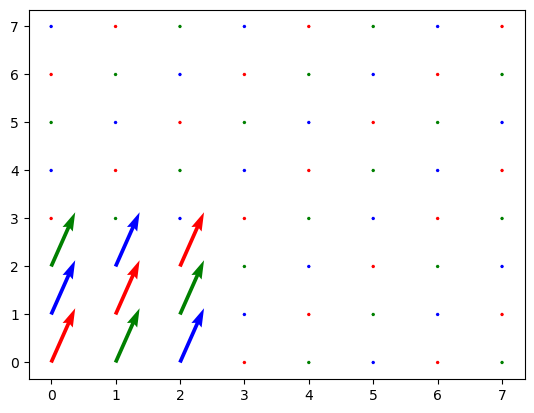

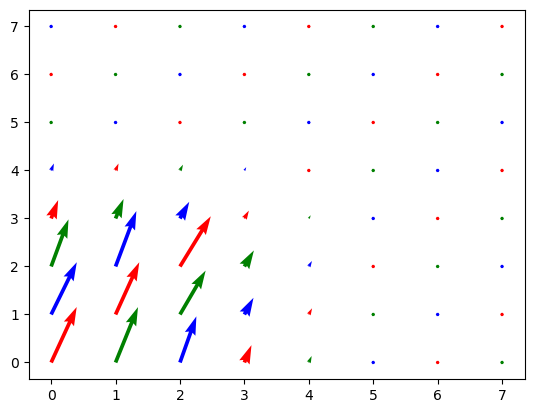

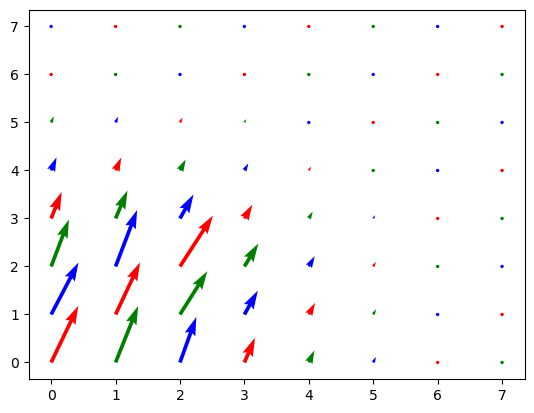

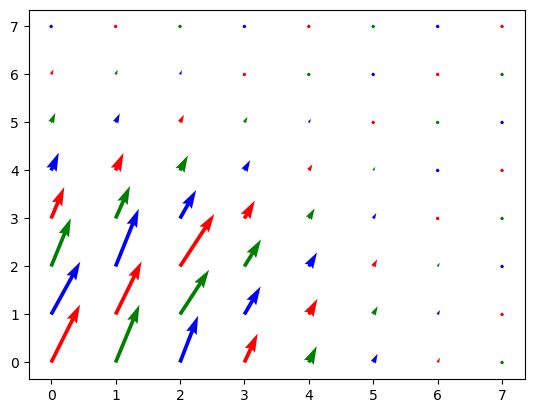

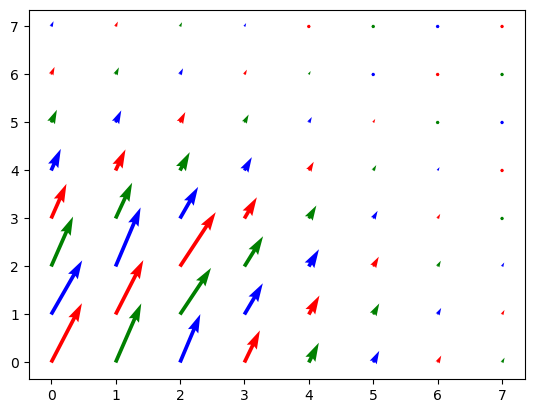

In [76]:
### for the frames of one curve

V = Velocities.copy()
N = Normals.copy()

n_frames = N_points
width = grid_res
height = grid_res
cells = width * height

Uinit = np.zeros(n_frames * width * height * 2)
U = np.zeros(n_frames * width * height * 2)

X = np.zeros(width * height)
Y = np.zeros(width * height)
for i in range(height):
    for j in range(width):
        X[i * width + j] = i
        Y[i * width + j] = j
P = np.array([X, Y])

for frame in range(5):
# for frame in range(n_frames):
    # Get data corresponding to the considered frame
    UinitFrame = Uinit[frame * cells * 2: (frame+1) * cells * 2]
    NFrame = N[frame * cells * 2: (frame+1) * cells * 2]
    VFrame = V[frame * cells * 2: (frame+1) * cells * 2]

    assert len(NFrame) == cells * 2

    # Set the constraint equality
    A = np.zeros([cells, cells * 2])
    B = np.zeros([cells])
    for cell in range(cells):
        A[cell, cell * 2: (cell+1) * 2] = NFrame[cell * 2: (cell+1) * 2]
        B[cell] = np.dot(VFrame[cell * 2: (cell+1) * 2],
                         NFrame[cell * 2: (cell+1) * 2])
    Binf = np.copy(B)
    Bsup = np.copy(B)
    for cell in range(cells):
        if B[cell] == 0:
            Binf[cell] = -np.inf
            Bsup[cell] = np.inf
            A[cell] = np.ones(cells * 2)

    # cons = ({'type': 'eq', 'fun': lambda x:  A @ x - B})
    cons = scipy.optimize.LinearConstraint(A, Binf, Bsup)
    # cons = scipy.optimize.LinearConstraint(A, lb=B, ub=B, keep_feasible=False)

    # Solve
    if frame == 0:
        UFrame = VFrame
    else:
        def f(x):
            timeGradient = x-U[(frame-1) * cells * 2: frame * cells * 2]
            firstSpaceDimGradient = x[: (cells-width) * 2] - x[width * 2:]
            xWithoutFirstCol = np.array([x[i] for i in range(cells * 2) if i % (width * 2) != 0 and i % (width * 2) != 1])
            xWithoutLastCol = np.array([x[i] for i in range(cells * 2) if i % (width * 2) != (width * 2 - 2) and i % (width * 2) != (width * 2 - 1)])
            secondSpaceDimGradient = xWithoutLastCol - xWithoutFirstCol
            # spaceGradient = firstSpaceDimGradient + secondSpaceDimGradient
            return np.sum(firstSpaceDimGradient**2) + np.sum(secondSpaceDimGradient**2) + np.sum(timeGradient**2)
        resFrame = scipy.optimize.minimize(f, UinitFrame, constraints=cons)
        UFrame = resFrame.x

    # Display N, V and U
    # plt.quiver(*P, np.array([NFrame[i] for i in range(0, 2*cells, 2)]),
    #            np.array([NFrame[i] for i in range(1, 2*cells, 2)]), color=['r', 'b', 'g'], scale=21)
    # plt.show()

    # plt.quiver(*P, np.array([VFrame[i] for i in range(0, 2*cells, 2)]),
    #            np.array([VFrame[i] for i in range(1, 2*cells, 2)]), color=['r', 'b', 'g'], scale=21)
    # plt.show()

    plt.quiver(*P, np.array([UFrame[i] for i in range(0, 2 * cells, 2)]),
               np.array([UFrame[i] for i in range(1, 2*cells, 2)]), color=['r', 'b', 'g'], scale=0.15)
    # plt.savefig('example_initial/frame_' + str(frame) + '.png')
    plt.show()

    U[(2*cells)*frame:(2*cells)*(frame+1)] = UFrame

### Fluid simulation

In [74]:
#renew U_sf

U_sf = UFrame.copy()
U_sf = U_sf.reshape((height, width, 2))
U_ref = U_sf.copy()

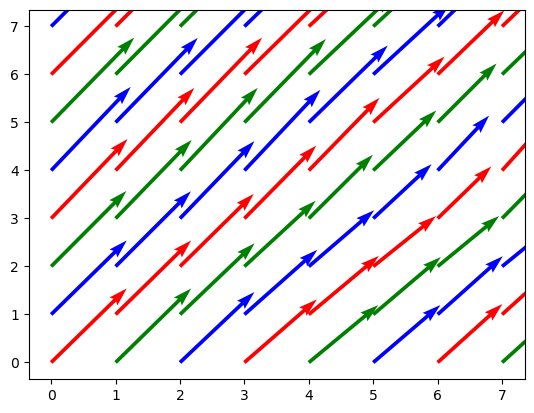

In [75]:
# show current U_sf

plt.quiver(*P, np.array(U_sf[:, :, 0]), np.array(U_sf[:, :, 1]), color=['r', 'b', 'g'], scale=0.15)
plt.show()

In [56]:
# get and diffuse

def get(U, x, y):
    if x < 0:
        return get(U, 0, y)
    if x >= height:
        return get(U, height - 1, y)
    if y < 0:
        return get(U, x, 0)
    if y >= width:
        return get(U, x, width - 1)
    return U[int(x), int(y)]


def diffuse(U):
    mu = 0.2
    dt = 0.2
    a = mu * dt
    b = 1. / (1. + 4 * a)
    new_U = U.copy()

    for i in range(20):
        for x in range(height):
            for y in range (width):
                new_U[x, y] = b * (get(U, x, y) + a * (get(new_U, x - 1, y) + get(new_U, x + 1, y) + get(new_U, x, y - 1) + get(new_U, x, y + 1)))
    set_boundaries(new_U)
    
    return new_U

[6.91966212e-07 1.55882498e-06] [0. 0.]


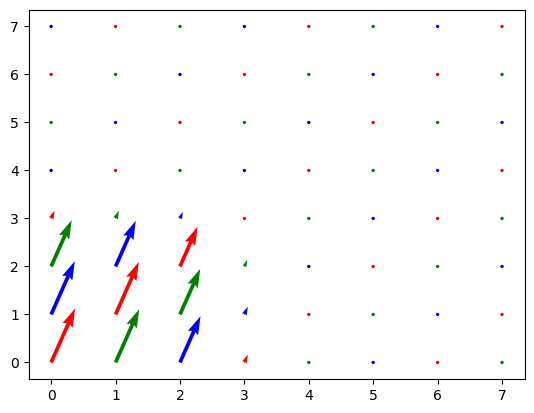

In [143]:
# apply diffuse

for i in range(1):
    U_sf = diffuse(U_sf)
    print(U_sf[1, 6], U_ref[1, 6])
    if i % 40 == 0:
        plt.quiver(*P, np.array(U_sf[:, :, 0]), np.array(U_sf[:, :, 1]), color=['r', 'b', 'g'], scale=0.15)
        # plt.savefig('diffuse/frame_' + str(i) + '.png')
        plt.show()

In [15]:
# interpolation and advect

from math import floor

def interpolation(U, x, y):
    x0 = floor(x)
    y0 = floor(y)

    if x0 == x and y0 == y:
        return get(U, x, y)

    x1 = x0 + 1
    y1 = y0 + 1

    dx = x - x0
    dy = y - y0

    ans = (1 - dx) * (1 - dy) * get(U, x0, y0)
    ans += (1 - dx) * dy * get(U, x0, y1)
    ans += dx * (1 - dy) * get(U, x1, y0)
    ans += dx * dy * get(U, x1, y1)

    # print(x, y, U[x0, y0], ans)

    return ans


def advect(U):
    dt = 10
    new_U = U.copy()

    for x in range(1, height - 1):
        for y in range (1, width - 1):
            # v = 0.25 * (interpolation(U, x + 0.5, y + 0.5) + interpolation(U, x + 0.5, y - 0.5) + interpolation(U, x - 0.5, y + 0.5) + interpolation(U, x - 0.5, y - 0.5))
            v = U[x, y]
            new_U[x, y] = interpolation(U, x - dt * v[0], y - dt * v[1])

            if x == 3 and y == 3:
                print(U[x, y], new_U[x, y], x - dt * v[0], y - dt * v[1])

    return new_U

[0.00035997 0.00081092] [0.00037032 0.00083425] 2.996400311036583 2.991890810576918


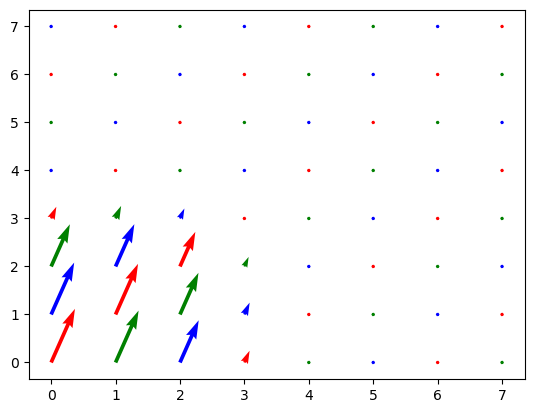

[0.00037032 0.00083425] [0.00038161 0.00085968] 2.9962967605261093 2.991657537448928


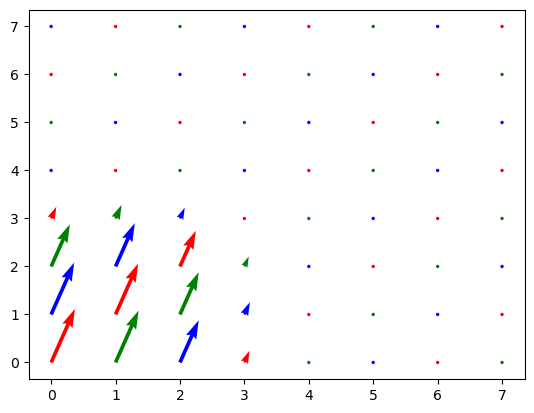

[0.00038161 0.00085968] [0.00039396 0.0008875 ] 2.9961838539116123 2.991403187383303


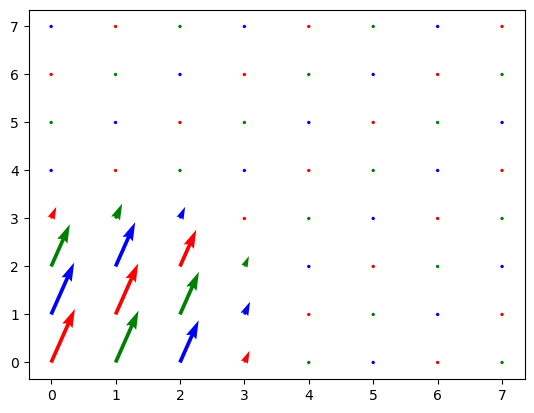

[0.00039396 0.0008875 ] [0.0004075 0.000918 ] 2.9960603806329256 2.9911250332939536


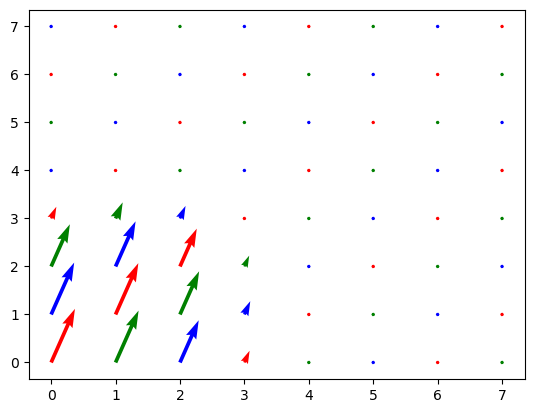

[0.0004075 0.000918 ] [0.0004224  0.00095155] 2.995924963356175 2.990819972395779


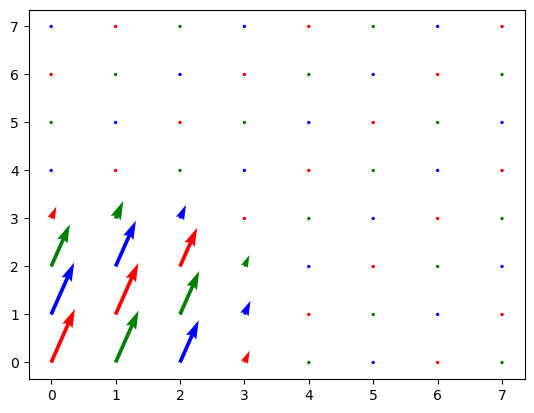

[0.0004224  0.00095155] [0.00043882 0.00098854] 2.995776040755852 2.990484487417029


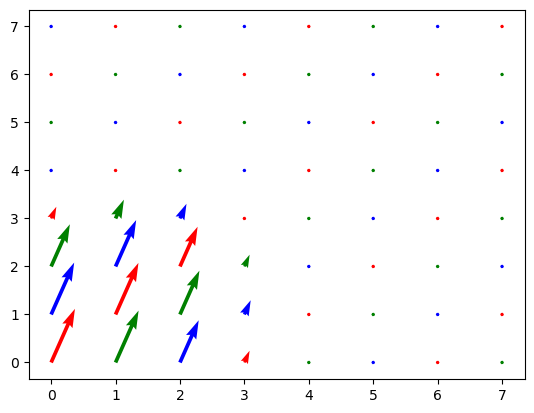

[0.00043882 0.00098854] [0.00045696 0.00102941] 2.9956118499970024 2.990114607136104


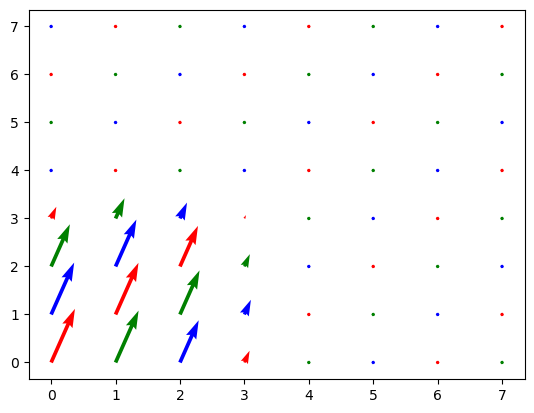

[0.00045696 0.00102941] [0.00047705 0.00107467] 2.9954304095012523 2.9897058675577664


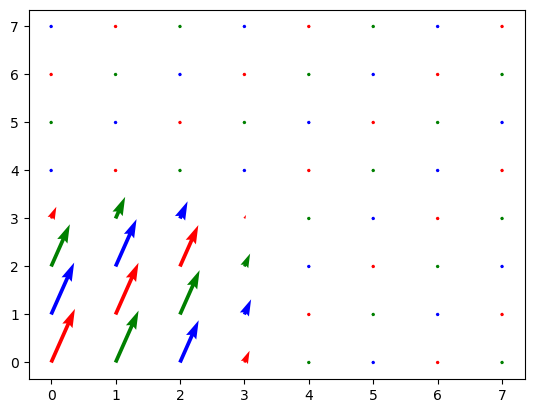

[0.00047705 0.00107467] [0.00049933 0.00112487] 2.9952295028097082 2.9892532755603316


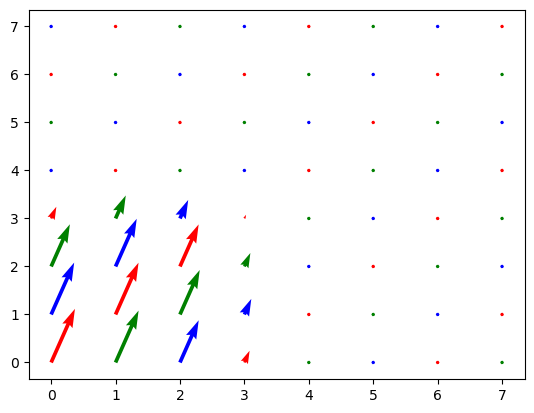

[0.00049933 0.00112487] [0.00052408 0.00118063] 2.9950066646158127 2.9887512774312266


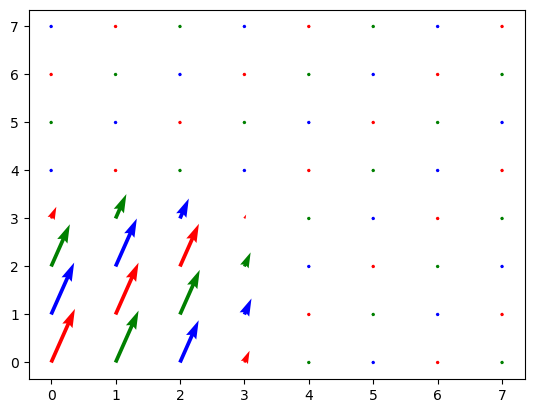

In [175]:
# apply advect

for i in range(10):
    U_sf = advect(U_sf)
    plt.quiver(*P, np.array(U_sf[:, :, 0]), np.array(U_sf[:, :, 1]), color=['r', 'b', 'g'], scale=0.15)
    # plt.savefig('advect/frame_' + str(i) + '.png')
    plt.show()

In [71]:
# divergence free

def set_boundaries(grid):
    for x in range(1, height - 1):
        grid[x, 0] = grid[x, 1]
        grid[x, width - 1] = grid[x, width - 2]

    for y in range(1, width):
        grid[0, y] = grid[1, y]
        grid[height - 1, y] = grid[height - 2, y]

    grid[0, 0] = (grid[1, 0] + grid[0, 1]) / 2.
    grid[height - 1, 0] = (grid[height - 2, 0] + grid[height - 1, 1]) / 2.
    grid[0, width - 1] = (grid[1, width - 1] + grid[0, width - 2]) / 2.
    grid[height - 1, width - 1] = (grid[height - 2, width - 1] + grid[height - 1, width - 2]) / 2.

def set_boundaries_reflective(grid):
    set_boundaries(grid)
    for x in range(1, height - 1):
        grid[x, 0][1] *= -1.
        grid[x, width - 1][1] *= -1.

    for y in range(1, width - 1):
        grid[0, y][0] *= -1.
        grid[height - 1, y][0] *= -1.


def divergence_free(U):
    new_U = U.copy()
    divergence = np.zeros((height, width))
    gradient_field = np.zeros((height, width))

    for x in range(1, height - 1):
        for y in range (1, width - 1):
            divergence[x, y] = (get(U, x + 1, y)[0] - get(U, x - 1, y)[0] + get(U, x, y + 1)[1] - get(U, x, y - 1)[1]) / 2
    set_boundaries(divergence)

    for _ in range(15):
        for x in range(1, height - 1):
            for y in range (1, width - 1):
                gradient_field[x, y] = (gradient_field[x - 1, y] + gradient_field[x + 1, y] + gradient_field[x, y - 1] + gradient_field[x, y + 1] - divergence[x, y]) / 4.
    set_boundaries(gradient_field)

    for x in range(1, height - 1):
        for y in range (1, width - 1):
            nabla_q = np.array([(gradient_field[x + 1, y] - gradient_field[x - 1, y]) / 2, (gradient_field[x, y + 1] - gradient_field[x, y - 1] / 2)])
            new_U[x, y] = get(U, x, y) - nabla_q
    set_boundaries(new_U)

    return new_U


[0.02120306 0.02220146] [0.02139706 0.02215208] 2.787969435857666 2.7779853947947366


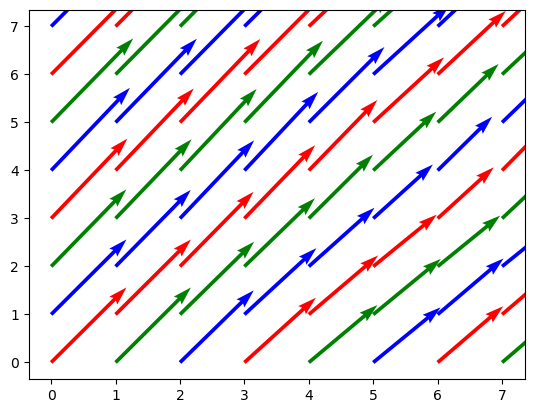

[0.02112594 0.02211092] [0.02132711 0.02213801] 2.7887406278090774 2.778890780495734


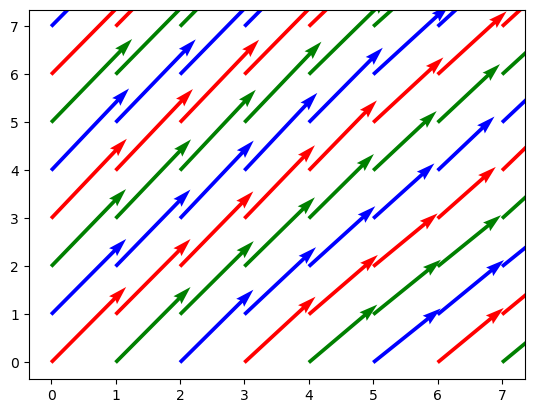

[0.02118202 0.02212146] [0.02137005 0.02218433] 2.7881797700030795 2.7787853624825054


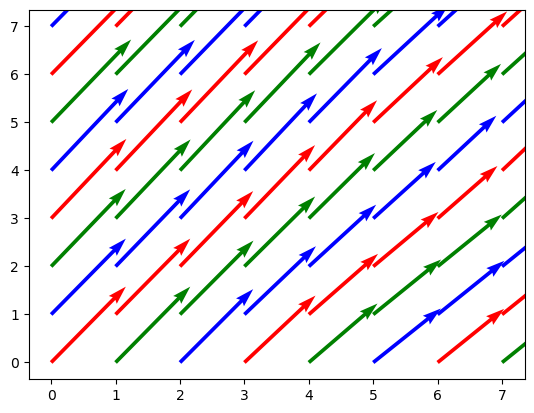

[0.02127691 0.02217909] [0.02144611 0.02226449] 2.787230934968765 2.778209088724996


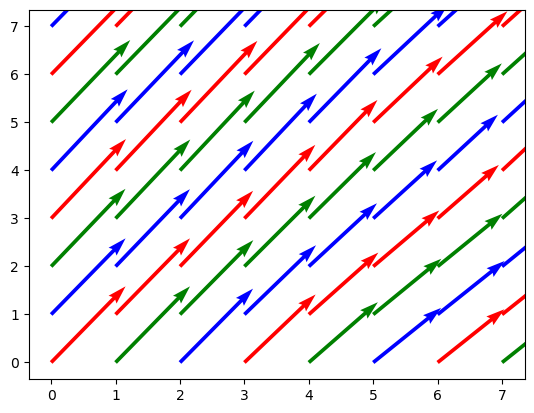

[0.02137581 0.02226102] [0.02152468 0.02236108] 2.786241949448558 2.7773898282002296


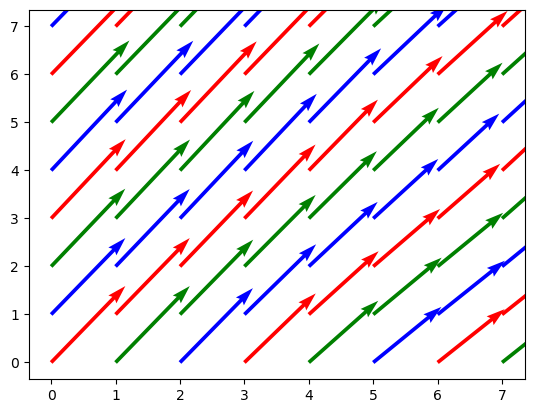

In [72]:
for i in range(5):
    U_sf = diffuse(U_sf)
    U_sf = divergence_free(U_sf)
    U_sf = advect(U_sf)
    plt.quiver(*P, np.array(U_sf[:, :, 0]), np.array(U_sf[:, :, 1]), color=['r', 'b', 'g'], scale=0.15)
    # plt.savefig('advect/frame_' + str(i) + '.png')
    plt.show()

### Combine the optimization and simulation

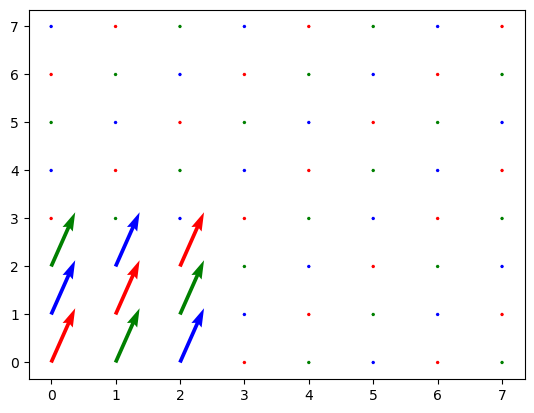

[0.00311954 0.00042207] [0.00303888 0.00045449] 2.9688046468985845 2.995779289237553
[ 0.00653223 -0.00093192] [ 0.00629025 -0.00079043] 2.9346776792129603 3.009319237133189
[0.00790168 0.00032044] [0.00778223 0.00042471] 2.9209832325146965 2.996795606391809


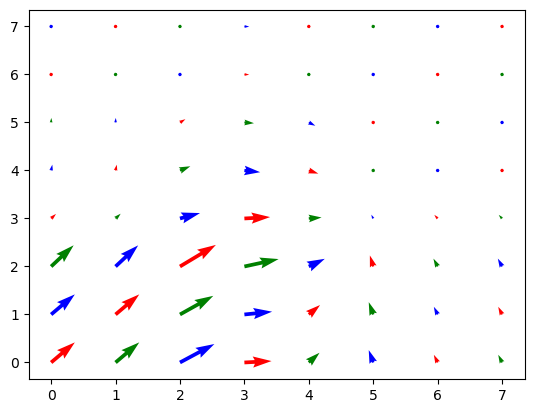

/usr/lib/python3/dist-packages/scipy/optimize/_constraints.py:386: OptimizeWarning: At least one constraint is unbounded above and below. Such constraints are ignored.
  warn("At least one constraint is unbounded above and below. Such "


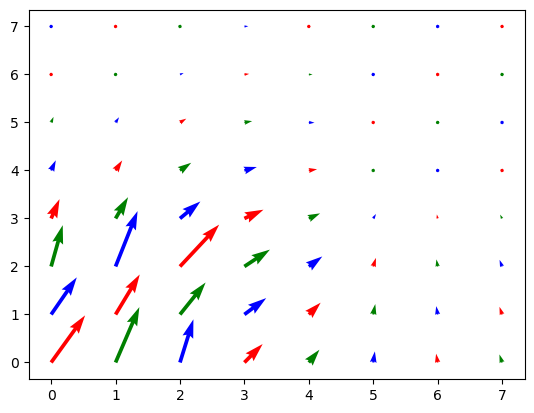

[0.00672378 0.0018955 ] [0.00671243 0.0020374 ] 2.9327622077739064 2.98104504275134
[0.00812036 0.00095144] [0.00810088 0.00112165] 2.918796374158699 2.990485572657029
[0.0083804  0.00189473] [0.0084623  0.00204574] 2.9161959658174985 2.981052744660958


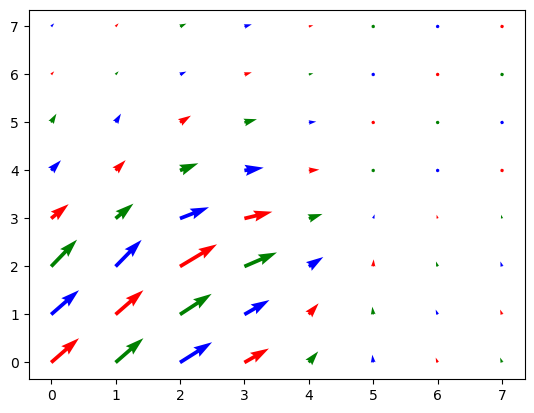

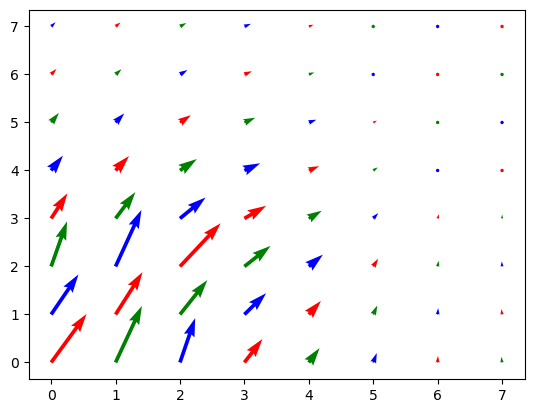

[0.00738424 0.00277922] [0.00741085 0.00294236] 2.9261576382729584 2.9722078351738532
[0.00903546 0.00192666] [0.00904362 0.00213797] 2.90964544555743 2.9807334089796886
[0.00950692 0.00312095] [0.00960751 0.00332922] 2.904930763886555 2.968790462112877


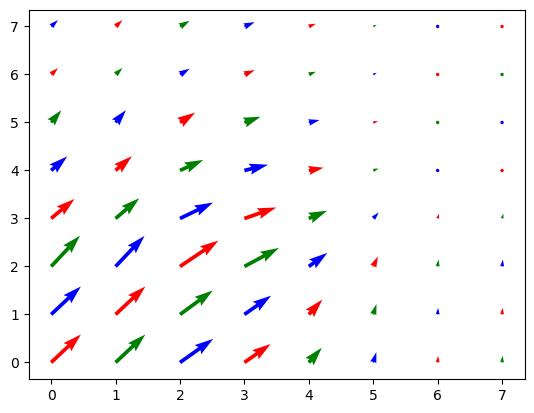

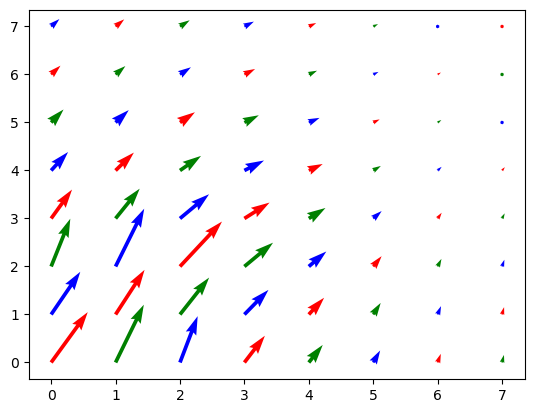

[0.00837594 0.00403147] [0.00841662 0.00421517] 2.9162405558979105 2.959685268620389
[0.00988705 0.00319635] [0.00990712 0.0034399 ] 2.901129515177474 2.96803646781279
[0.01040417 0.00424063] [0.01050231 0.00449459] 2.895958255441697 2.9575936725123406


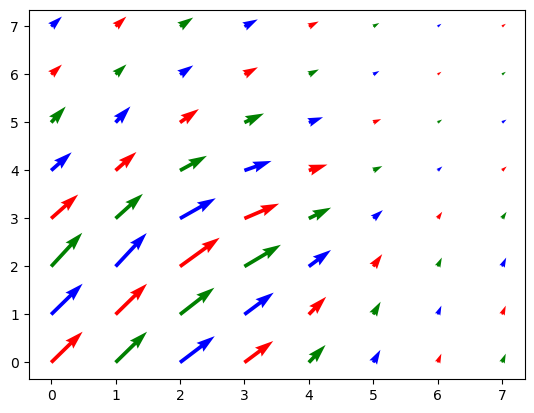

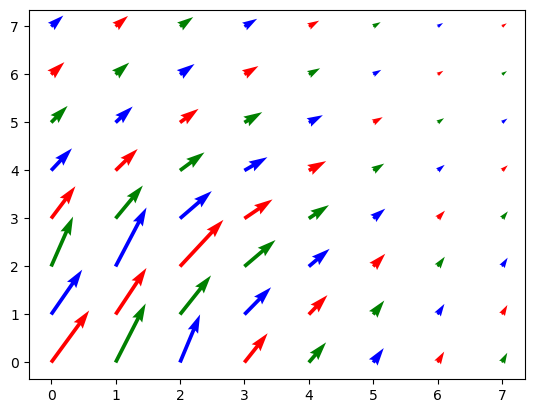

[0.00933235 0.0050913 ] [0.0093757  0.00529568] 2.9066765098506933 2.9490869832060134
[0.01078072 0.00436161] [0.01080333 0.00463236] 2.8921928253616938 2.956383910431443
[0.01127257 0.00538642] [0.01136677 0.00567539] 2.8872742995689045 2.946135829430662


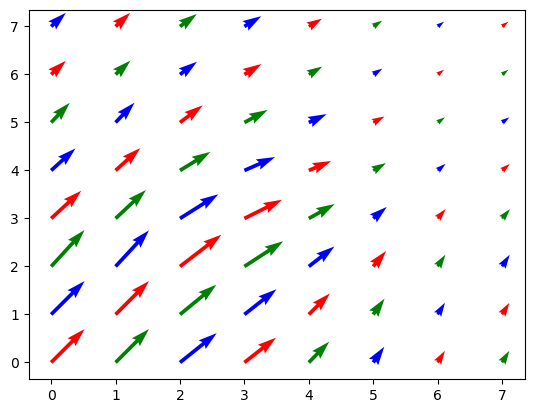

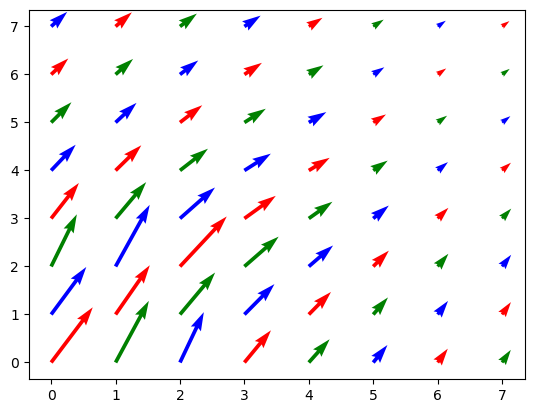

[0.01032102 0.0061667 ] [0.0103724  0.00639088] 2.8967897888238587 2.9383329852609164
[0.01177394 0.00548194] [0.01180153 0.00578198] 2.8822606459537443 2.945180643431441
[0.01226886 0.00653999] [0.01236618 0.00686492] 2.877311435391673 2.93460011395165


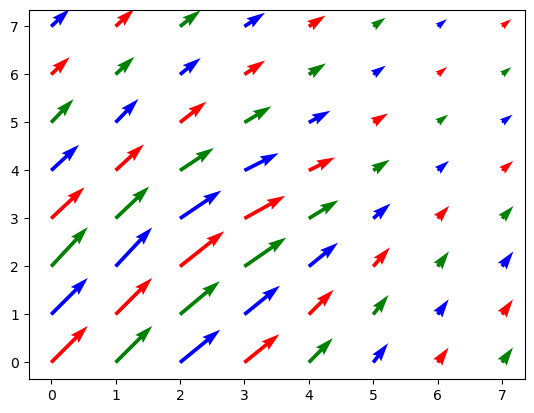

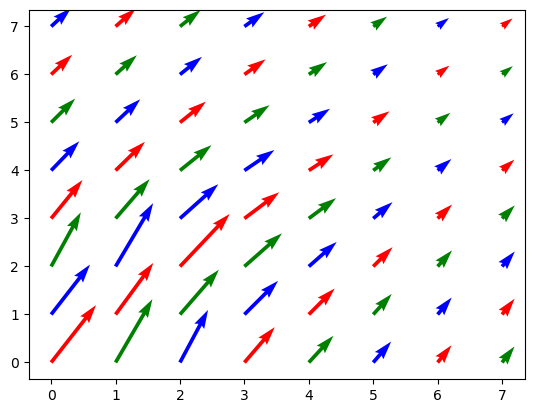

[0.01129964 0.00731216] [0.01136411 0.00755185] 2.8870035725172785 2.926878410829374
[0.01266731 0.00667395] [0.01270474 0.00699395] 2.873326867278651 2.933260457090608
[0.01315718 0.00769036] [0.01325612 0.00804152] 2.8684282266966252 2.9230963857233165


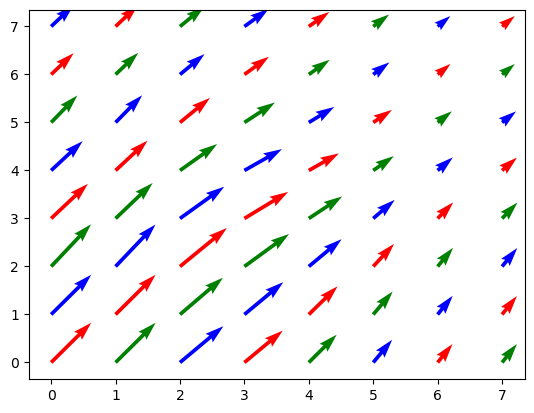

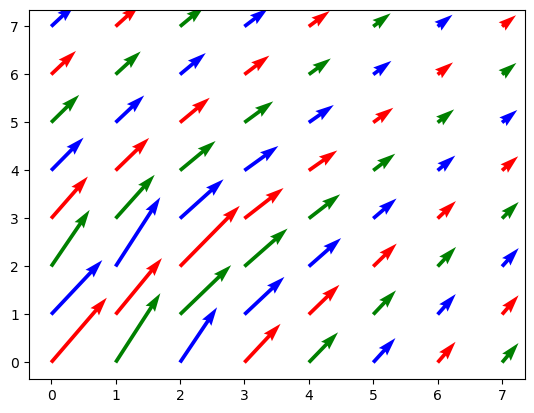

[0.0126886  0.00847562] [0.0128148  0.00876363] 2.8731140179053662 2.9152437605477353
[0.01417868 0.00790656] [0.01427771 0.00829182] 2.858213157885134 2.920934370199491
[0.01466934 0.00908363] [0.01483761 0.00950473] 2.8533066043669373 2.909163698493425


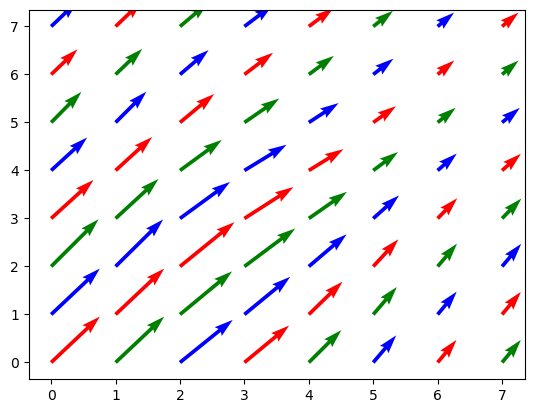

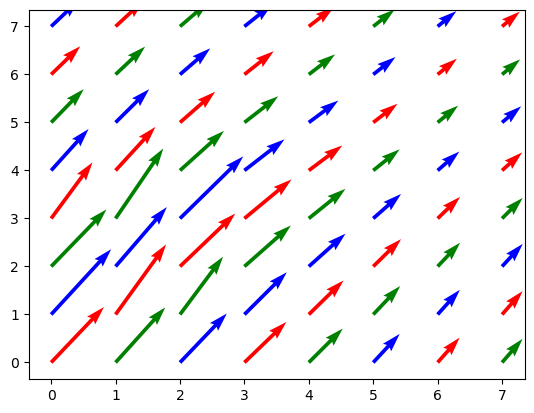

[0.01512306 0.00895453] [0.01542142 0.00964029] 2.848769354663923 2.91045473335624
[0.01724486 0.00925534] [0.0173419  0.00994324] 2.8275513709690068 2.907446591530688
[0.01745001 0.01164108] [0.01753851 0.01224419] 2.8254999362074975 2.883589155691641


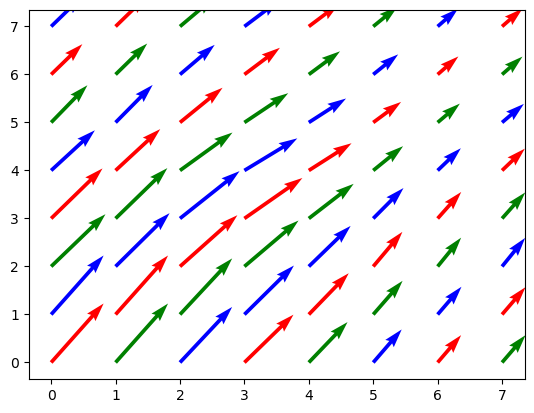

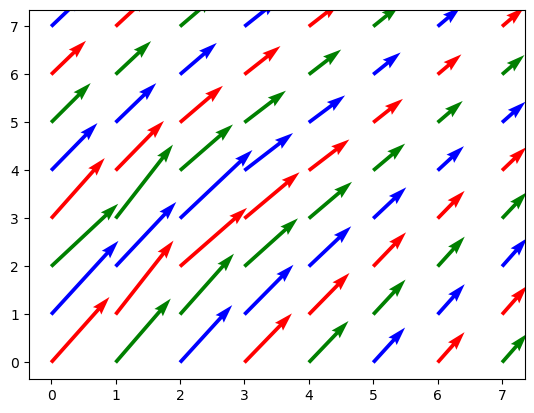

[0.01684415 0.0114091 ] [0.01728001 0.01212914] 2.831558544538847 2.8859089790478545
[0.0185618  0.01156082] [0.01875888 0.01226953] 2.8143819962579517 2.8843917505122447
[0.01893905 0.01354863] [0.01907848 0.01419479] 2.810609540778455 2.864513659845482


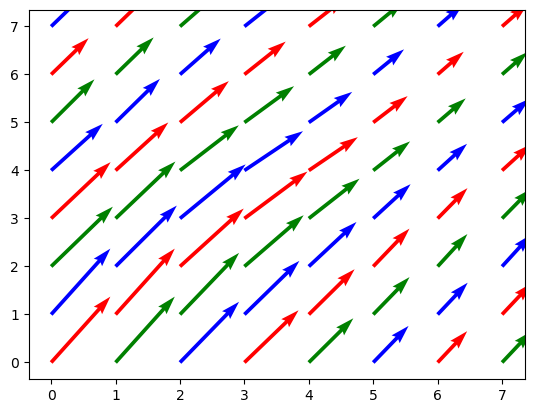

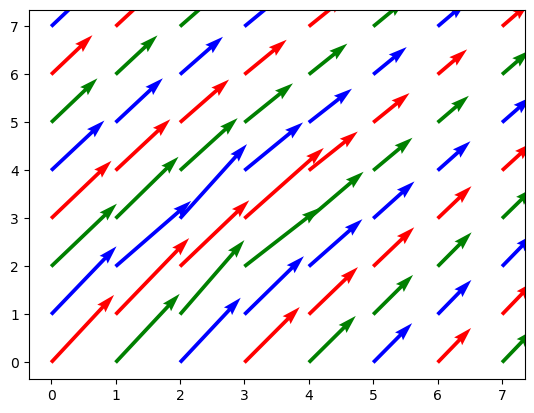

[0.0221836  0.01751393] [0.02143172 0.01749482] 2.7781640149207765 2.824860682732163
[0.02190705 0.01641026] [0.02146409 0.01675287] 2.780929535262409 2.835897449064272
[0.02167619 0.01735086] [0.02145427 0.01779548] 2.783238122011964 2.8264913565965233


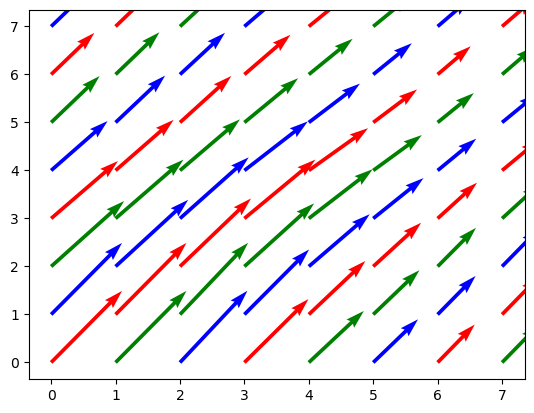

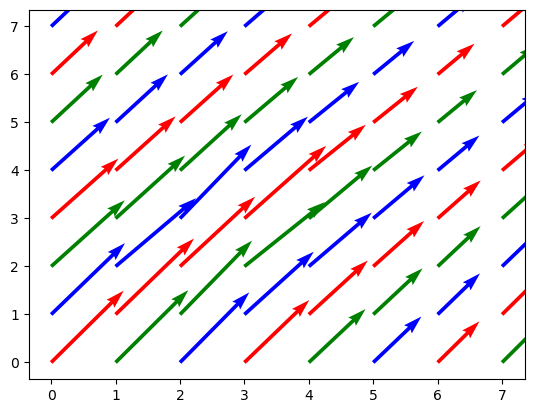

[0.02333477 0.01947618] [0.02282928 0.01948576] 2.766652325017052 2.8052382213451783
[0.02272059 0.01882952] [0.02249995 0.01912093] 2.7727940931874215 2.8117048383876253
[0.0223817  0.01927158] [0.0223155  0.01964397] 2.7761829955994624 2.8072842385377883


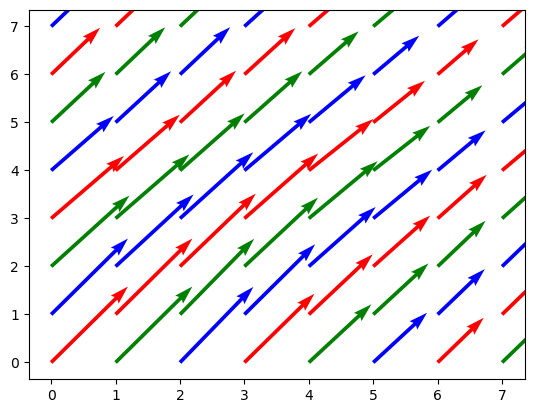

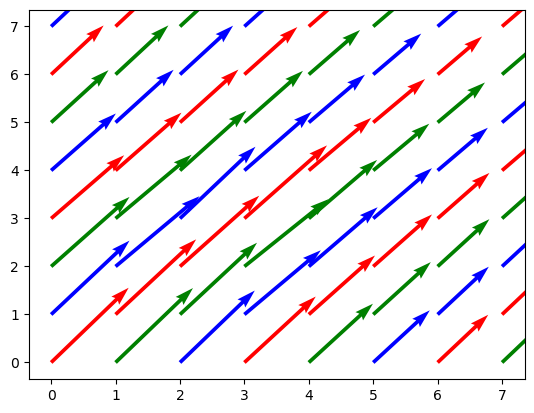

[0.02377068 0.02067634] [0.02366355 0.02073666] 2.7622932277541827 2.793236576303127
[0.0230176 0.0203882] [0.02309297 0.02067385] 2.769823956455178 2.7961179691027542
[0.02274972 0.02040248] [0.02287202 0.02075461] 2.772502821799562 2.795975170527908


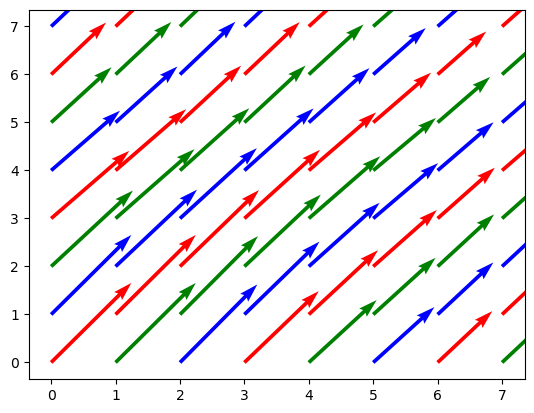

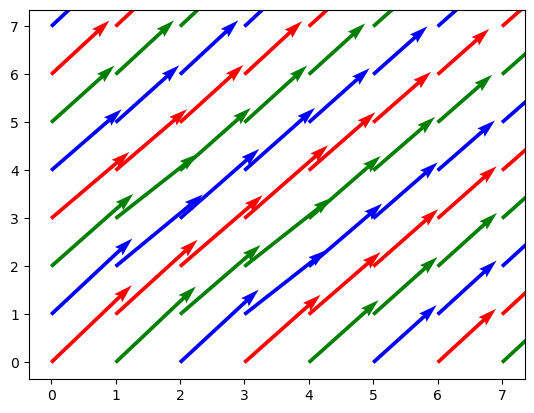

[0.02419225 0.02158815] [0.02445582 0.02172093] 2.7580774538273953 2.784118483181448
[0.02330338 0.02162737] [0.02365526 0.02193889] 2.7669662368660575 2.7837263156787144
[0.02310641 0.02124004] [0.02340097 0.02160341] 2.7689359325553067 2.7875996178448172


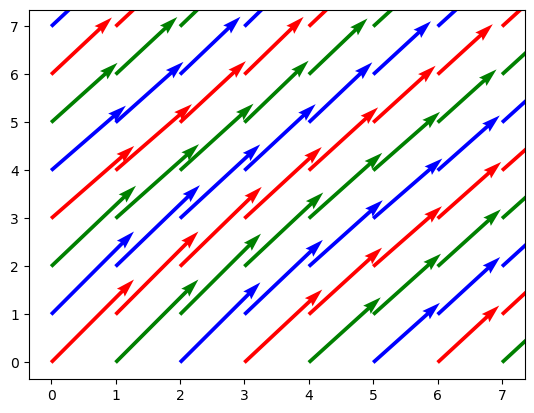

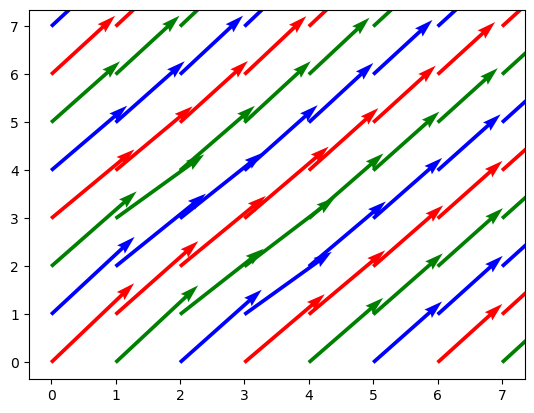

[0.02441652 0.02223126] [0.02511862 0.02247516] 2.755834801705703 2.777687426487989
[0.02330611 0.02262971] [0.02398788 0.02298647] 2.7669389419165236 2.7737029229489125
[0.0231887  0.02171972] [0.0236862  0.02211079] 2.7681130208659543 2.782802810300573


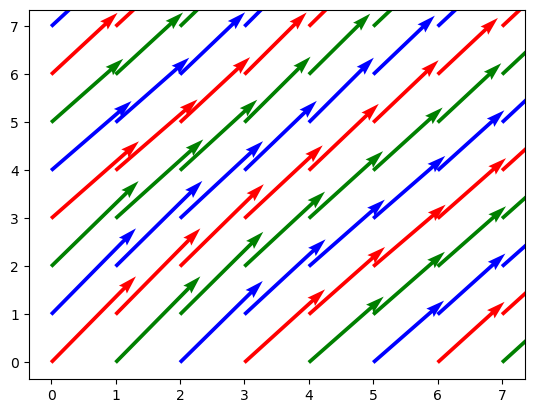

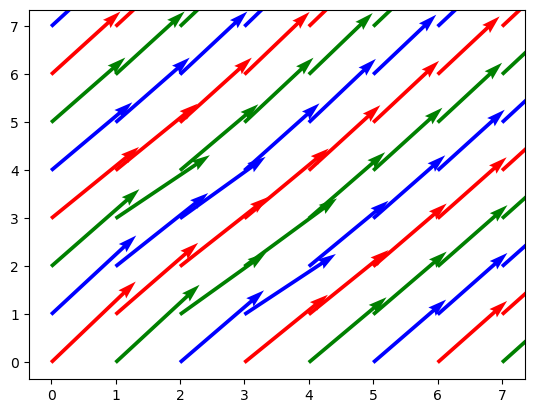

[0.02451167 0.0225596 ] [0.02561451 0.02292877] 2.7548832921286253 2.7744039548909534
[0.02323321 0.02333698] [0.0242133  0.02376334] 2.7676679281586067 2.7666301655171655
[0.02318038 0.02199628] [0.02385682 0.02243137] 2.7681961878606147 2.780037197098873


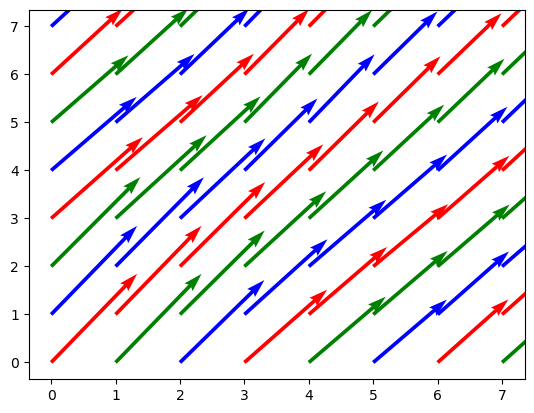

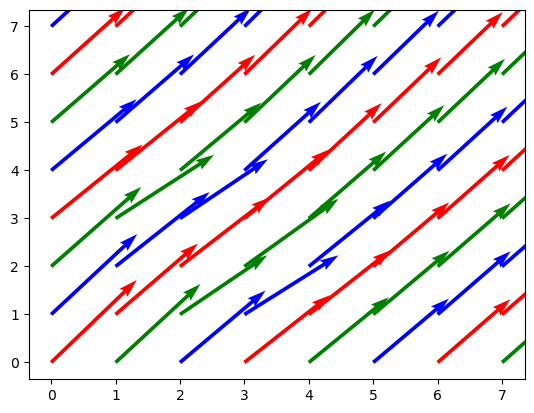

[0.02466216 0.02277635] [0.02603045 0.0232458 ] 2.7533783726520733 2.772236481730245
[0.02332978 0.0238296 ] [0.0245016  0.02433112] 2.766702214449512 2.7617040131031145
[0.0233335  0.02226262] [0.02411813 0.02275146] 2.7666650397033585 2.777373830925747


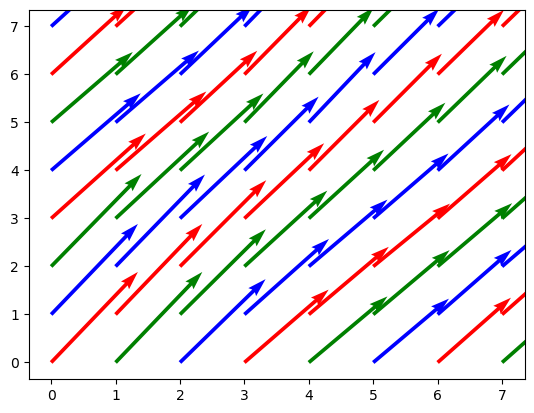

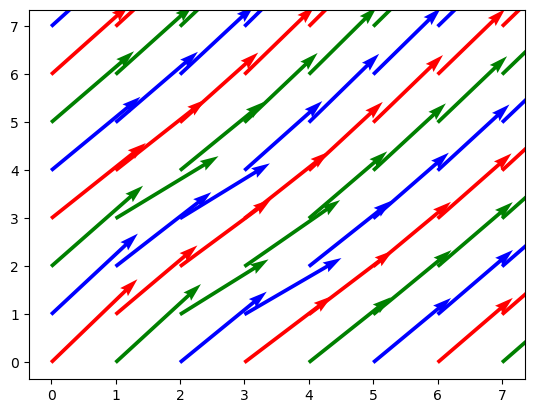

[0.02459359 0.022935  ] [0.02630316 0.02352133] 2.754064056259898 2.77064996850863
[0.02304189 0.02427066] [0.0244702  0.02482346] 2.769581135151241 2.7572934369480184
[0.02311    0.02224969] [0.02404755 0.02277146] 2.768900033007821 2.7775031347189967


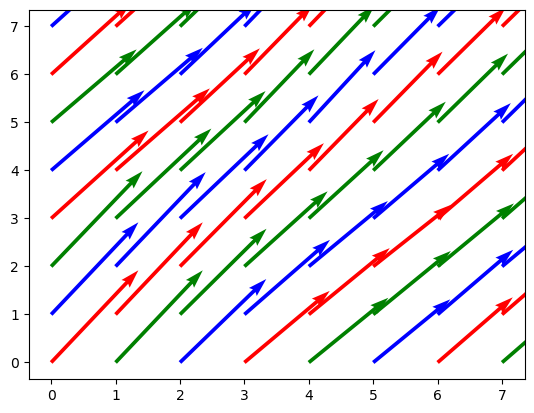

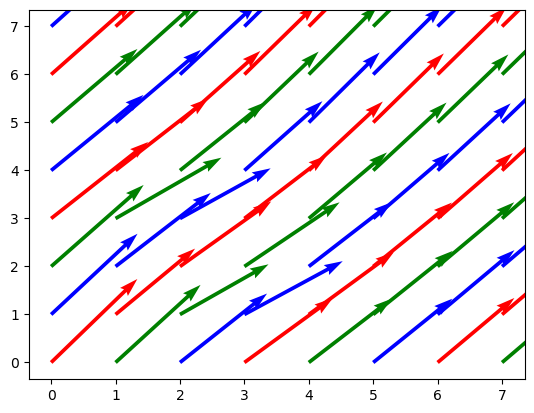

[0.02414253 0.02268219] [0.02613511 0.02338718] 2.7585747266190794 2.7731781234462
[0.02244348 0.02435769] [0.02407832 0.02496225] 2.7755652050588715 2.756423120337146
[0.02255214 0.02198029] [0.02360924 0.02251694] 2.774478612004831 2.780197133985405


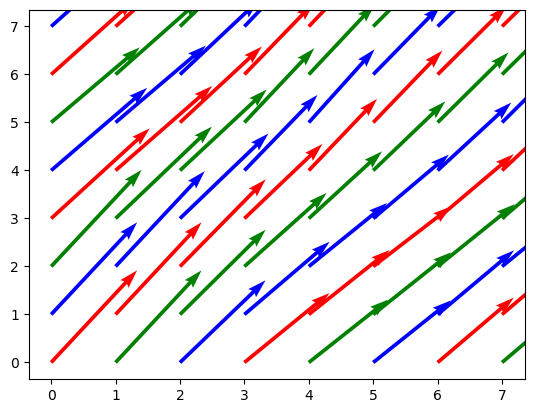

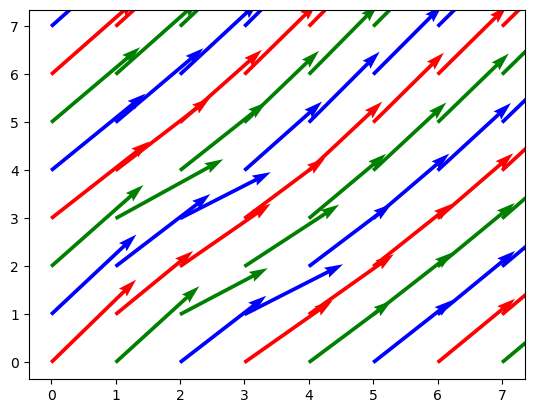

[0.02373005 0.02236384] [0.02590901 0.0231349 ] 2.762699501028242 2.776361566668154
[0.02192835 0.02426513] [0.02369958 0.02490968] 2.7807165482798535 2.757348748939656
[0.02206843 0.02164756] [0.0232042  0.02220181] 2.7793157259168484 2.783524359205275


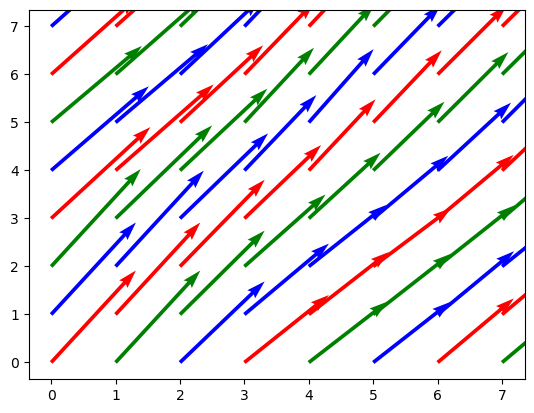

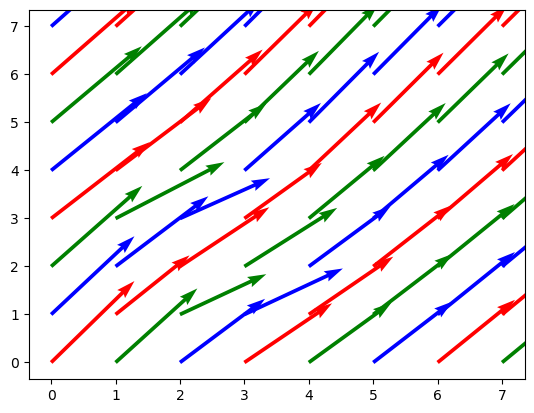

[0.02283287 0.02177504] [0.02521805 0.02263059] 2.7716712839147943 2.782249585153119
[0.02081025 0.02393188] [0.02273526 0.02458375] 2.791897487057199 2.76068123584461
[0.02098047 0.02090852] [0.02221374 0.02143648] 2.7901952812750905 2.7909148114789124


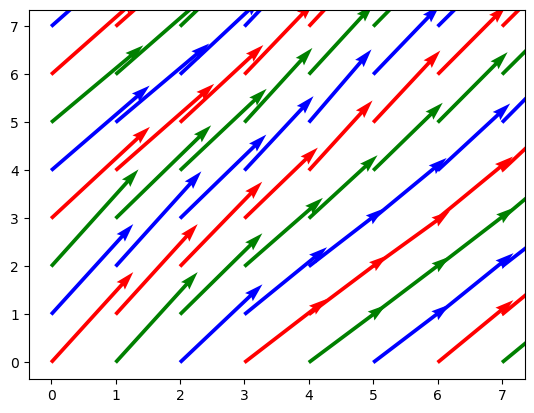

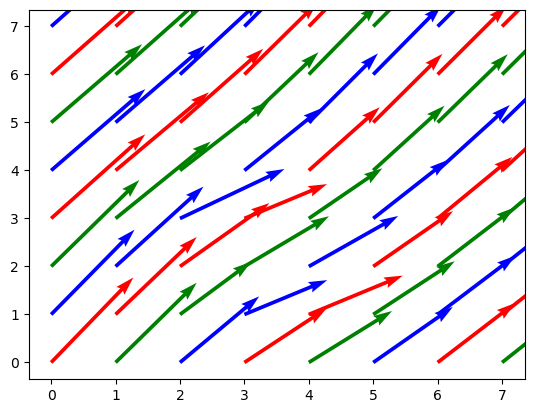

[0.0272553  0.01690166] [0.02960467 0.01960522] 2.7274470401090825 2.8309833787000946
[0.02630093 0.02188192] [0.02757704 0.02422972] 2.7369906869776743 2.7811808372447757
[0.02574861 0.02107587] [0.02631844 0.02275485] 2.7425139140137826 2.789241255872404


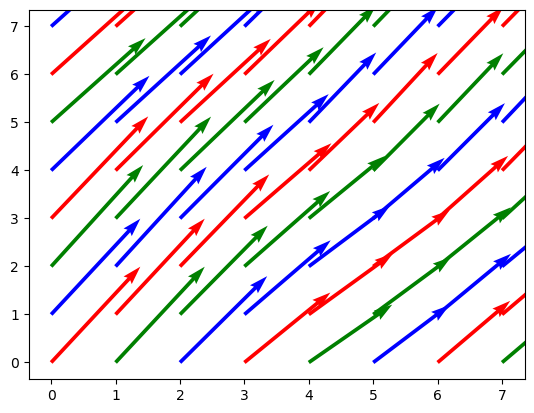

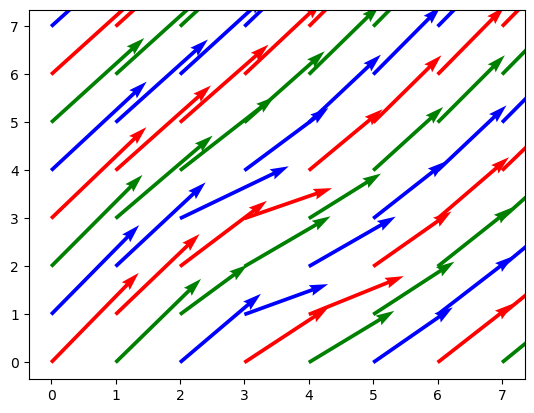

[0.02880069 0.0165189 ] [0.03109754 0.01977422] 2.7119930641556262 2.834810992347886
[0.02736277 0.02206224] [0.02844695 0.02474781] 2.726372288070623 2.779377562476526
[0.02640764 0.02133366] [0.02687602 0.02316974] 2.7359235678266085 2.786663445705096


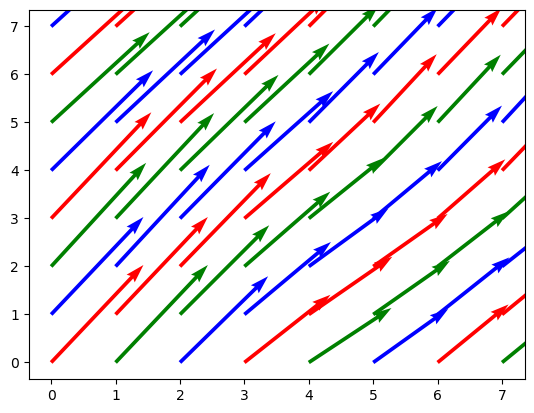

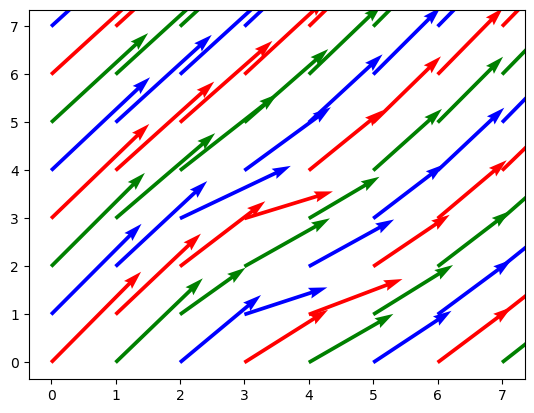

[0.02921836 0.016136  ] [0.03159968 0.01967853] 2.707816351971747 2.8386399864573657
[0.02763493 0.02217215] [0.02869964 0.02505507] 2.72365072341484 2.778278536900771
[0.02652051 0.02147866] [0.02697509 0.0233899 ] 2.7347948818813963 2.7852134201044114


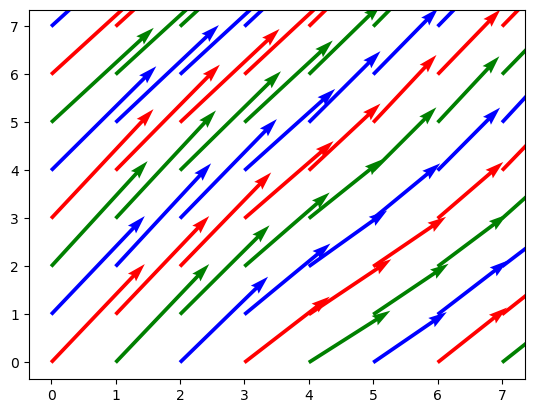

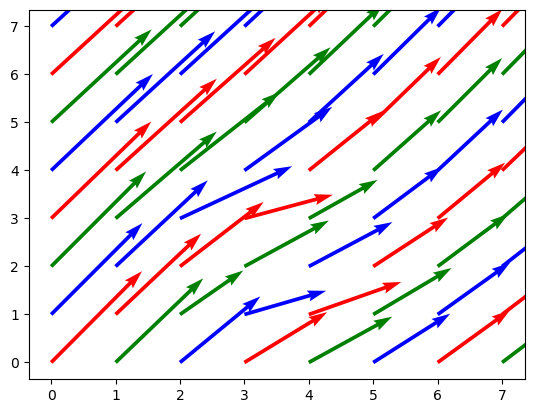

[0.02940803 0.01568972] [0.03187943 0.01945504] 2.705919740676989 2.843102840712241
[0.02772595 0.02212522] [0.02877644 0.02516859] 2.7227405415120356 2.7787478307258713
[0.02649382 0.02142378] [0.02692886 0.02339846] 2.7350617925704714 2.7857621945613484


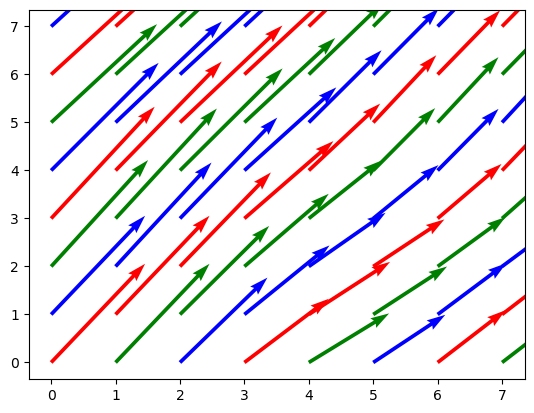

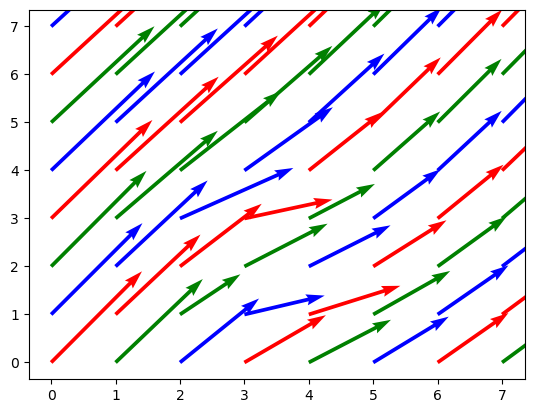

[0.02950279 0.01500401] [0.0321202  0.01898172] 2.7049721414931986 2.8499598705378446
[0.02766876 0.02187477] [0.02872915 0.02509667] 2.7233123885048958 2.7812522540146096
[0.0262865  0.02108588] [0.02671199 0.02314162] 2.7371349908318505 2.789141248763109


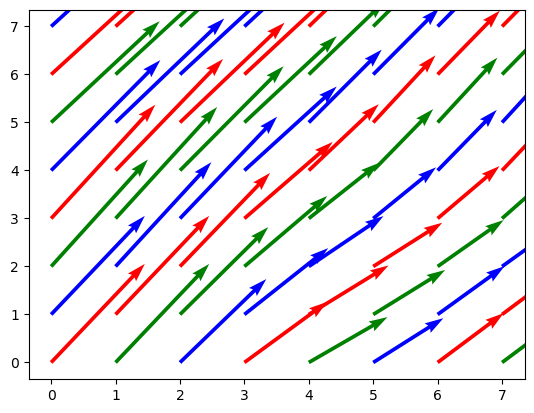

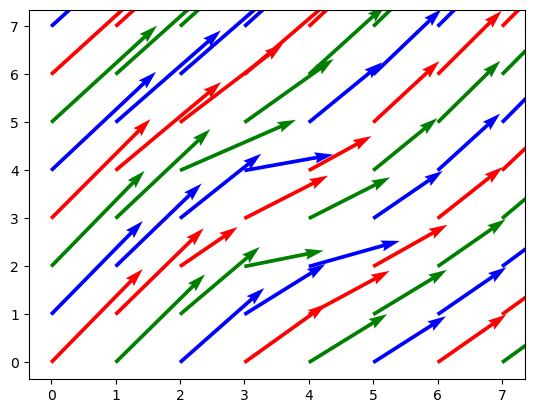

[0.02871489 0.02613303] [0.02956095 0.02738633] 2.712851144261141 2.7386696741607683
[0.02395536 0.0270461 ] [0.02465131 0.0275807 ] 2.760446402969073 2.729538960961035
[0.02361227 0.02080473] [0.02398075 0.02179951] 2.763877330447822 2.7919526639072108


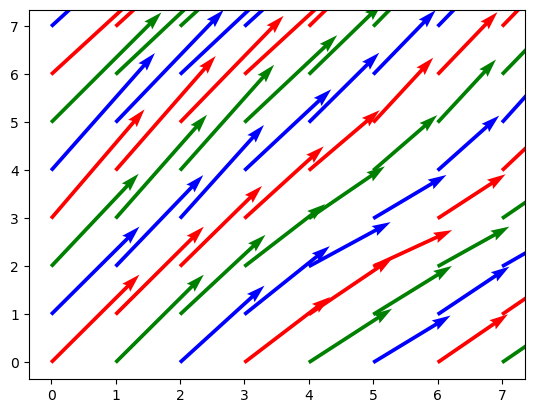

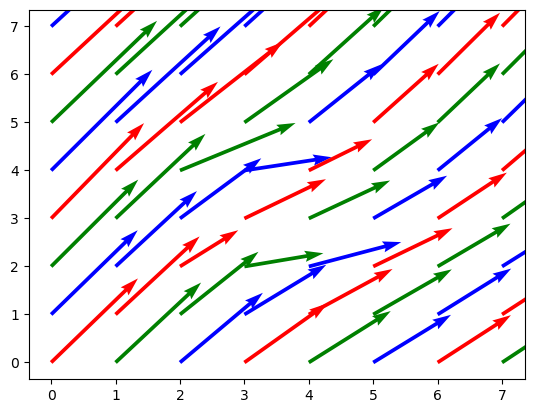

[0.02859836 0.02627797] [0.02968569 0.02757477] 2.71401642605705 2.7372202687751708
[0.02352936 0.02816502] [0.02424953 0.02855708] 2.7647063632105593 2.71834984519413
[0.02268112 0.02147973] [0.02303469 0.02216983] 2.773188801403338 2.785202705262178


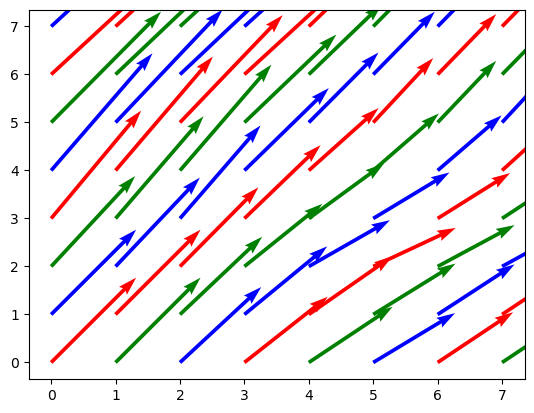

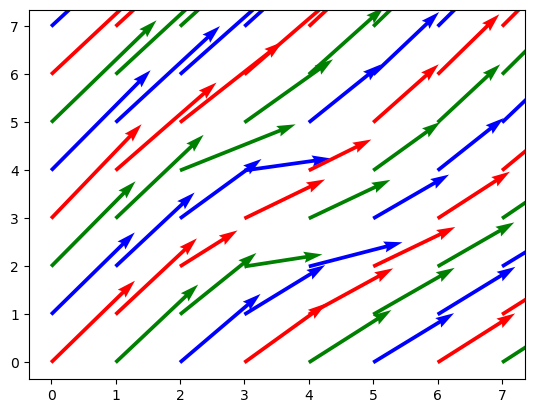

[0.02850332 0.02634433] [0.02964938 0.02760969] 2.7149668323154903 2.736556704642548
[0.02349999 0.02827622] [0.02418255 0.02866523] 2.765000103287332 2.71723784378668
[0.02260097 0.02152008] [0.02289849 0.02218871] 2.7739903120753087 2.7847991897926314


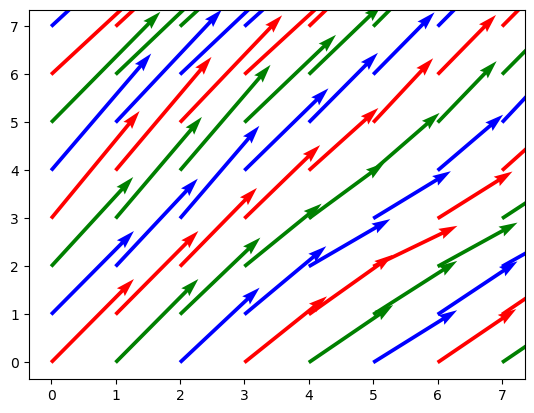

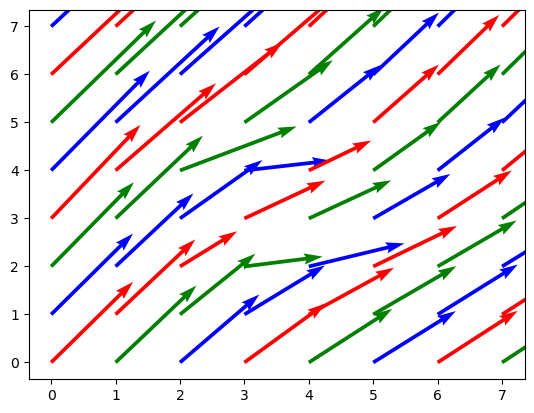

[0.02871724 0.02659421] [0.0299461 0.0278935] 2.7128275916194355 2.734057911384658
[0.02349221 0.02854764] [0.0241532 0.028927 ] 2.7650779372693237 2.714523554943628
[0.02251685 0.02142232] [0.02277362 0.02209736] 2.7748314645553176 2.7857768116435064


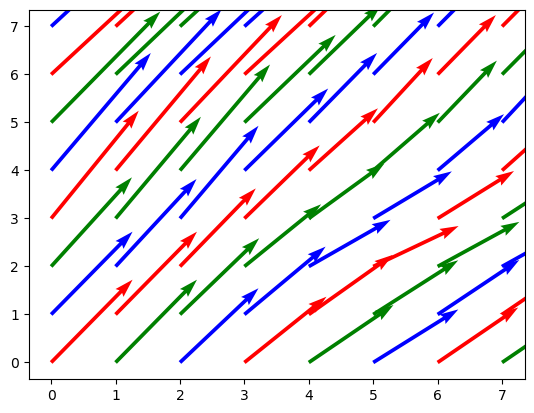

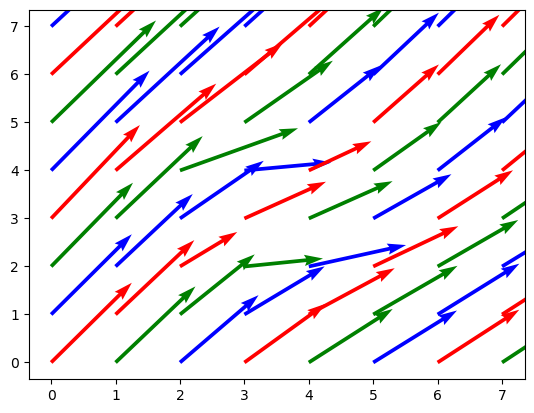

[0.02905713 0.0268405 ] [0.0303781  0.02822912] 2.709428666113528 2.731594989199211
[0.02364135 0.02891305] [0.02427886 0.0293109 ] 2.763586538742946 2.710869542947723
[0.0225698  0.02148034] [0.02278798 0.02216631] 2.7743020218641004 2.7851965621958414


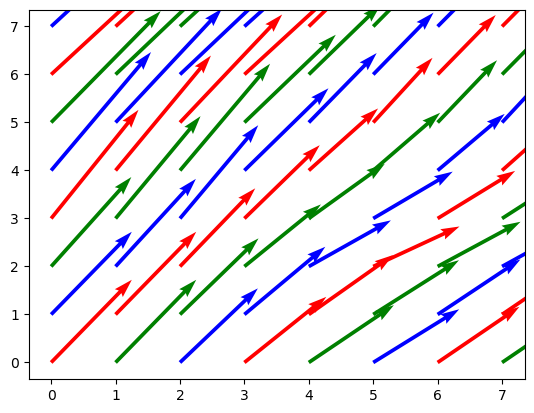

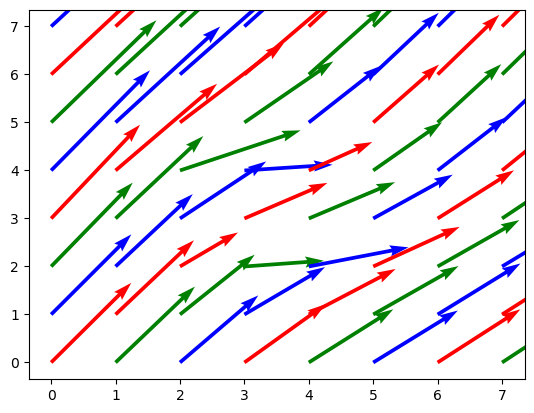

[0.02967692 0.02733194] [0.03113101 0.02885195] 2.70323075628557 2.7266806421291094
[0.0239866  0.02954038] [0.02459251 0.02996364] 2.7601339760670713 2.704596228738064
[0.02279813 0.02166529] [0.02296835 0.02237536] 2.7720187297926264 2.7833471397875367


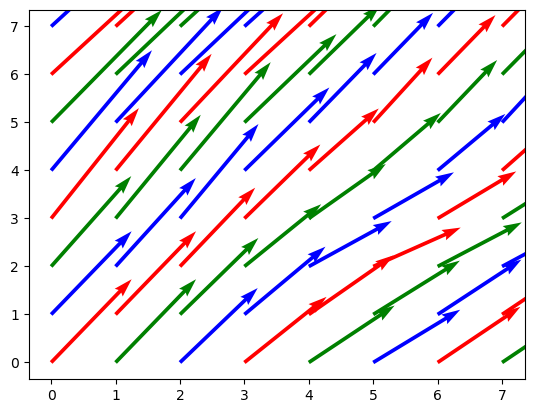

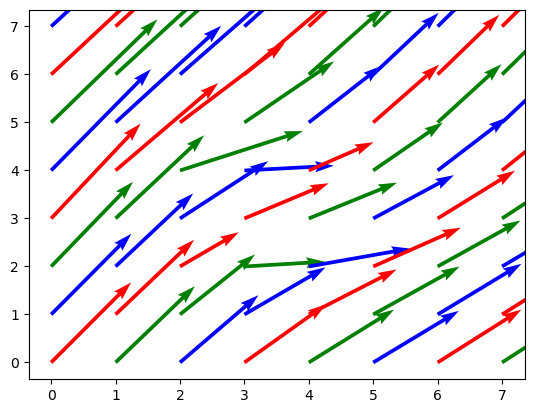

[0.03027678 0.02774578] [0.03180008 0.02937781] 2.6972322229251335 2.7225422212116914
[0.02445567 0.03011858] [0.02501993 0.03057782] 2.7554433239762686 2.698814206321959
[0.0231604  0.02203994] [0.02328676 0.02276159] 2.7683960277470874 2.7796006300926623


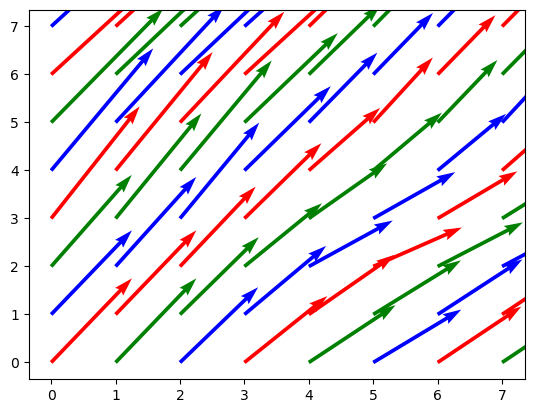

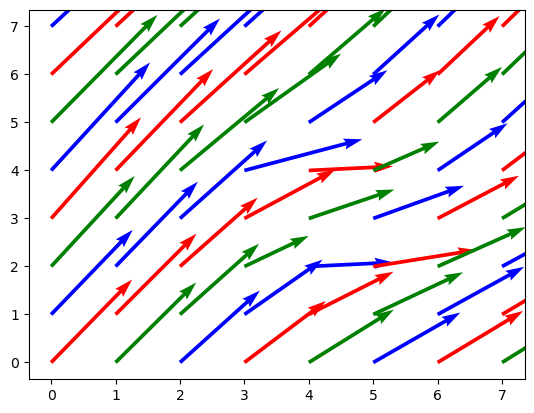

[0.03610747 0.02900799] [0.03458436 0.03157114] 2.638925276954338 2.7099200930119225
[0.03027969 0.03482504] [0.02930845 0.0350044 ] 2.697203141587704 2.6517496380838694
[0.02655044 0.02988457] [0.02601294 0.02922395] 2.7344955541753686 2.7011543048155766


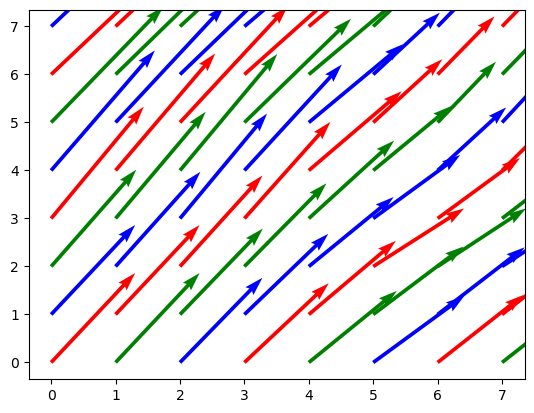

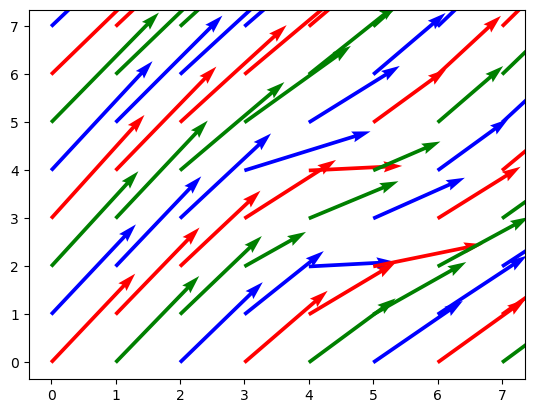

[0.03626198 0.03285579] [0.03449451 0.03451042] 2.637380160271656 2.6714421012558955
[0.03015931 0.03690092] [0.02909524 0.03615656] 2.6984069450584696 2.6309908224644594
[0.026974   0.03061205] [0.02640963 0.02961273] 2.730259967615157 2.693879546000269


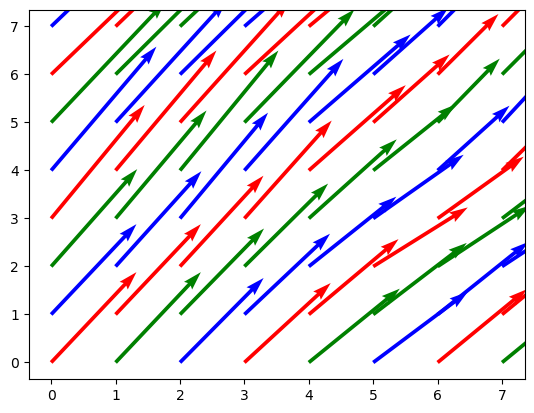

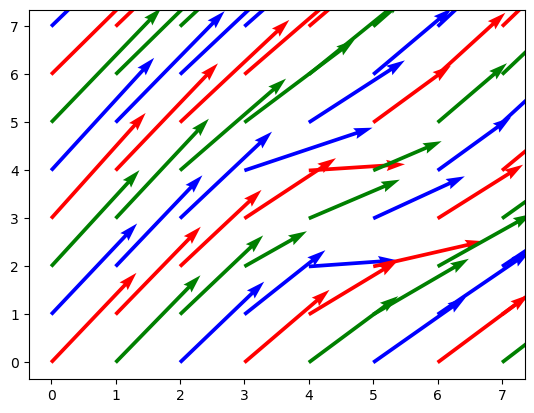

[0.03638485 0.03360742] [0.03469759 0.03506646] 2.6361514851959984 2.6639258018767515
[0.03033928 0.03775981] [0.02933643 0.03678001] 2.6966071905518185 2.6224019126066236
[0.02709672 0.03128773] [0.02659294 0.03009849] 2.7290328491863494 2.6871227173776617


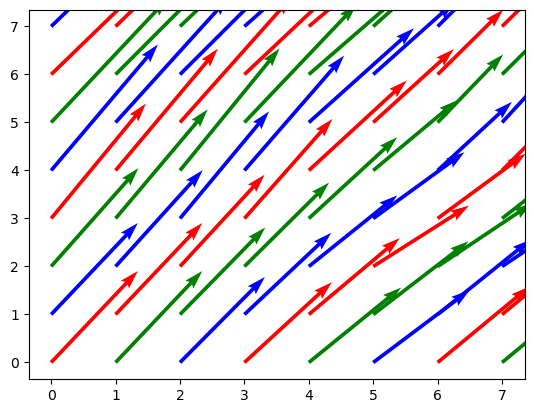

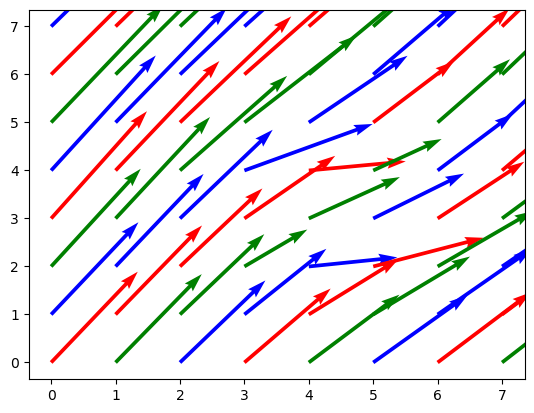

[0.03597996 0.03379748] [0.03443817 0.03505551] 2.640200409299437 2.6620252064805143
[0.030339   0.03775399] [0.02945012 0.03672072] 2.6966099920220223 2.6224601192103316
[0.02729629 0.03148491] [0.02685741 0.03028955] 2.727037116928517 2.6851508849554984


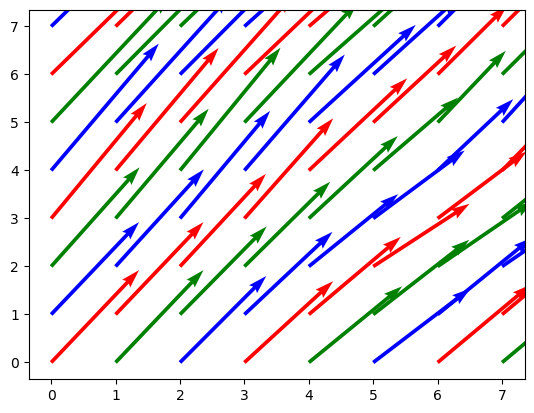

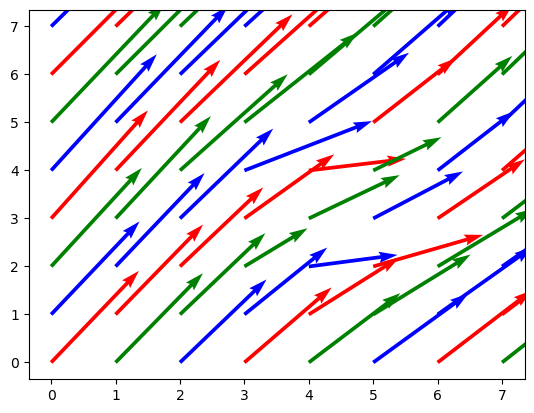

[0.03547171 0.0337913 ] [0.03410349 0.03488686] 2.6452829073335176 2.662086970699209
[0.0302111  0.03753202] [0.02945042 0.03649426] 2.6978890441444223 2.6246797759091223
[0.02738461 0.03146117] [0.02701776 0.03030453] 2.7261539402766664 2.6853883408325783


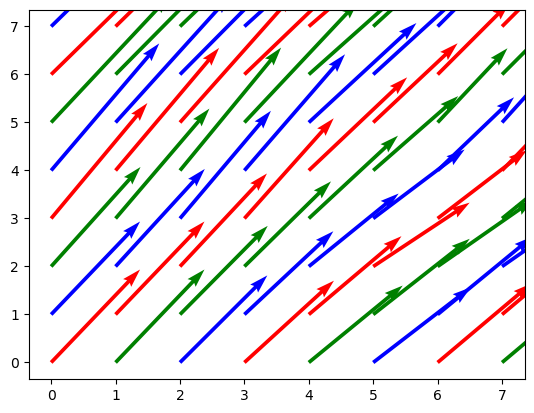

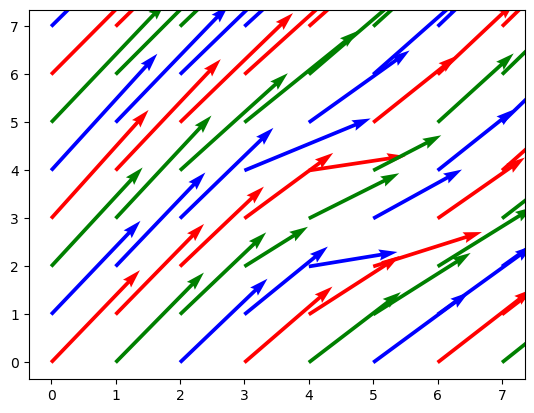

[0.03485888 0.03355615] [0.03367188 0.034516  ] 2.651411152922253 2.664438535339258
[0.03002344 0.03708734] [0.02939359 0.03609733] 2.6997655718270477 2.629126570069981
[0.0274234 0.031323 ] [0.02712733 0.03023578] 2.7257660475469025 2.6867699762132666


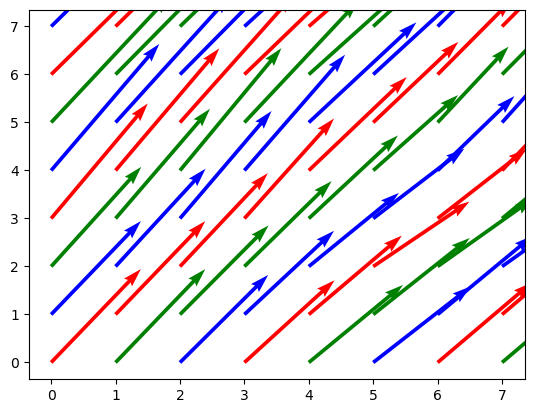

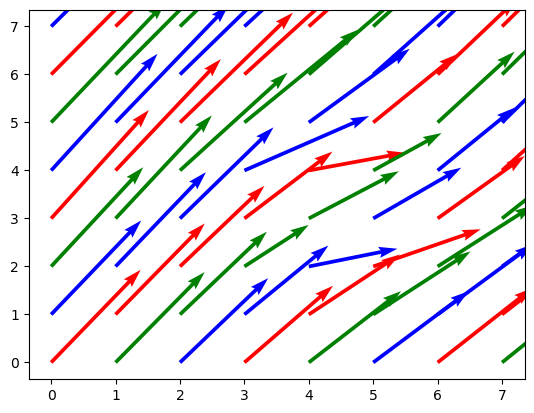

[0.03430331 0.03326599] [0.033268  0.0341237] 2.6569668906773 2.667340146755238
[0.02984592 0.03659218] [0.02932447 0.03566833] 2.701540753538704 2.6340781759952505
[0.02745489 0.03114835] [0.02721468 0.03013868] 2.7254511312294385 2.688516453478118


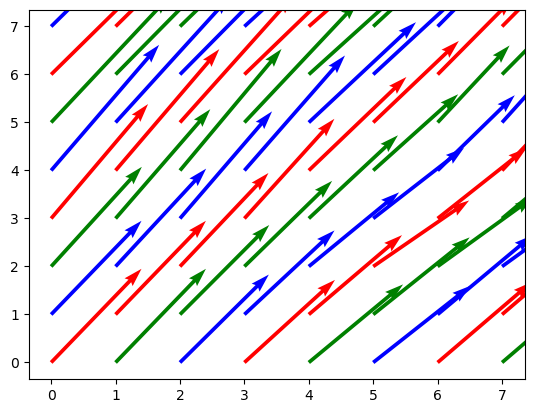

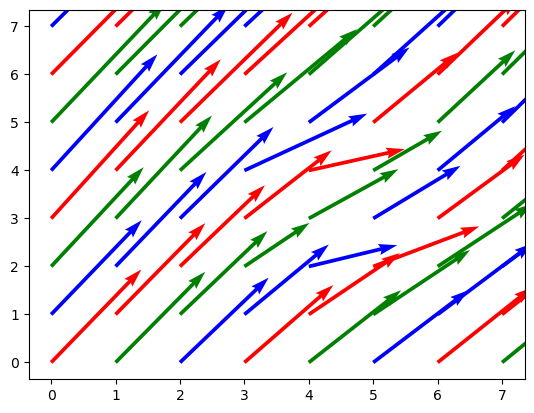

[0.03367705 0.03289336] [0.03279125 0.03364555] 2.663229456738483 2.671066366295215
[0.02962533 0.03599673] [0.02920915 0.03514953] 2.703746723881154 2.64003266387025
[0.02745321 0.03091919] [0.02726653 0.0299949 ] 2.725467926180846 2.690808080801019


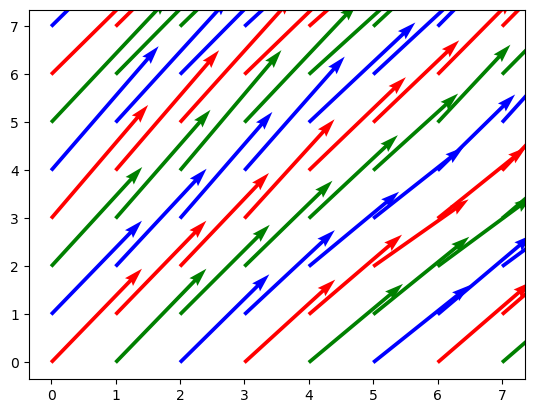

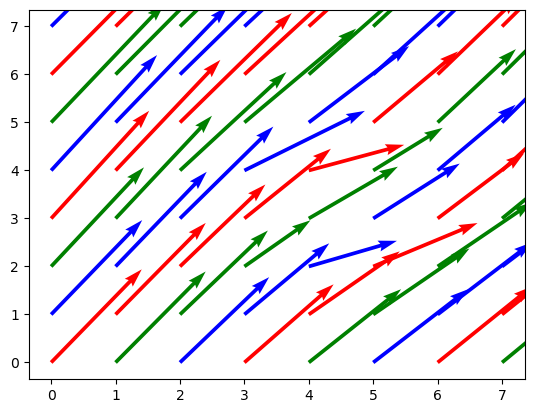

[0.0329728  0.03243107] [0.03223709 0.03307443] 2.670271963500112 2.675689303403675
[0.02936861 0.03527992] [0.02905555 0.03452306] 2.7063139365537716 2.6472008422961197
[0.02743503 0.03063828] [0.02729927 0.02981005] 2.7256497053881716 2.693617181825533


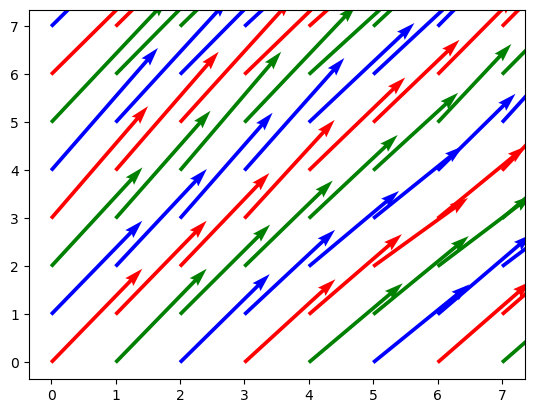

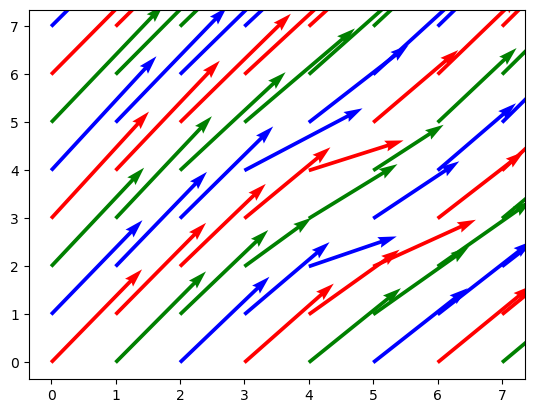

[0.03233772 0.03199199] [0.03172681 0.03254416] 2.6766227951916957 2.6800800952979875
[0.0291202  0.03459145] [0.02889132 0.03391741] 2.708797966268911 2.654085531400919
[0.02740282 0.03034651] [0.02730798 0.02960815] 2.7259718471507655 2.6965348814900683


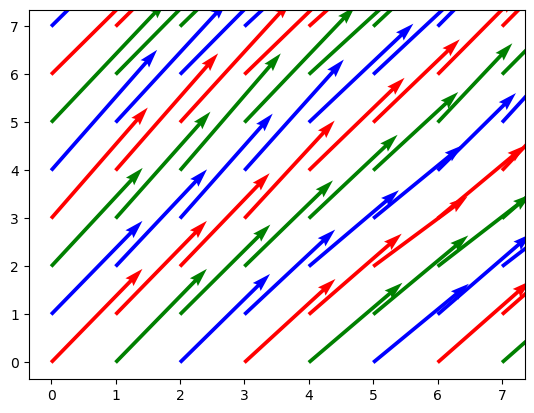

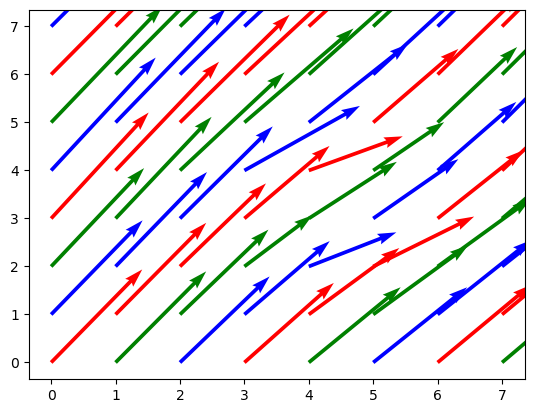

[0.03159482 0.03148652] [0.0311179  0.03193366] 2.6840518482798497 2.685134760218624
[0.028792  0.0338231] [0.02865333 0.0332269 ] 2.712080024315145 2.661768996580625
[0.02730167 0.02998164] [0.02725513 0.02933477] 2.726983262543973 2.7001836215711803


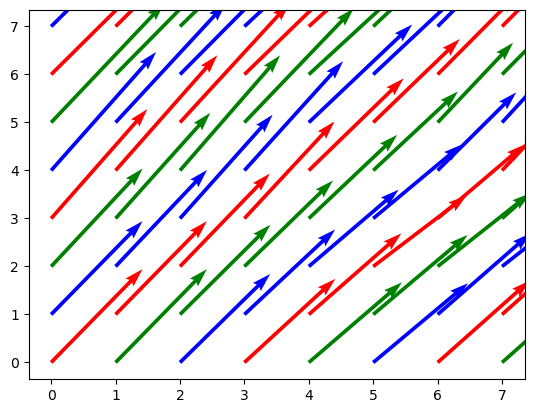

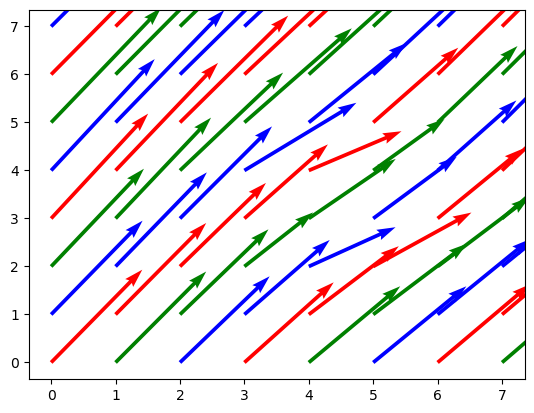

[0.03050639 0.03073807] [0.03021267 0.03104033] 2.6949360858487266 2.692619279808554
[0.02829423 0.03272952] [0.02827606 0.03223096] 2.7170576678848435 2.6727048374238316
[0.02711148 0.02945079] [0.02713459 0.02892178] 2.728885224240254 2.705492112902685


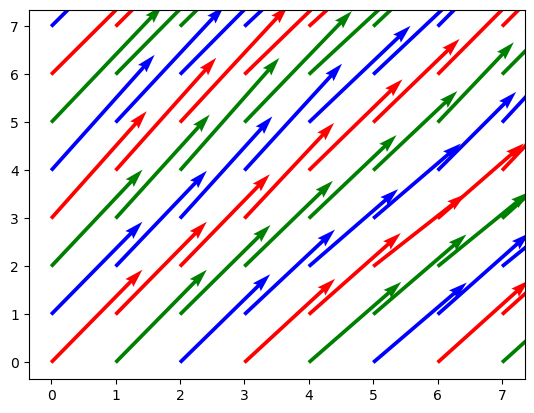

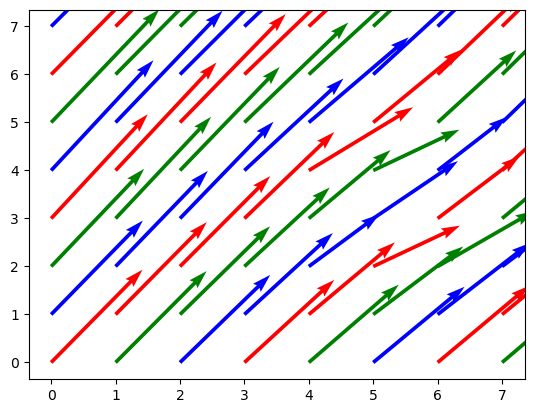

[0.03135726 0.03097827] [0.03065509 0.03076046] 2.686427395033631 2.690217271903082
[0.03024188 0.03294894] [0.0297538  0.03222228] 2.697581202592941 2.6705106364038658
[0.02873183 0.03152378] [0.0284575  0.03068661] 2.7126816601887307 2.6847621908971755


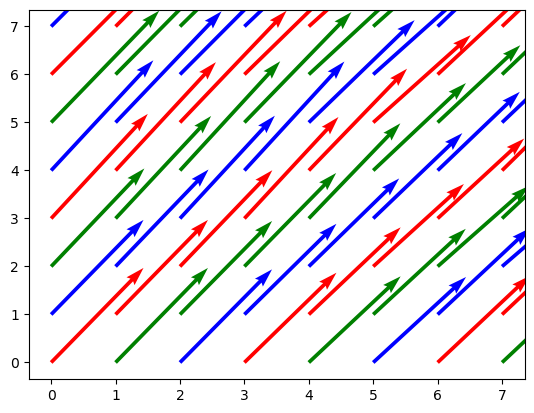

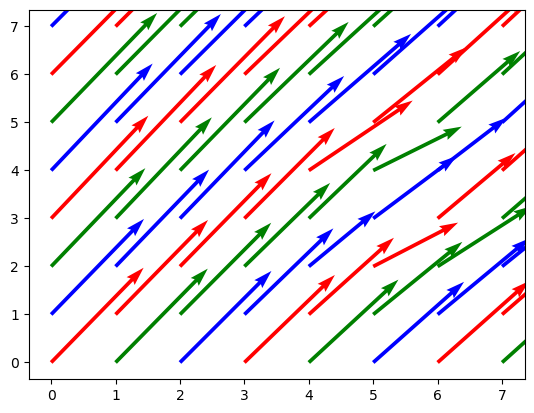

[0.03070907 0.03200728] [0.0299668  0.03125591] 2.6929093485154487 2.6799271828422855
[0.02961366 0.03268376] [0.0291248  0.03165978] 2.7038634328423248 2.673162431543198
[0.0285795  0.03086153] [0.02832335 0.03002592] 2.71420504208505 2.6913846641127694


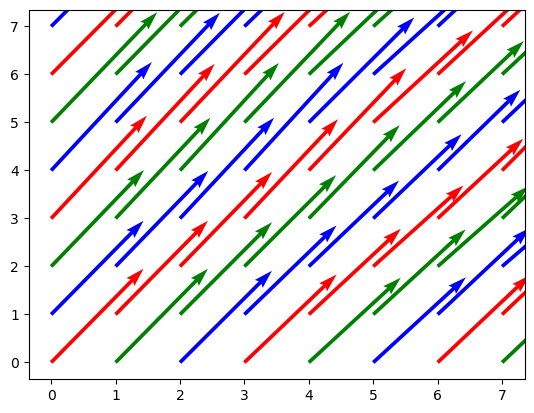

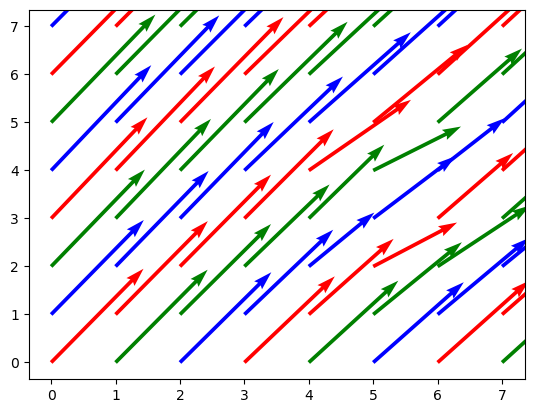

[0.03026113 0.03162942] [0.02961179 0.03084244] 2.6973887285621245 2.6837058008880366
[0.02914603 0.03226403] [0.02874922 0.03123839] 2.7085396512520568 2.6773597306309354
[0.02814429 0.03035984] [0.02796734 0.02955581] 2.7185570959378977 2.696401557130493


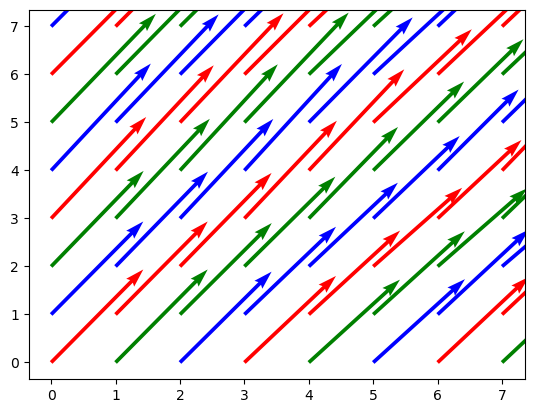

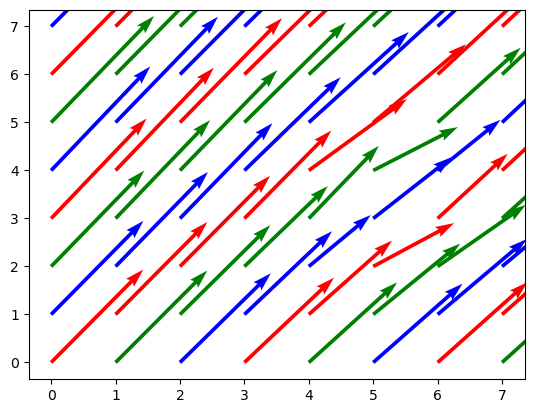

[0.02912007 0.03051085] [0.02861908 0.0296941 ] 2.7087992948401043 2.694891464144062
[0.02836253 0.03089228] [0.02808203 0.02998673] 2.716374669066039 2.691077171620491
[0.02761083 0.0293196 ] [0.02753097 0.02866848] 2.723891716174278 2.7068040413739873


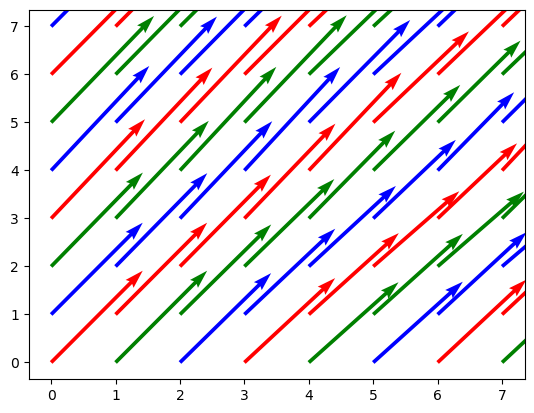

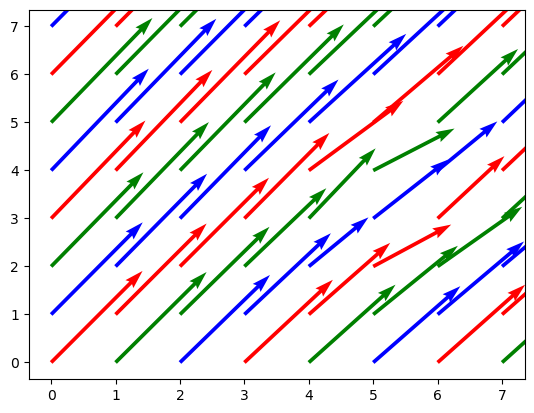

[0.0283226  0.02960122] [0.02793878 0.02885649] 2.7167740162445027 2.703987837343287
[0.02766657 0.02994599] [0.02747351 0.02913251] 2.7233343026966637 2.7005401446459616
[0.0270368  0.02845766] [0.02702015 0.02790071] 2.729632038441248 2.715423397126559


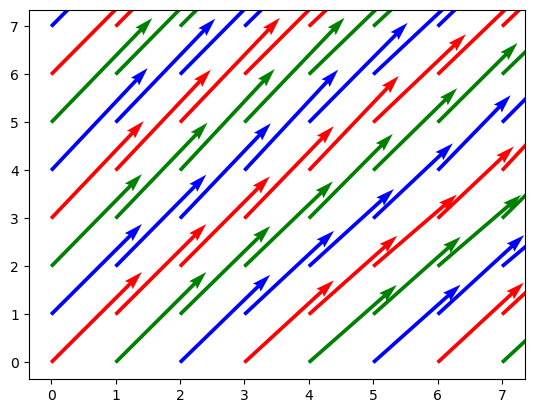

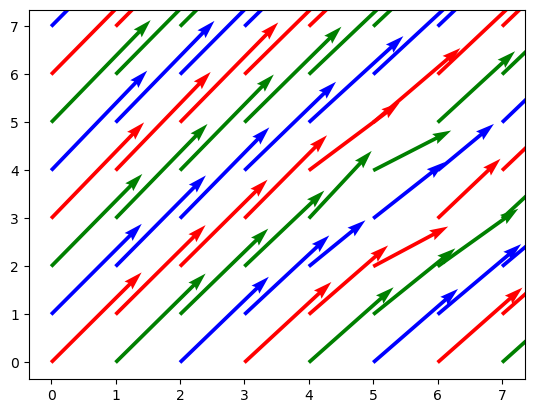

[0.02742541 0.02857893] [0.02713495 0.0278808 ] 2.7257459028685074 2.714210667072932
[0.02693758 0.02887882] [0.0268114  0.02815306] 2.730624220258323 2.711211752813961
[0.02642233 0.02755896] [0.02645809 0.02708778] 2.735776747941665 2.724410375884388


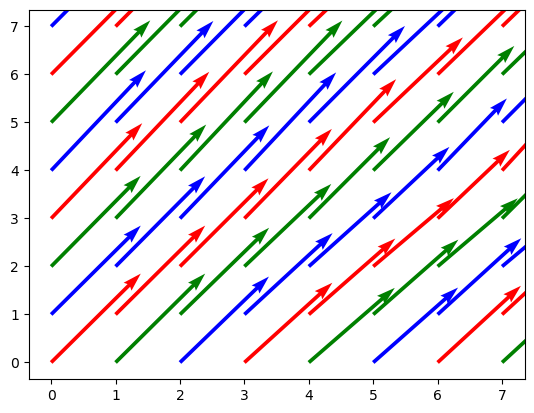

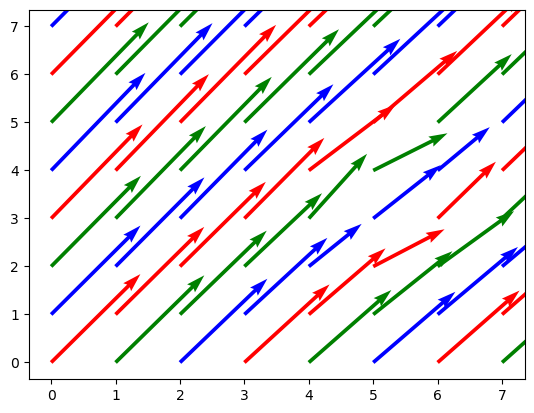

[0.02642128 0.02751345] [0.02621517 0.02684273] 2.73578717332395 2.7248655217132525
[0.02608625 0.02772912] [0.02601968 0.02707044] 2.739137466827088 2.7227087755890236
[0.02569161 0.0265373 ] [0.02577516 0.02614133] 2.743083893143535 2.734627032707583


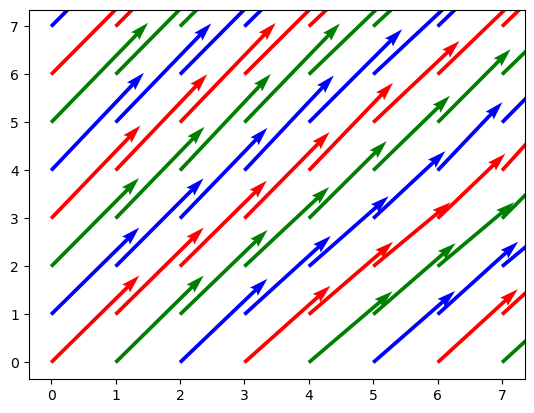

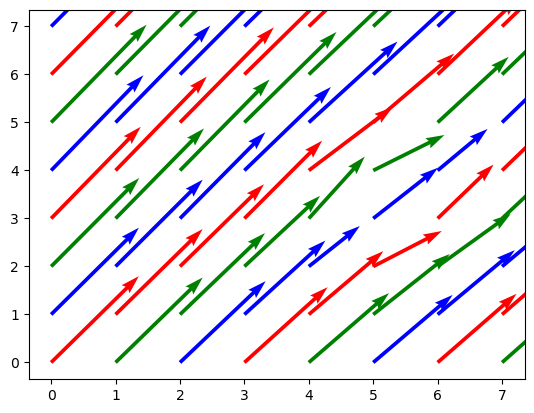

[0.02567768 0.02661614] [0.02553265 0.02602288] 2.7432232058220065 2.7338385864006485
[0.02537476 0.02688837] [0.0253499  0.02629221] 2.74625242392959 2.7311162854425266
[0.02501364 0.02574695] [0.0251222  0.02539359] 2.7498636163656 2.742530481428364


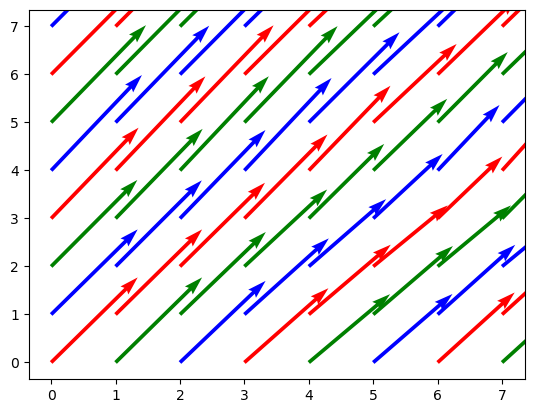

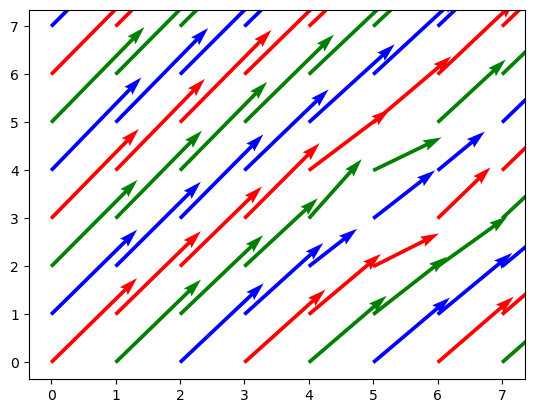

[0.02487333 0.0257417 ] [0.02477229 0.0251849 ] 2.751266712523785 2.742583028310086
[0.02464781 0.02601541] [0.02464579 0.0254587 ] 2.753521878295348 2.7398458688607485
[0.0243272  0.02494458] [0.02444993 0.02462177] 2.7567280108651406 2.750554185274045


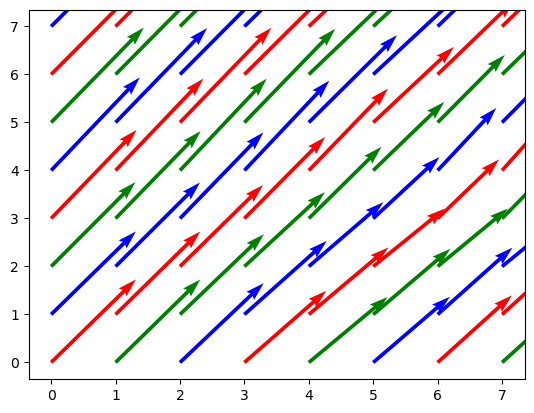

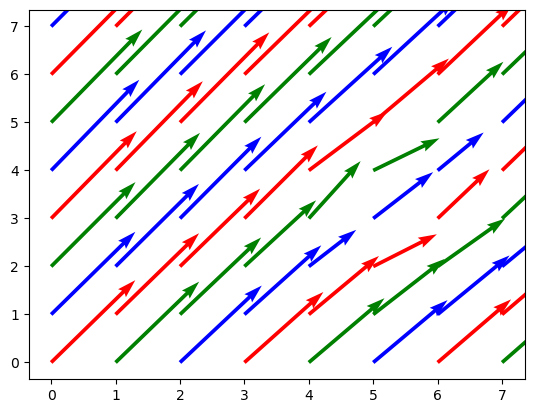

[0.02426782 0.02502576] [0.02419209 0.02452926] 2.7573217967607633 2.7497423569903683
[0.02404027 0.02535603] [0.02405236 0.02484141] 2.7595973353148184 2.7464396917712666
[0.02372126 0.0243194 ] [0.02384578 0.02401529] 2.7627874108153554 2.756805997937542


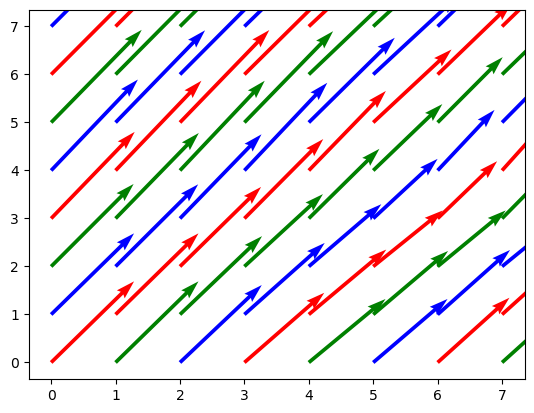

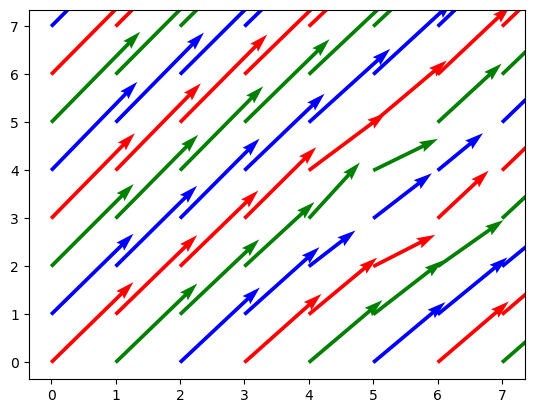

[0.02375296 0.02443734] [0.02368312 0.02398328] 2.762470374860412 2.7556265986312627
[0.0235236  0.02481244] [0.02353384 0.02432636] 2.7647639940490887 2.7518756095217265
[0.02319542 0.02381217] [0.0233101  0.02351519] 2.7680457956684412 2.761878348806405


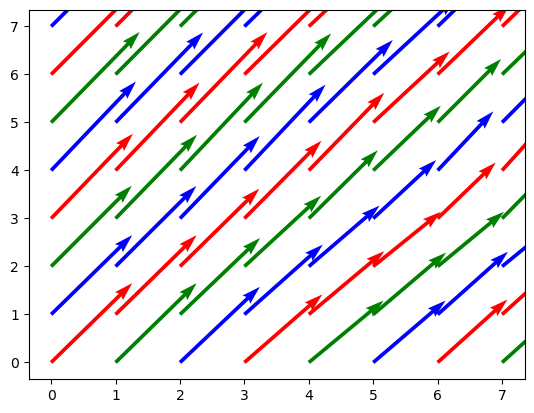

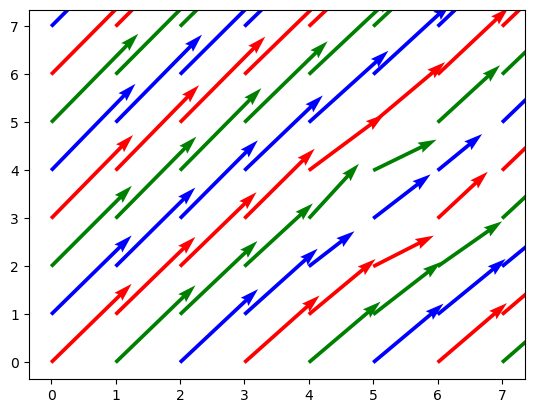

[0.02325611 0.02392314] [0.02318302 0.02348915] 2.7674389186418584 2.7607685587937327
[0.02302492 0.02431042] [0.02302678 0.02383731] 2.7697508147264274 2.7568957788897053
[0.02269076 0.02333031] [0.02279268 0.02303361] 2.7730923632201536 2.766696877317719


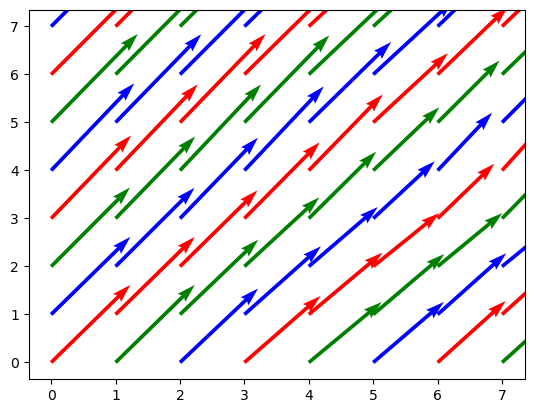

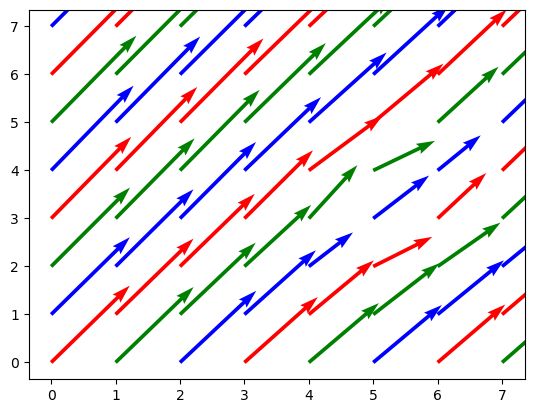

[0.02271571 0.02339471] [0.02264046 0.02296691] 2.7728428821290896 2.7660528580453327
[0.02249325 0.0237723 ] [0.02248856 0.02330492] 2.7750675407946703 2.76227697190064
[0.02216112 0.02280833] [0.02225403 0.02251125] 2.778388780062418 2.7719167186114437


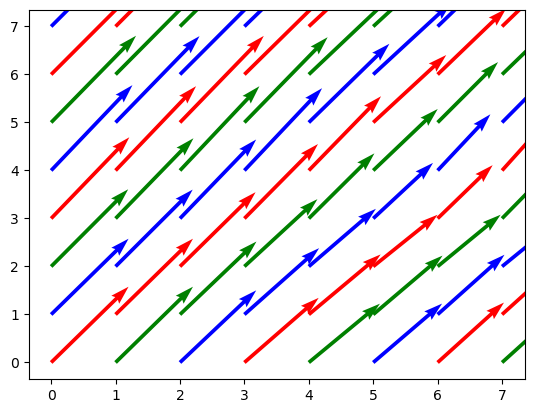

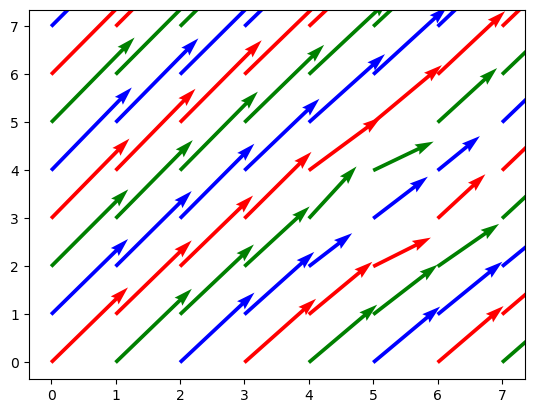

[0.02223976 0.02289882] [0.02216463 0.02249242] 2.7776023553985225 2.771011775823924
[0.02200374 0.0232982 ] [0.02199515 0.02284347] 2.779962586786086 2.7670180286474153
[0.02166094 0.02234234] [0.02174485 0.02204555] 2.7833906187820148 2.7765765615663636


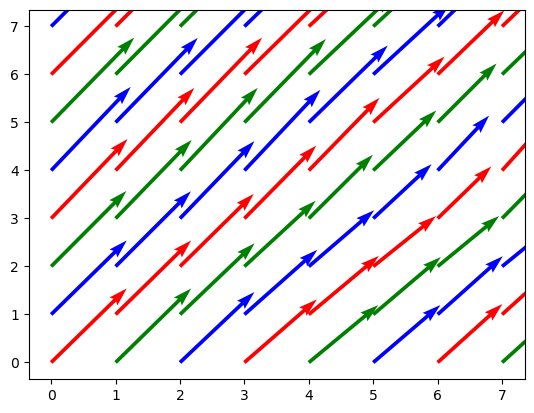

In [68]:
### for the frames of one curve now together with stable fluids

V = Velocities.copy()
N = Normals.copy()

Uinit = np.zeros(n_frames * width * height * 2)
U = np.zeros(n_frames * width * height * 2)

X = np.zeros(width * height)
Y = np.zeros(width * height)
for i in range(height):
    for j in range(width):
        X[i * width + j] = i
        Y[i * width + j] = j
P = np.array([X, Y])

for frame in range(n_frames):
    # Get data corresponding to the considered frame
    UinitFrame = Uinit[frame * cells * 2: (frame+1) * cells * 2]
    NFrame = N[frame * cells * 2: (frame+1) * cells * 2]
    VFrame = V[frame * cells * 2: (frame+1) * cells * 2]

    assert len(NFrame) == cells * 2

    # Set the constraint equality
    A = np.zeros([cells, cells * 2])
    B = np.zeros([cells])
    for cell in range(cells):
        A[cell, cell * 2: (cell+1) * 2] = NFrame[cell * 2: (cell+1) * 2]
        B[cell] = np.dot(VFrame[cell * 2: (cell+1) * 2],
                        NFrame[cell * 2: (cell+1) * 2])
    Binf = np.copy(B)
    Bsup = np.copy(B)
    for cell in range(cells):
        if B[cell] == 0:
            Binf[cell] = -np.inf
            Bsup[cell] = np.inf
            A[cell] = np.ones(cells * 2)

    cons = scipy.optimize.LinearConstraint(A, Binf, Bsup)

    # Solve
    if frame == 0:
        UFrame = VFrame
    else:
        def f(x):
            timeGradient = x-U[(frame-1) * cells * 2: frame * cells * 2]
            firstSpaceDimGradient = x[: (cells-width) * 2] - x[width * 2:]
            xWithoutFirstCol = np.array([x[i] for i in range(cells * 2) if i % (width * 2) != 0 and i % (width * 2) != 1])
            xWithoutLastCol = np.array([x[i] for i in range(cells * 2) if i % (width * 2) != (width * 2 - 2) and i % (width * 2) != (width * 2 - 1)])
            secondSpaceDimGradient = xWithoutLastCol - xWithoutFirstCol
            return np.sum(firstSpaceDimGradient**2) + np.sum(secondSpaceDimGradient**2) + np.sum(timeGradient**2)
        resFrame = scipy.optimize.minimize(f, UinitFrame, constraints=cons)
        UFrame = resFrame.x

    plt.quiver(*P, np.array([UFrame[i] for i in range(0, 2 * cells, 2)]),
            np.array([UFrame[i] for i in range(1, 2*cells, 2)]), color=['r', 'b', 'g'], scale=0.15)
    # plt.savefig('example_raw/frame_' + str(frame) + '.png')
    plt.show()

    for _ in range(3):
        UFrame = UFrame.reshape((height, width, 2))
        UFrame = diffuse(UFrame)
        UFrame = divergence_free(UFrame)
        UFrame = advect(UFrame)
        UFrame = UFrame.reshape(height * width * 2)


    U[(2*cells)*frame:(2*cells)*(frame+1)] = UFrame


    plt.quiver(*P, np.array([UFrame[i] for i in range(0, 2 * cells, 2)]),
            np.array([UFrame[i] for i in range(1, 2*cells, 2)]), color=['r', 'b', 'g'], scale=0.15)
    plt.savefig('example_ini_div_free/frame_' + str(frame) + '.png')
    plt.show()

### Let's put the object to the flow we built

0 [3. 1.] [0.01093079 0.0076237 ]


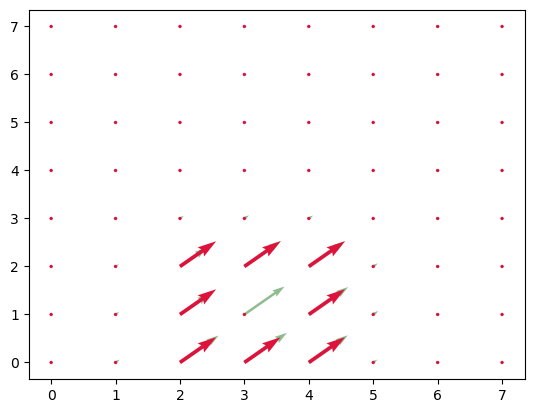

1 [3.04372315 1.0304948 ] [0.01021161 0.00685166]


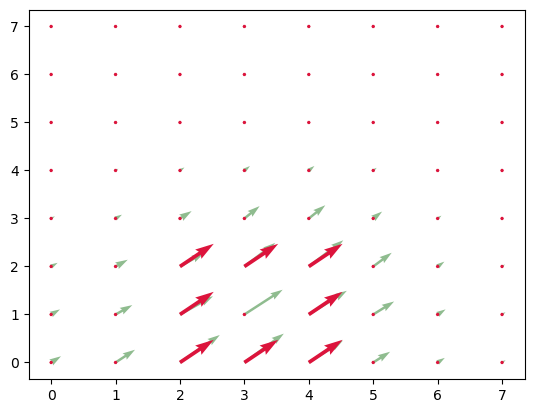

2 [3.0845696  1.05790145] [0.01031956 0.00698723]


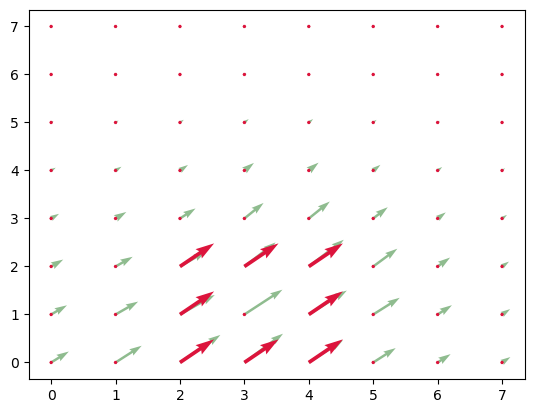

3 [3.12584783 1.08585035] [0.01049094 0.00719712]


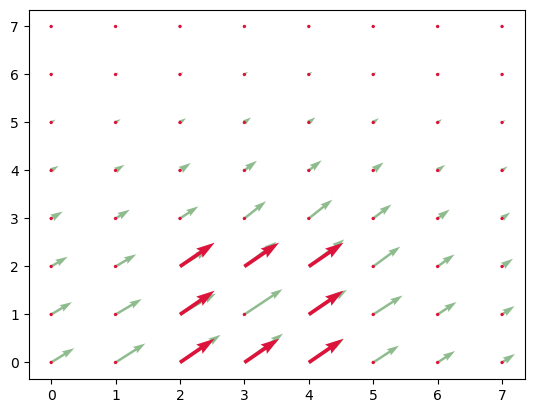

4 [3.16781159 1.11463881] [0.01054045 0.0073373 ]


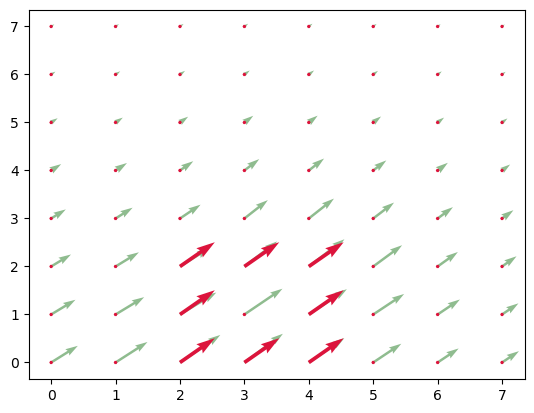

5 [3.20997337 1.14398802] [0.01054726 0.00744333]


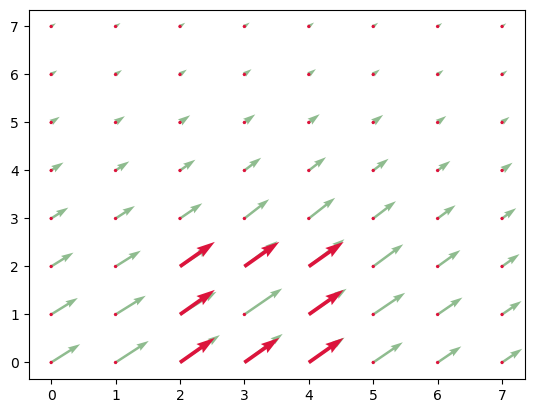

6 [3.25216242 1.17376136] [0.0105246  0.00751664]


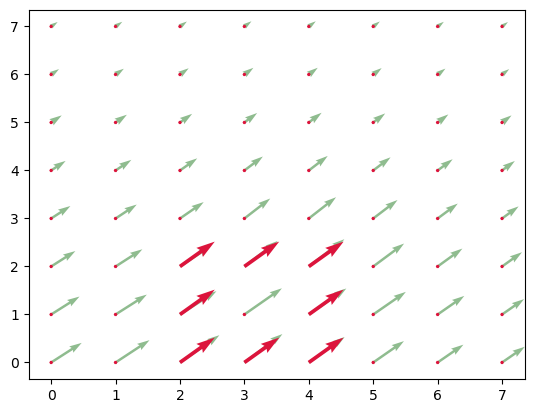

7 [3.29426083 1.20382793] [0.01039535 0.00751845]


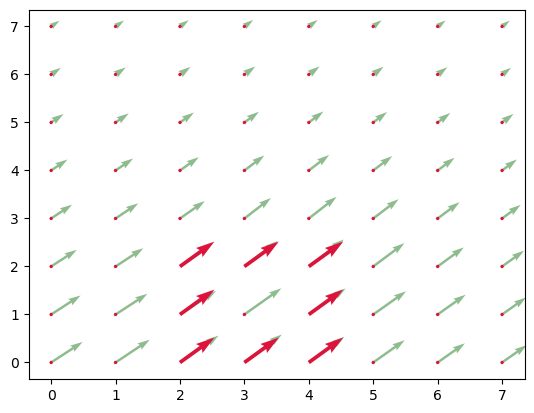

8 [3.33584221 1.23390172] [0.01027612 0.00751785]


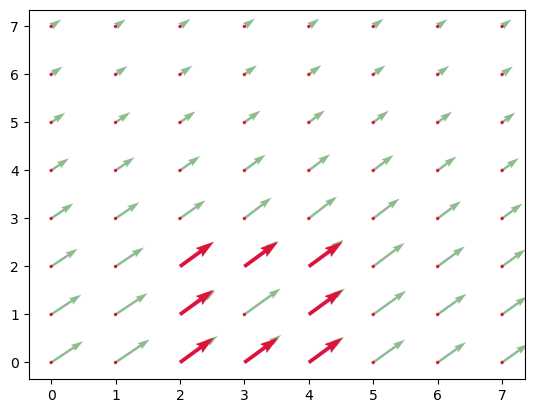

9 [3.37694669 1.26397312] [0.01021541 0.00752847]


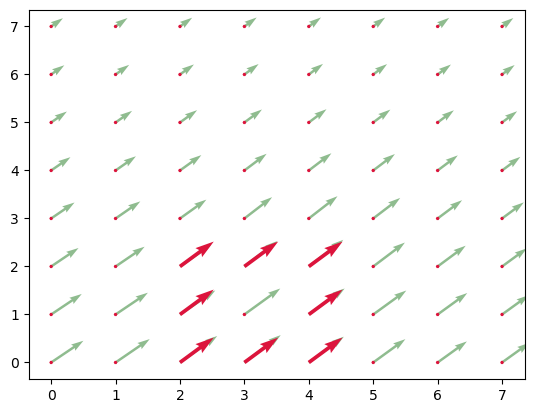

10 [3.41780833 1.29408698] [0.01011116 0.00750999]


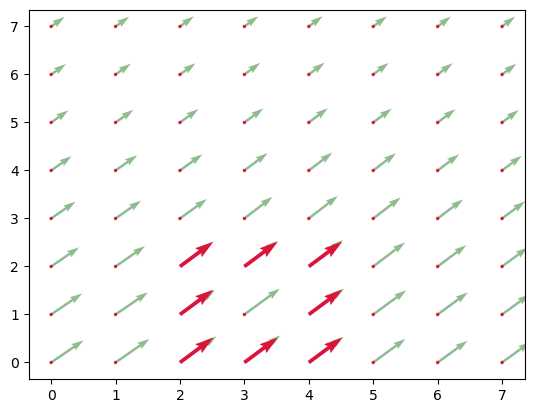

11 [3.45825298 1.32412696] [0.01000117 0.00747512]


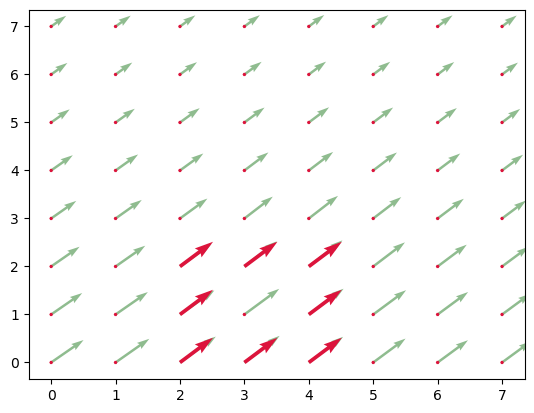

12 [3.49825766 1.35402745] [0.00989569 0.00742938]


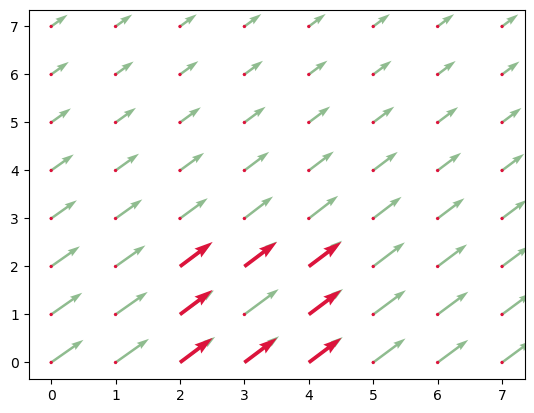

13 [3.53784043 1.38374497] [0.00980547 0.00738169]


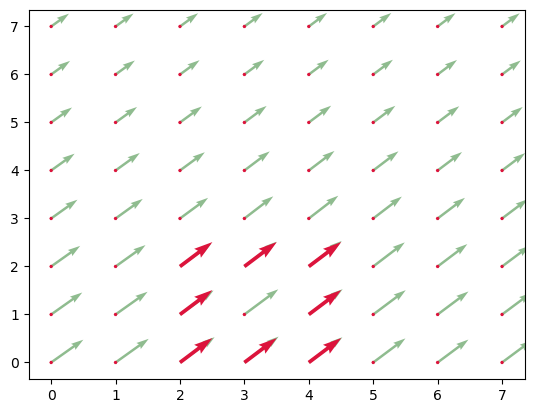

14 [3.5770623  1.41327174] [0.00975973 0.0073515 ]


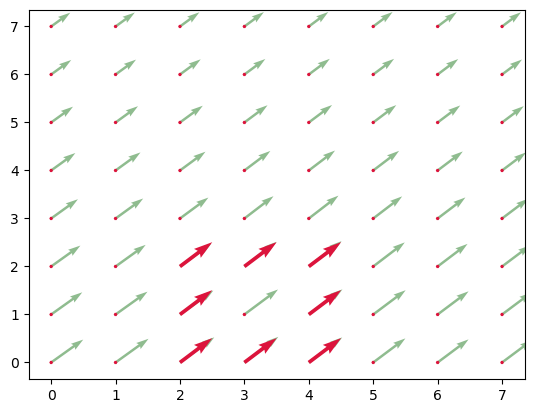

15 [3.61610121 1.44267775] [0.00974949 0.00728408]


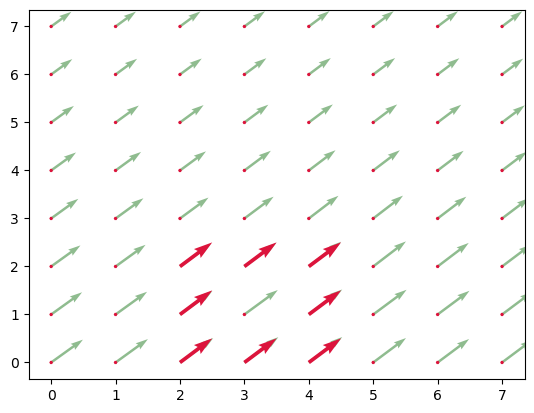

16 [3.65509918 1.47181409] [0.00969951 0.00722712]


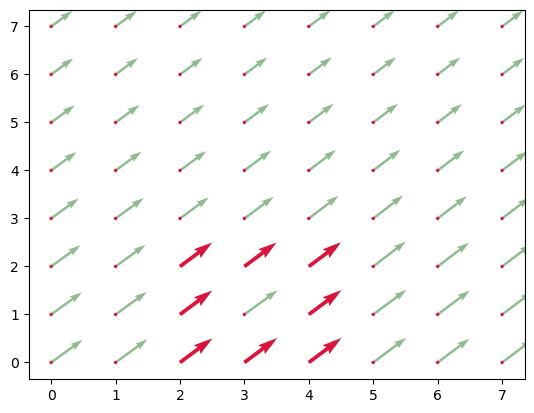

17 [3.69389724 1.50072257] [0.00980592 0.00727358]


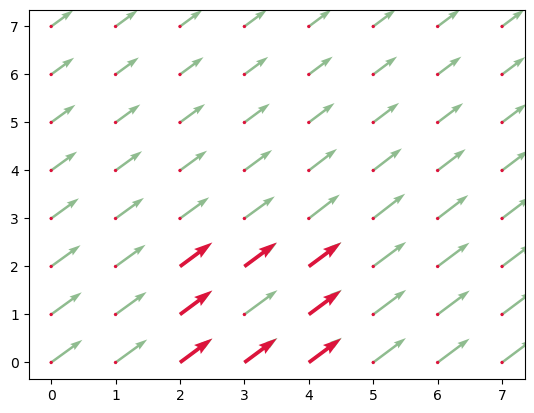

18 [3.73312091 1.52981687] [0.00981633 0.00725294]


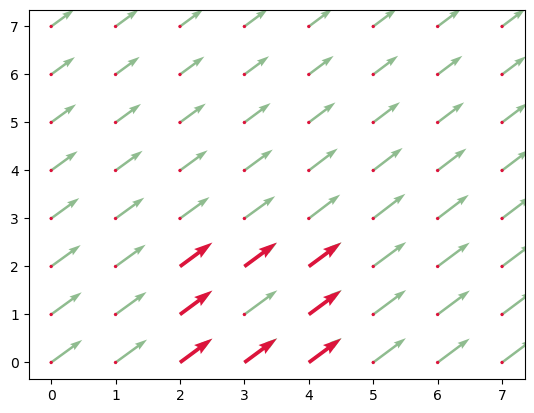

19 [3.77238623 1.55882864] [0.00984268 0.0072375 ]


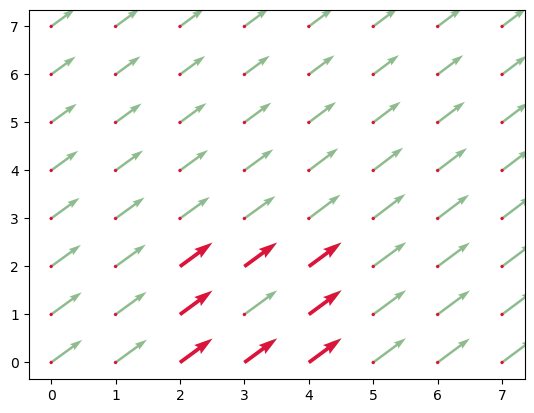

20 [3.81175693 1.58777865] [0.0098797 0.0072308]


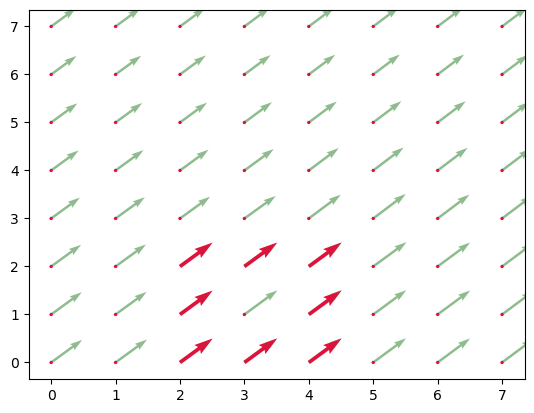

21 [3.85127574 1.61670187] [0.00992716 0.00723281]


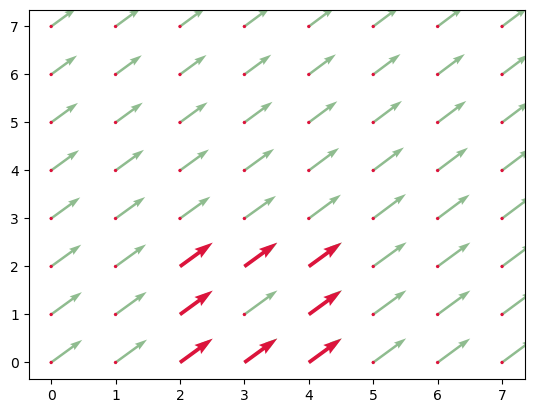

22 [3.89098438 1.6456331 ] [0.00997122 0.00724429]


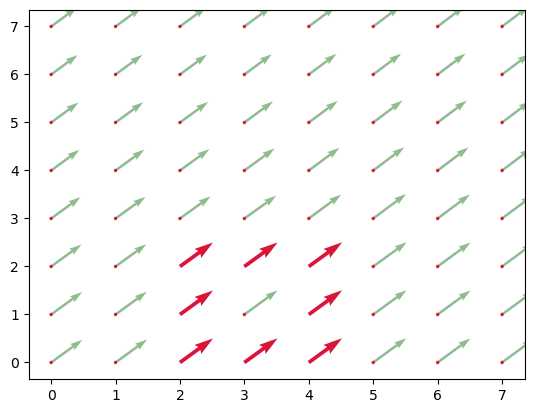

23 [3.93086924 1.67461025] [0.01005882 0.00726095]


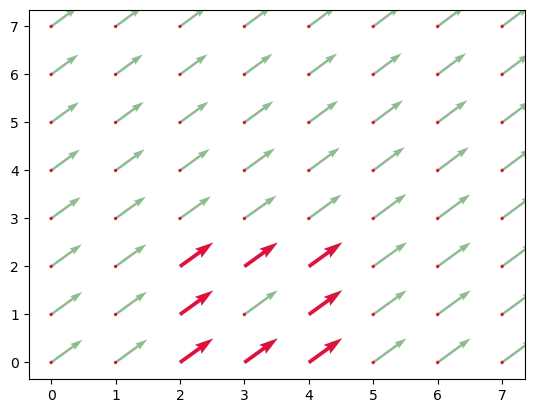

24 [3.97110453 1.70365404] [0.01012427 0.00727983]


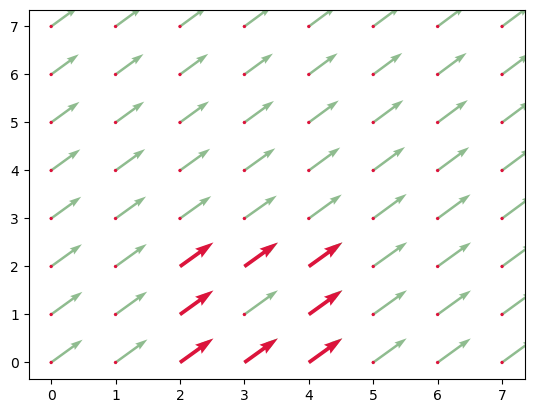

25 [4.0116016  1.73277335] [0.01025904 0.00731509]


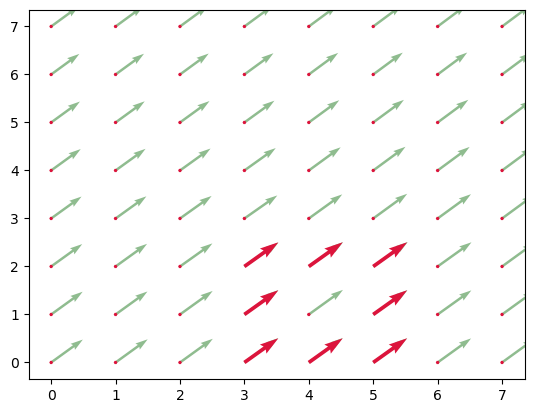

26 [4.05263776 1.76203369] [0.0103949  0.00737338]


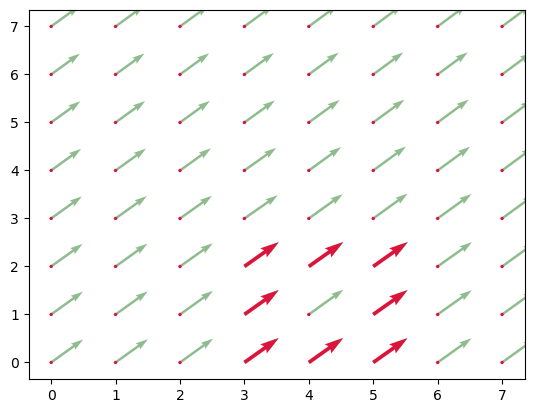

27 [4.09421737 1.79152722] [0.01050584 0.00742236]


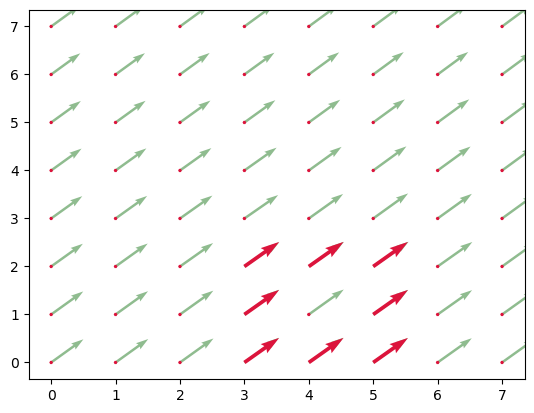

28 [4.13624074 1.82121664] [0.0106536 0.007504 ]


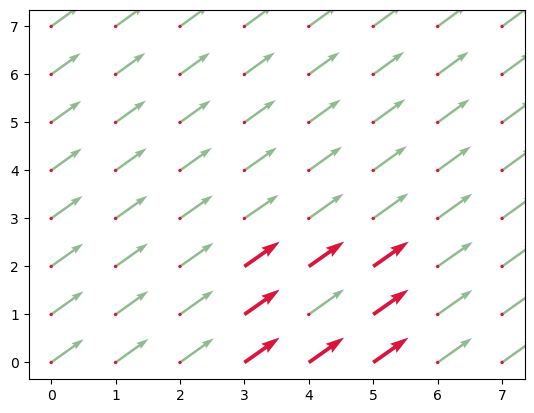

29 [4.17885515 1.85123264] [0.01083611 0.00762001]


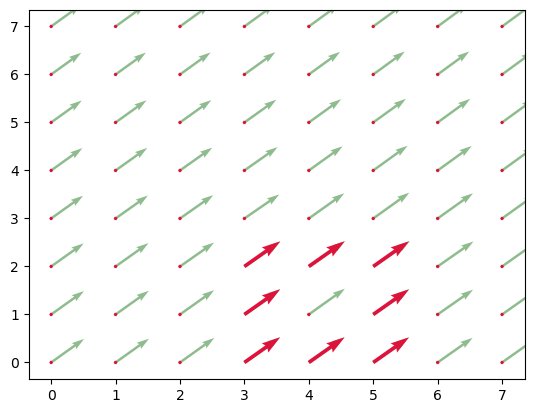

30 [4.2221996  1.88171266] [0.01093414 0.00769811]


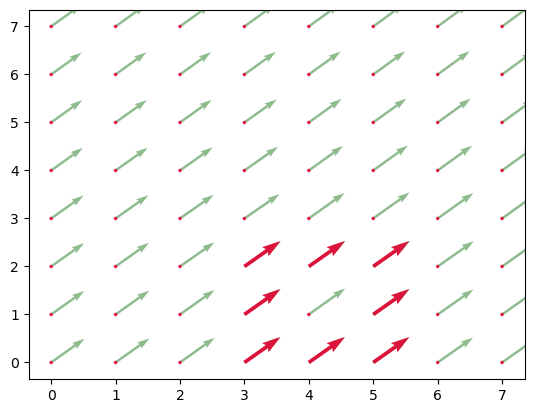

31 [4.26593616 1.91250509] [0.01106859 0.00782294]


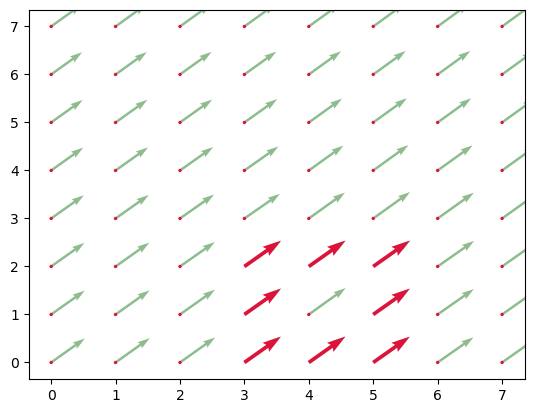

32 [4.31021052 1.94379685] [0.01122375 0.00801752]


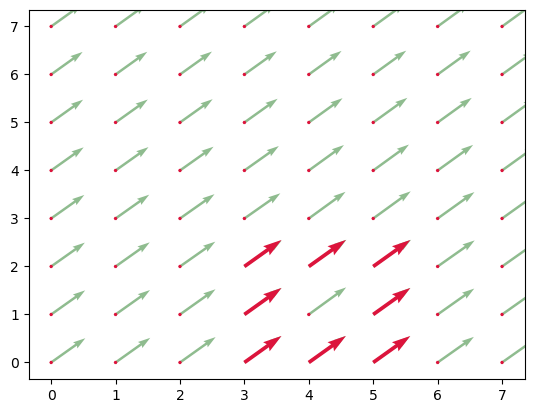

33 [4.35510553 1.97586695] [0.01129852 0.0081346 ]


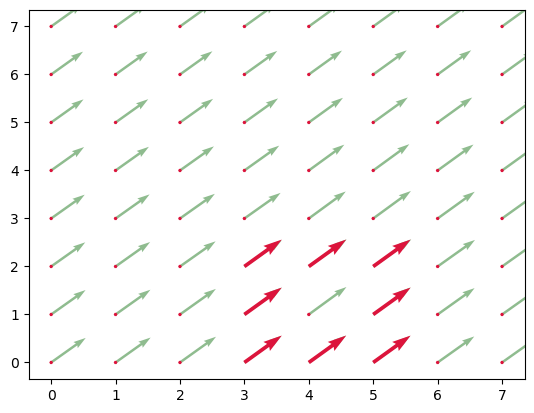

34 [4.40029962 2.00840533] [0.01135867 0.00827851]


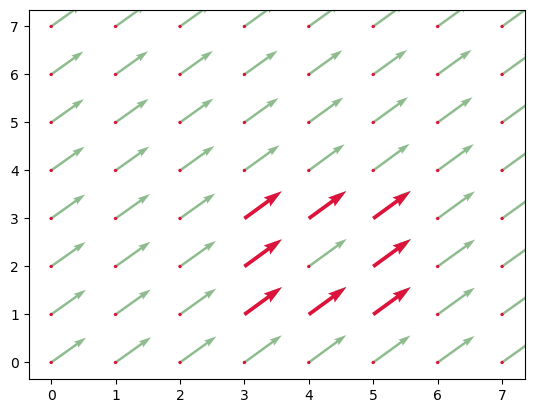

35 [4.44573429 2.04151938] [0.01137237 0.008456  ]


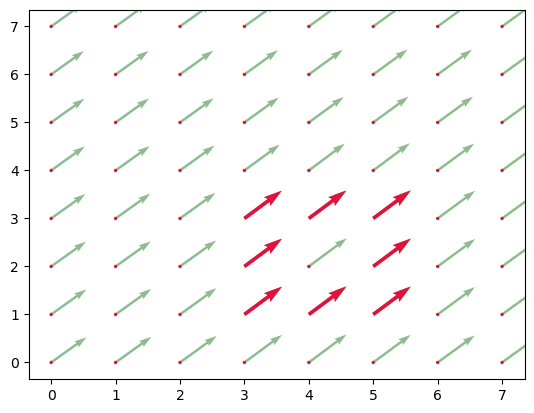

36 [4.49122378 2.07534336] [0.01134302 0.00858738]


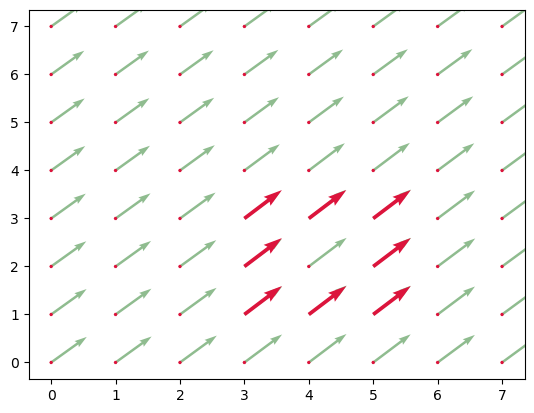

37 [4.53659586 2.1096929 ] [0.01131751 0.00866657]


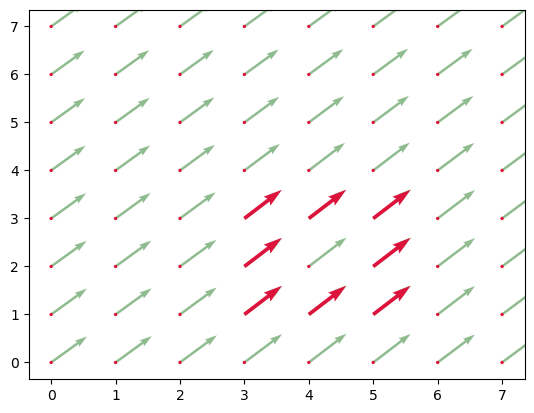

38 [4.5818659  2.14435918] [0.01121473 0.00878711]


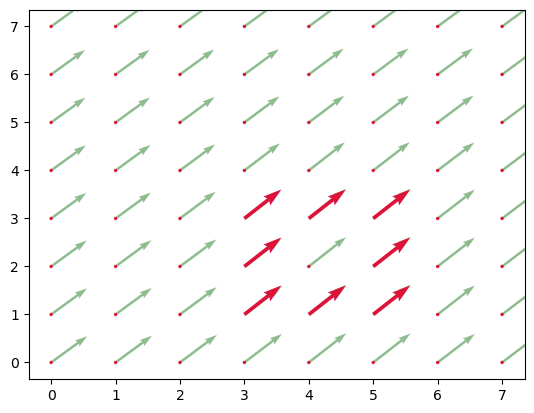

39 [4.62672483 2.17950762] [0.0110898  0.00887113]


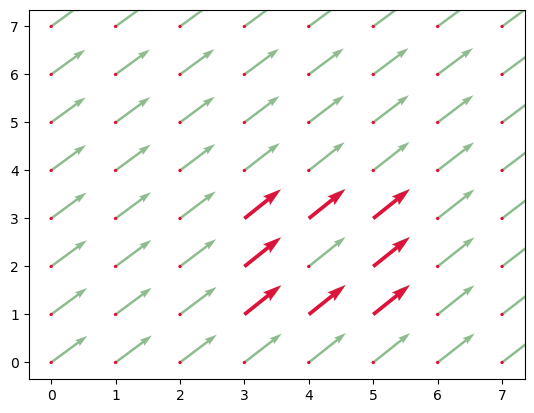

40 [4.67108401 2.21499214] [0.01096279 0.00894871]


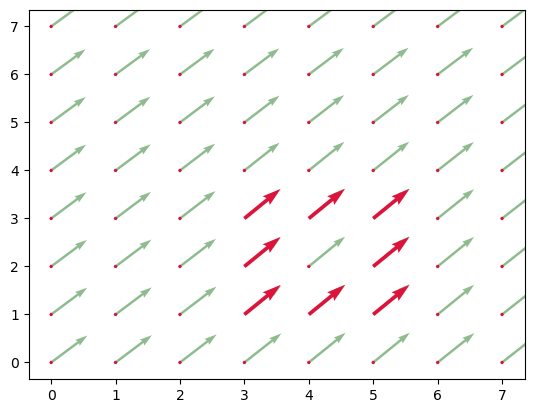

41 [4.71493517 2.25078697] [0.01087475 0.00900264]


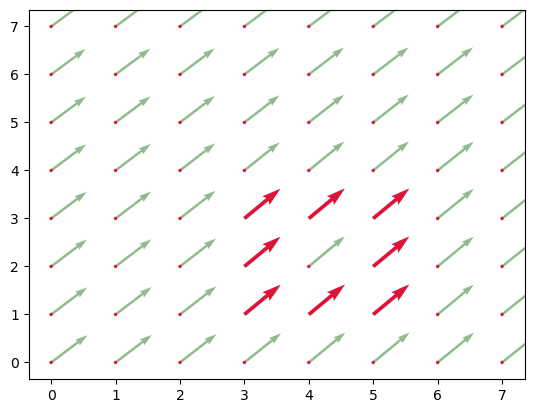

42 [4.75843415 2.28679754] [0.01079296 0.00905009]


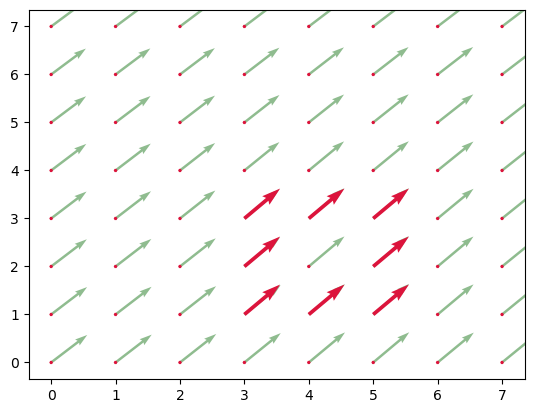

43 [4.80160598 2.3229979 ] [0.01064814 0.00907679]


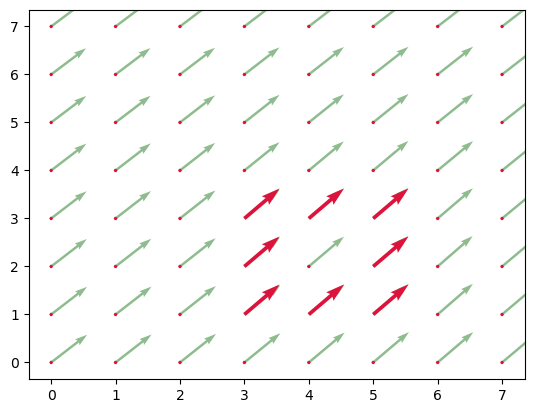

44 [4.84419853 2.35930504] [0.01050932 0.00911159]


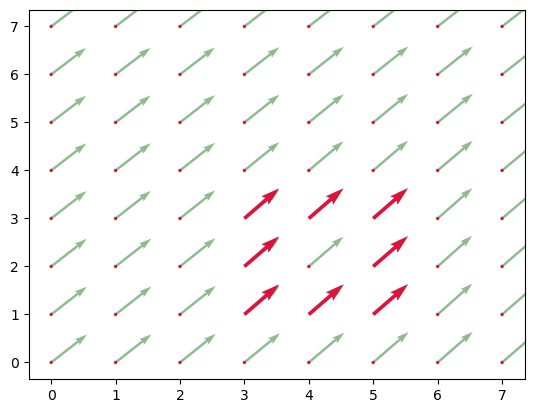

45 [4.8862358  2.39575139] [0.01035773 0.00914731]


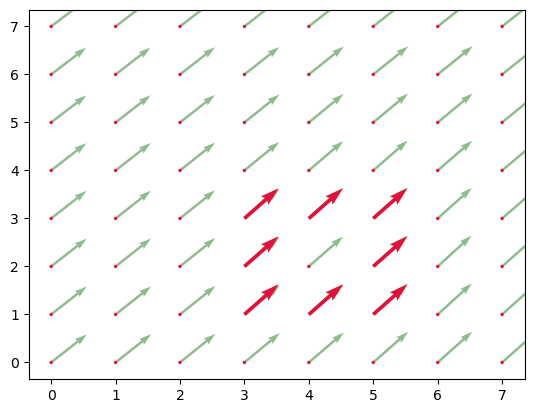

46 [4.9276667  2.43234065] [0.01019771 0.00918105]


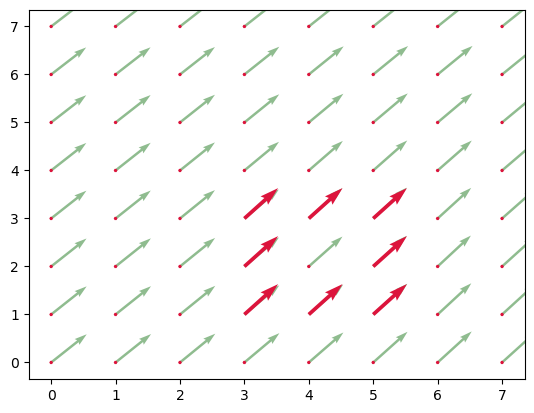

47 [4.96845753 2.46906485] [0.01009156 0.00921185]


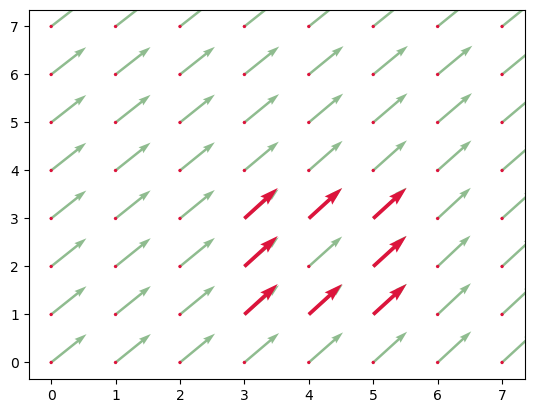

48 [5.00882377 2.50591224] [0.00993238 0.00924344]


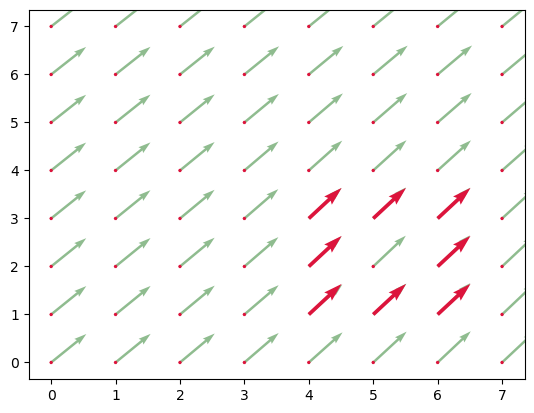

49 [5.04855329 2.54288599] [0.00967592 0.0092567 ]


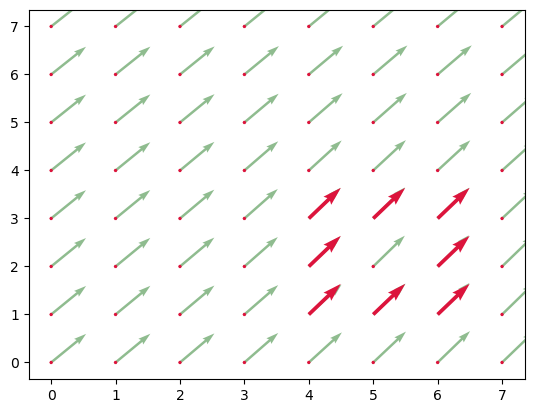

50 [5.08725695 2.57991279] [0.0095025  0.00924228]


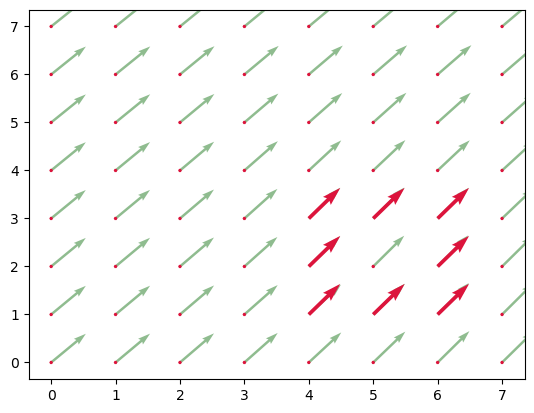

51 [5.12526696 2.61688193] [0.00937264 0.00924176]


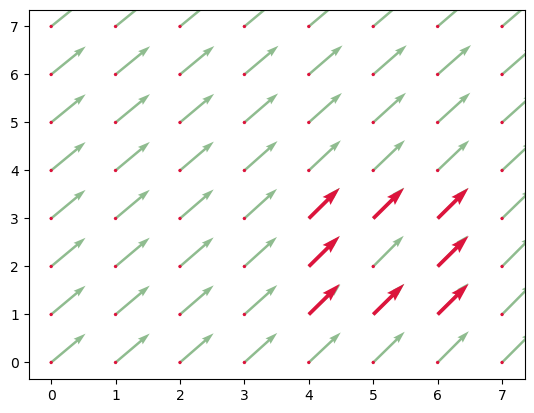

52 [5.16275754 2.65384896] [0.00903029 0.00919766]


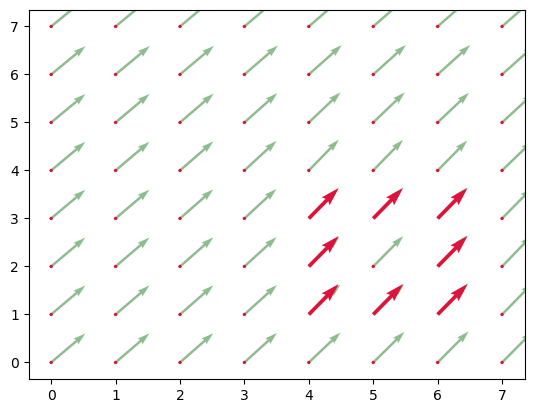

53 [5.19887872 2.69063959] [0.00874177 0.0091327 ]


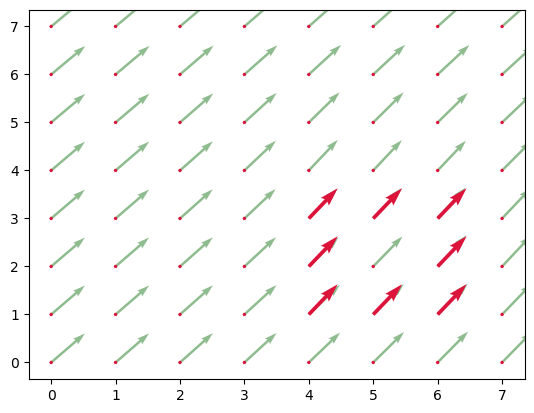

54 [5.2338458  2.72717037] [0.00841467 0.00905308]


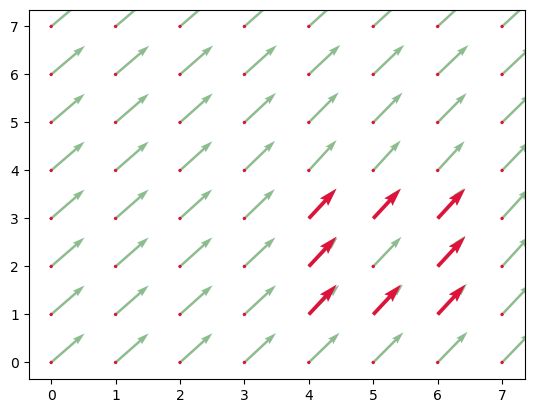

55 [5.26750447 2.76338269] [0.00804985 0.00895408]


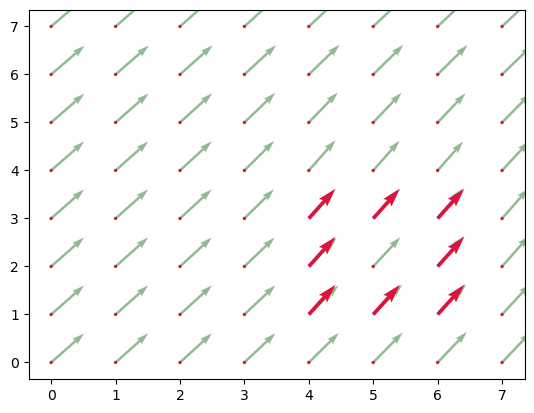

56 [5.29970385 2.79919902] [0.00765847 0.00884301]


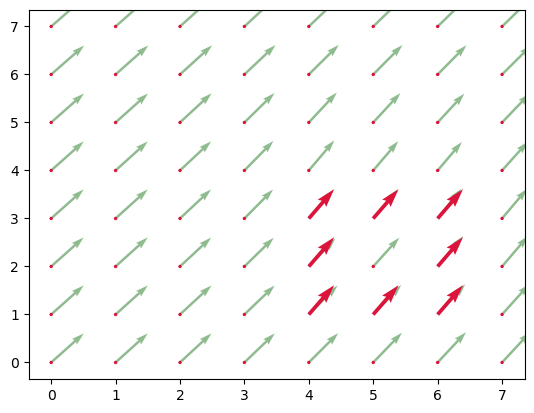

57 [5.33033774 2.83457107] [0.00723961 0.00871503]


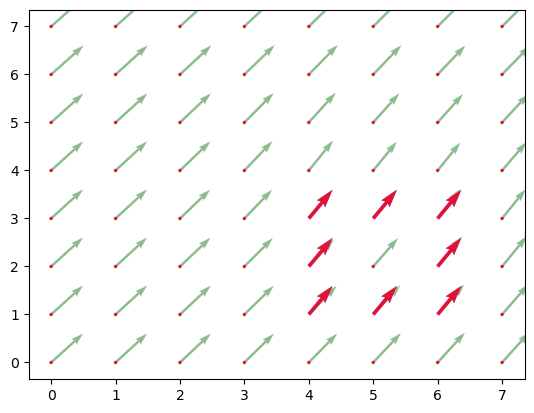

58 [5.35929619 2.86943117] [0.0068046  0.00857759]


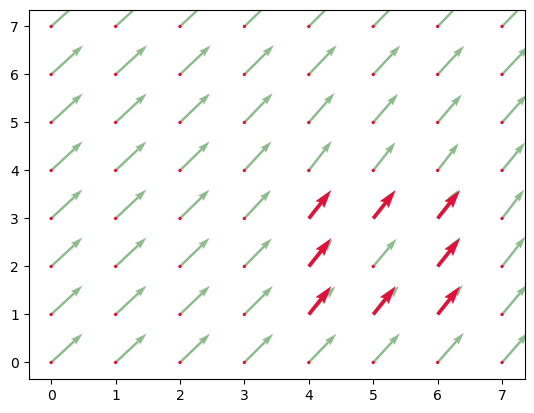

59 [5.38651458 2.90374152] [0.00643193 0.00845243]


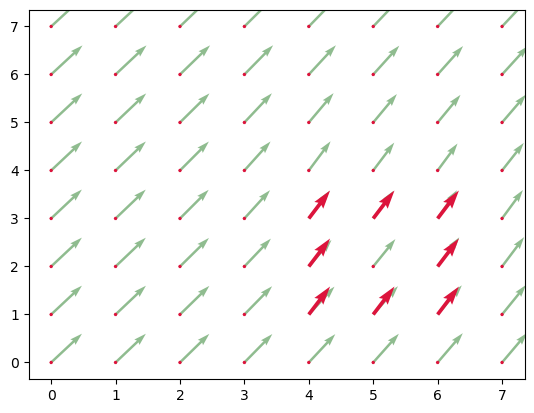

60 [5.41224231 2.93755123] [0.00599544 0.00830274]


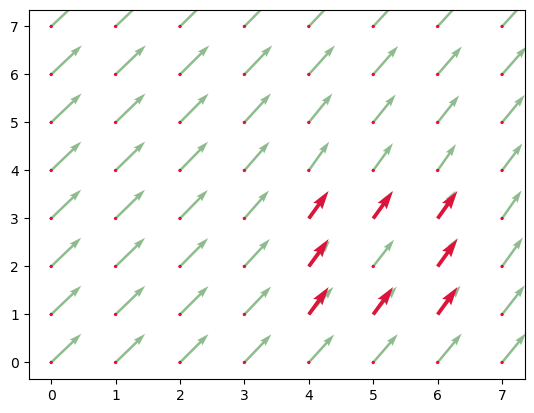

61 [5.43622406 2.97076219] [0.00561962 0.00816973]


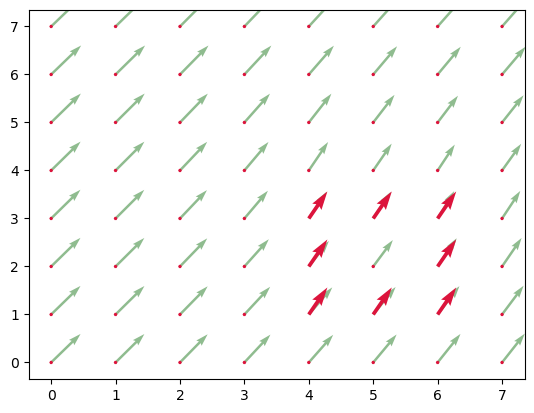

62 [5.45870252 3.00344113] [0.00519328 0.0080136 ]


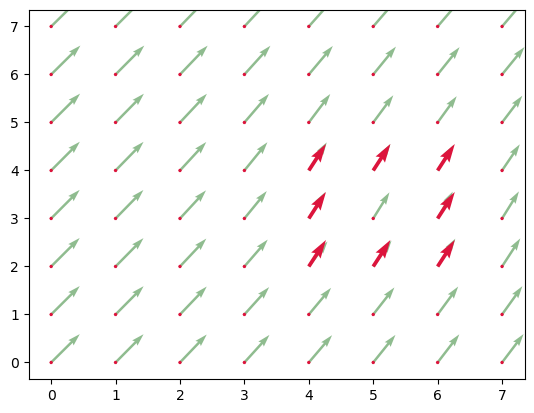

63 [5.47947564 3.03549552] [0.00484456 0.00788292]


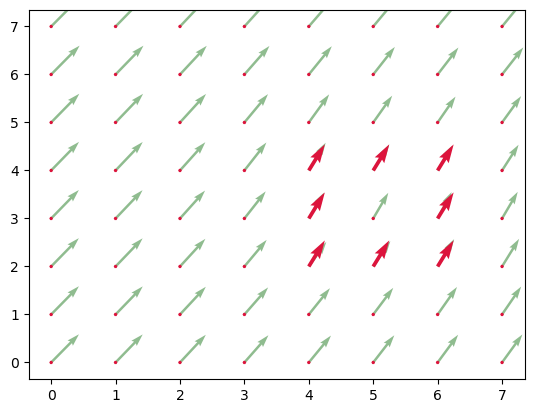

64 [5.49885387 3.06702721] [0.00451352 0.00775546]


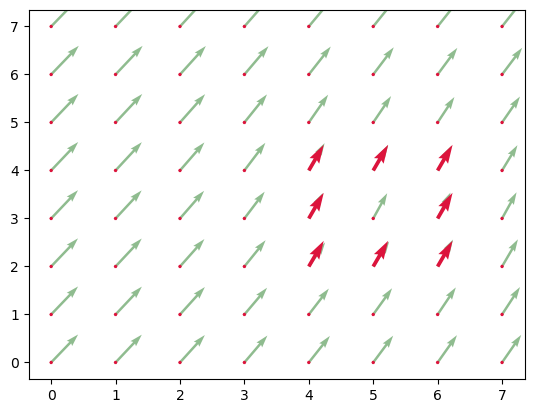

65 [5.51690797 3.09804905] [0.00419415 0.00762908]


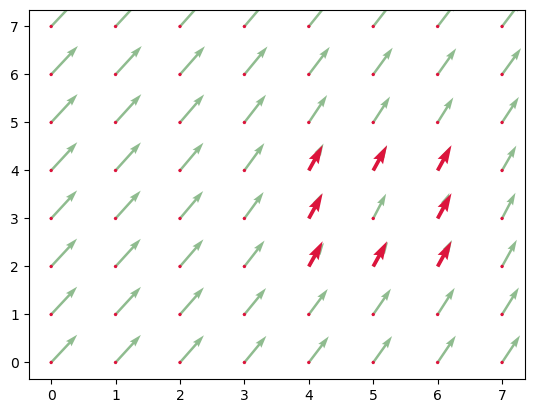

66 [5.53368458 3.12856539] [0.00384483 0.00749649]


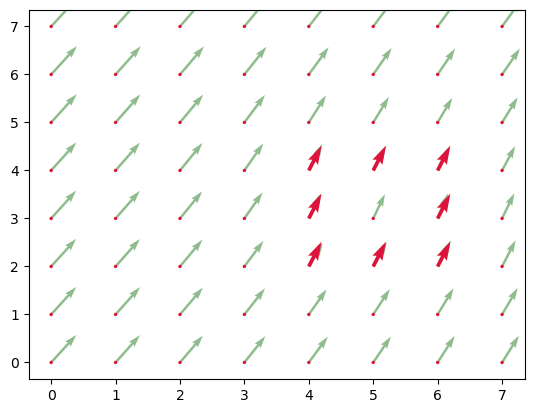

67 [5.54906392 3.15855135] [0.0035408  0.00737374]


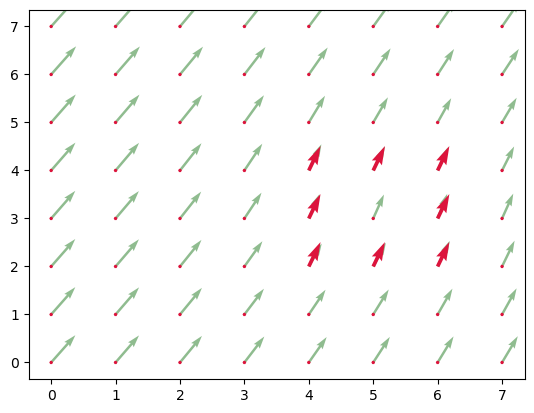

68 [5.5632271  3.18804629] [0.003254   0.00725089]


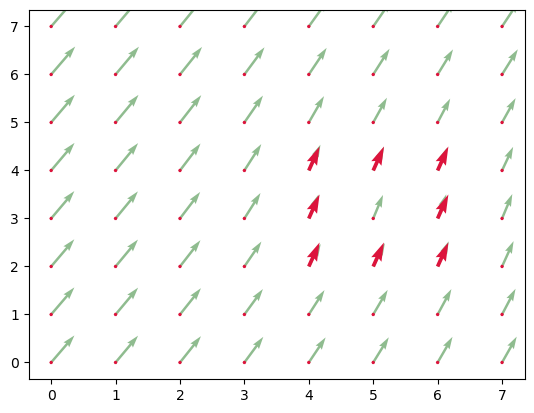

69 [5.57624309 3.21704986] [0.00298133 0.00712605]


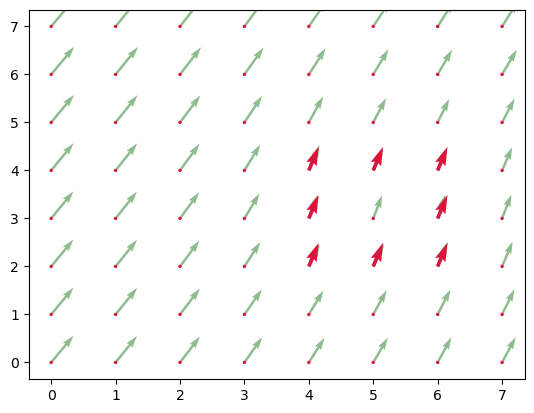

70 [5.58816842 3.24555405] [0.00272072 0.00699589]


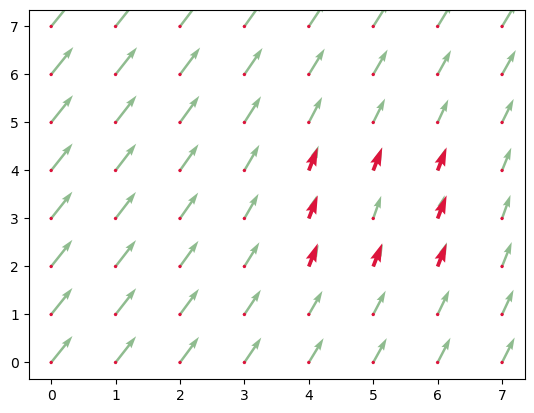

71 [5.59905131 3.2735376 ] [0.00247211 0.00686357]


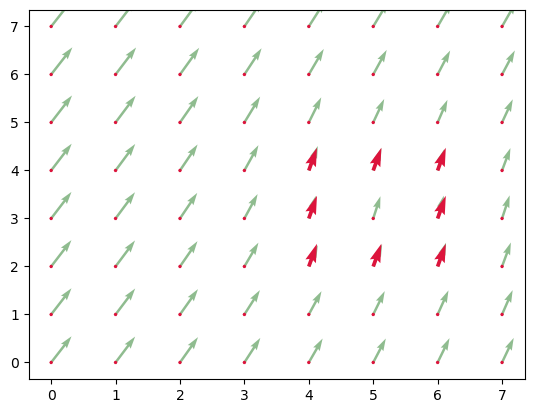

72 [5.60893973 3.30099186] [0.00223302 0.00672622]


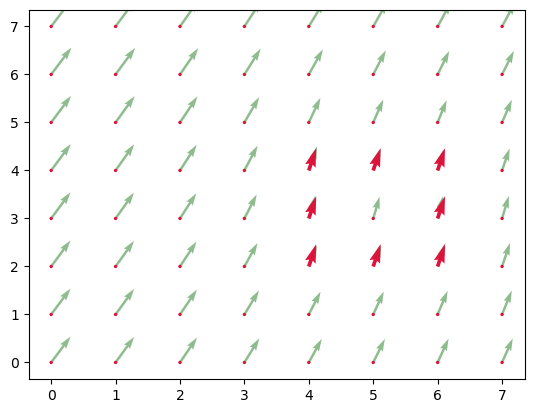

73 [5.6178718  3.32789674] [0.00200622 0.006585  ]


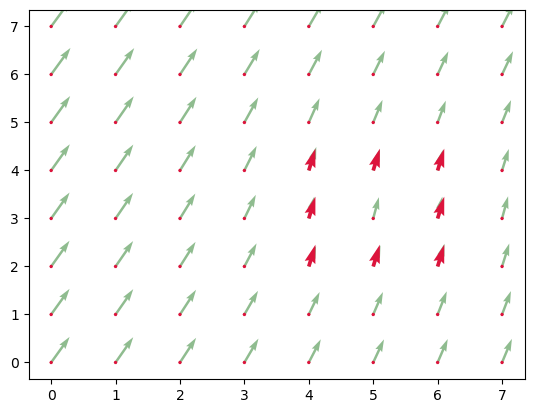

74 [5.62589668 3.35423674] [0.00179046 0.00643769]


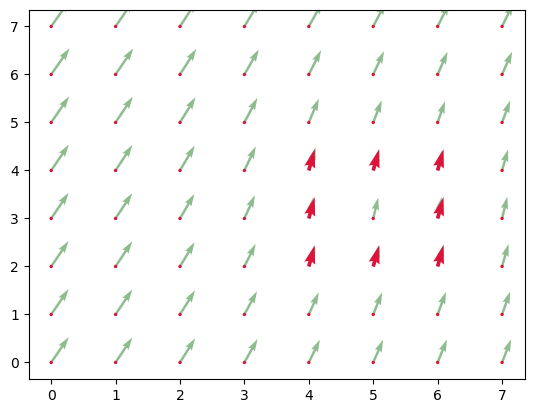

75 [5.63305852 3.37998752] [0.00158533 0.0062846 ]


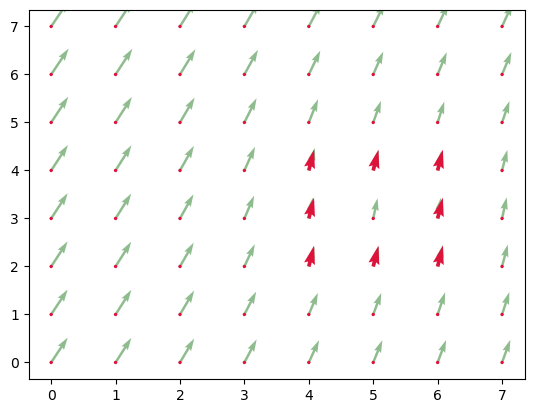

76 [5.63939985 3.4051259 ] [0.00148204 0.00625192]


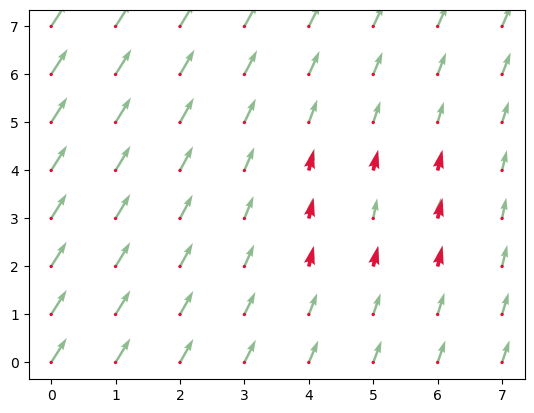

77 [5.645328   3.43013358] [0.00132014 0.00613113]


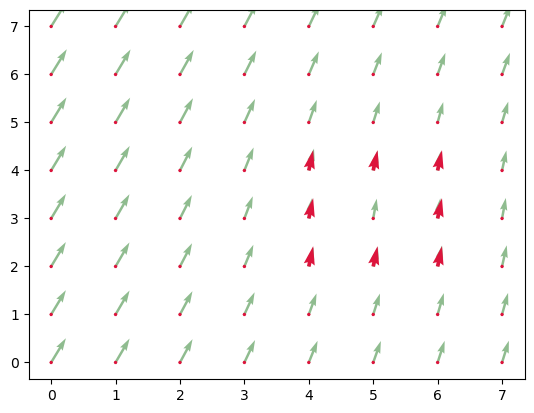

78 [5.65060856 3.45465808] [0.00115475 0.0059904 ]


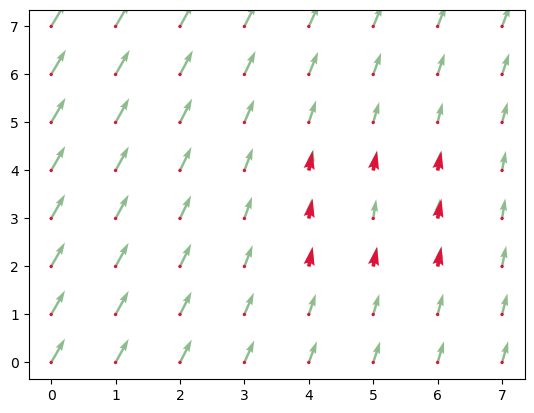

79 [5.65522756 3.4786197 ] [0.00096147 0.00581592]


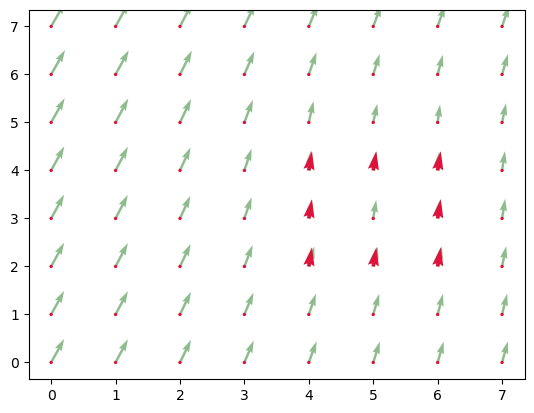

80 [5.65907344 3.50188337] [0.00083549 0.0056792 ]


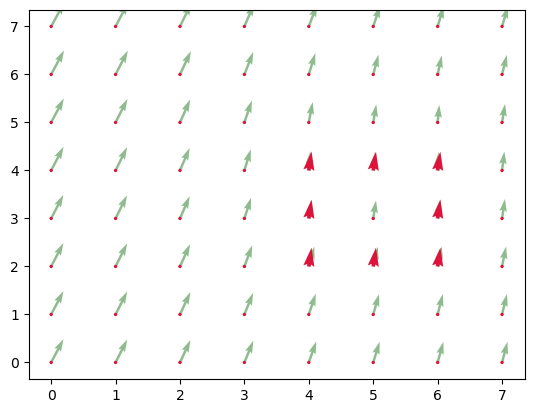

81 [5.66241541 3.52460016] [0.00070496 0.00553054]


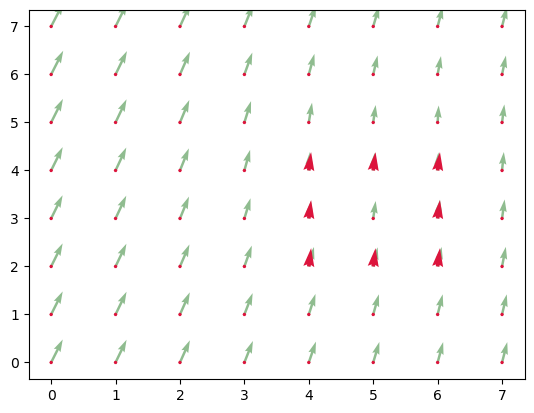

82 [5.66523526 3.54672232] [0.00057302 0.00537421]


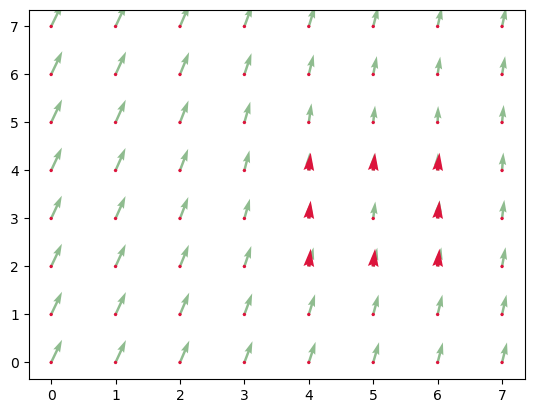

83 [5.66752735 3.56821916] [0.00044251 0.00521108]


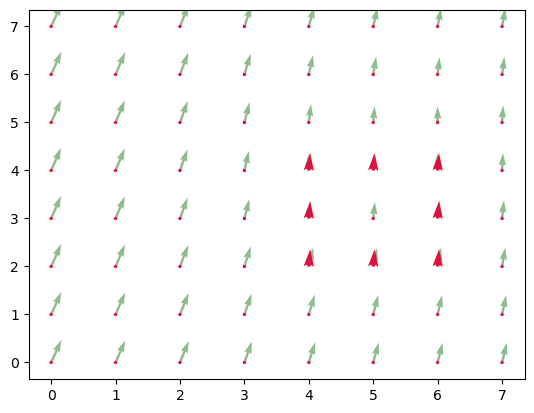

84 [5.66929738 3.58906349] [0.00031574 0.00504442]


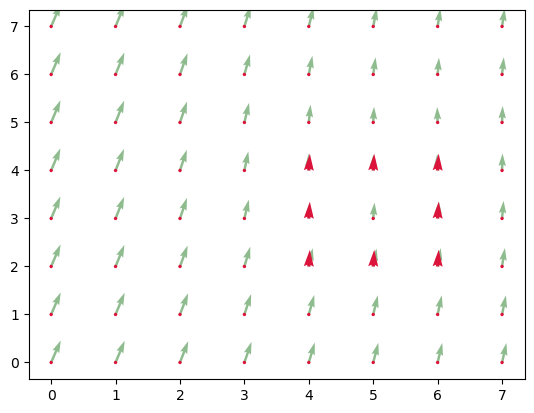

85 [5.67056033 3.60924118] [0.00019277 0.00487617]


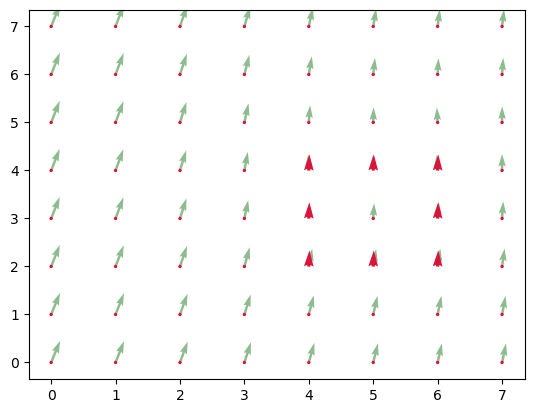

86 [5.67133141 3.62874586] [7.41515263e-05 4.70651802e-03]


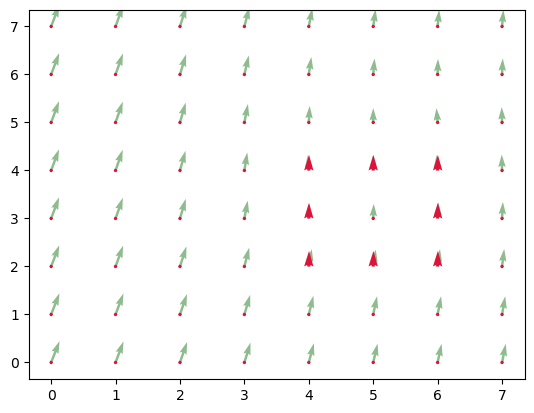

87 [5.67162802 3.64757193] [-4.02348128e-05  4.53552254e-03]


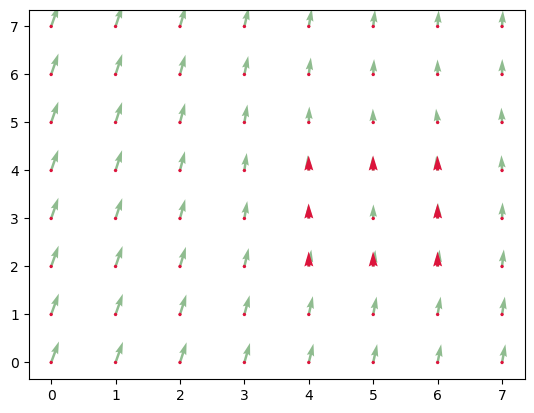

88 [5.67146708 3.66571402] [-0.00015027  0.00436398]


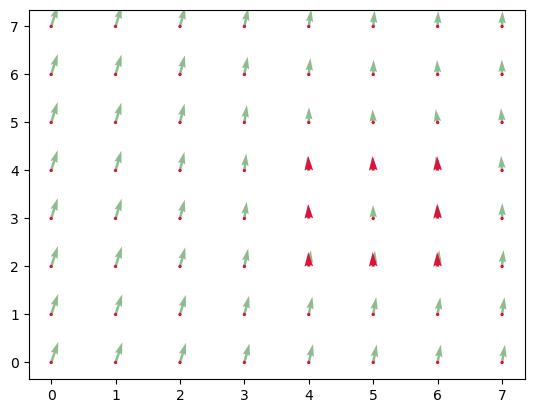

89 [5.67086602 3.68316995] [-0.00025571  0.00419473]


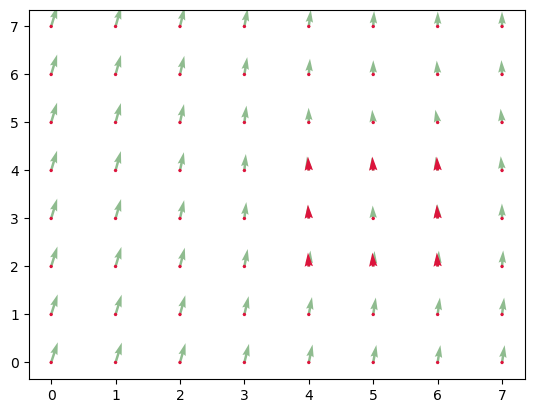

90 [5.66984319 3.69994885] [-0.00035684  0.00402731]


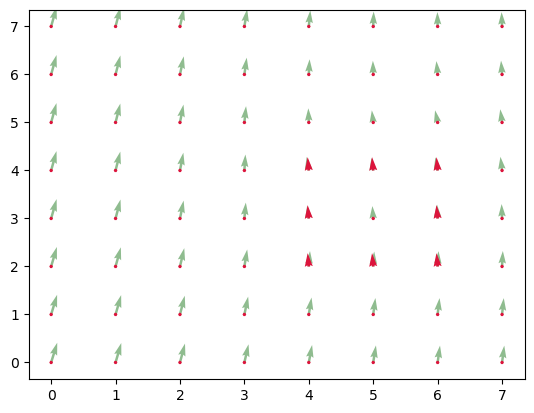

91 [5.66841582 3.7160581 ] [-0.00044099  0.00387372]


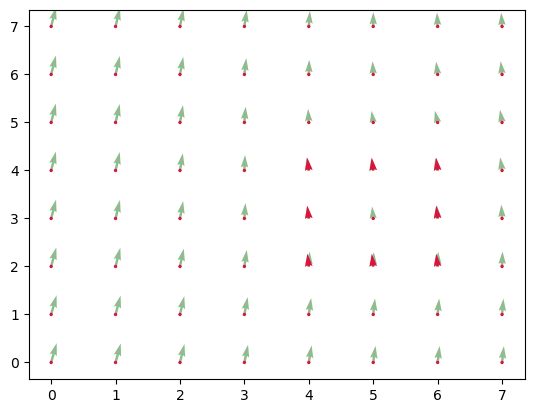

92 [5.66665185 3.73155298] [-0.00052095  0.00372161]


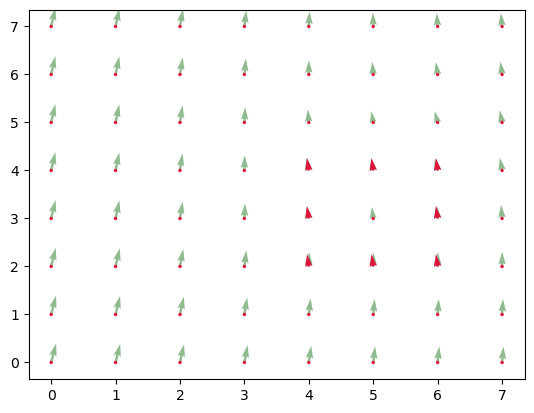

93 [5.66456803 3.74643942] [-0.0005981   0.00356825]


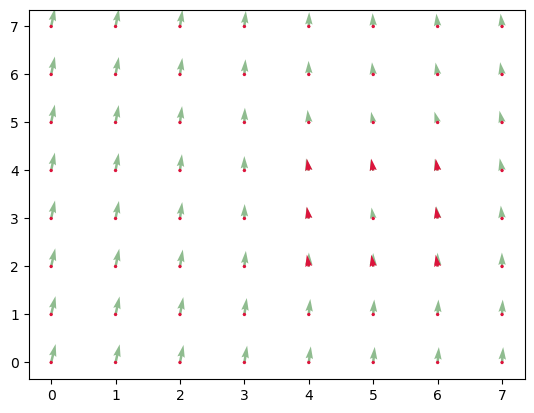

94 [5.66217563 3.76071241] [-0.00067649  0.00341333]


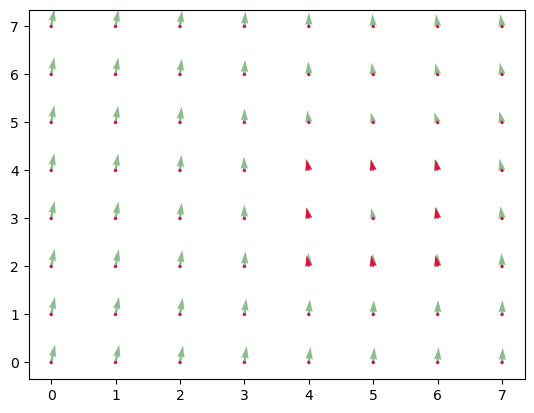

95 [5.65946968 3.77436573] [-0.00075532  0.00325547]


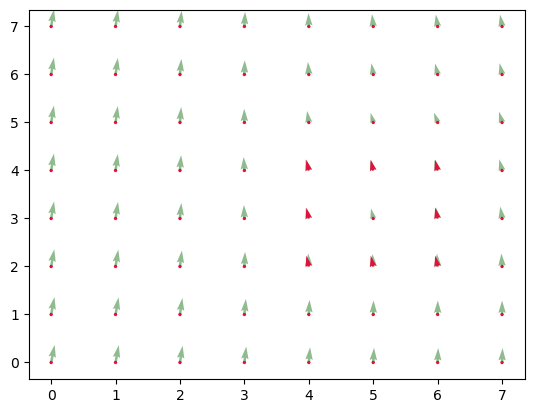

96 [5.65644839 3.78738759] [-0.00083719  0.00309468]


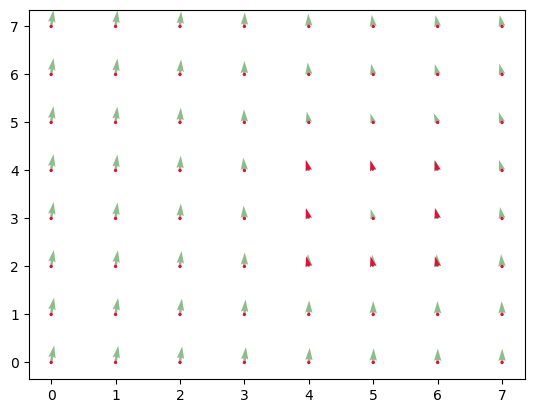

97 [5.65309963 3.7997663 ] [-0.00092319  0.00293135]


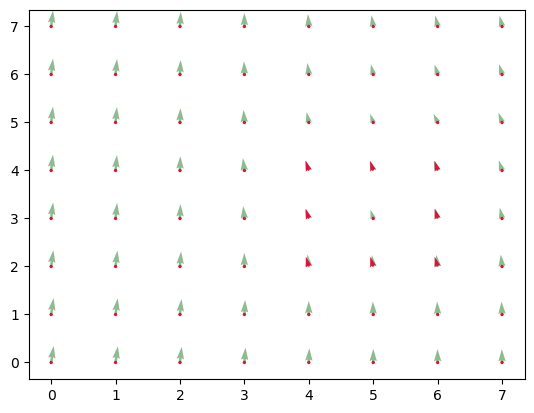

98 [5.64940687 3.81149168] [-0.00101399  0.00276548]


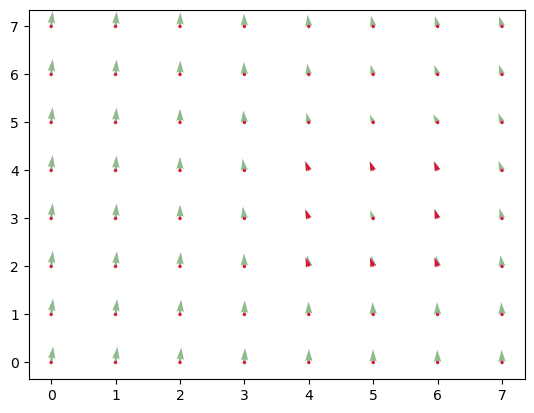

99 [5.64535091 3.82255361] [-0.00111057  0.00259815]


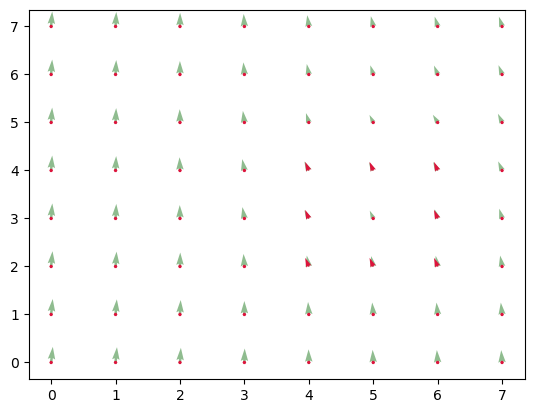

100 [5.64090863 3.8329462 ] [-0.00121497  0.00243015]


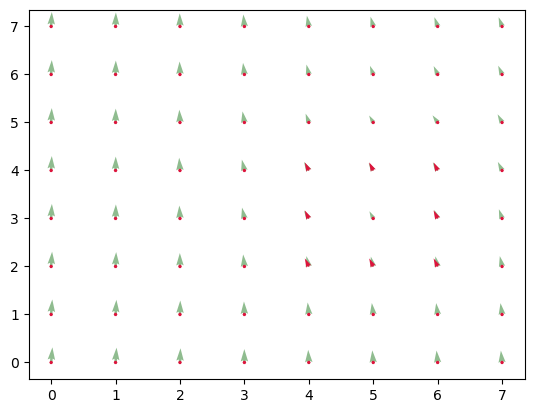

101 [5.63604876 3.84266682] [-0.00132698  0.00226176]


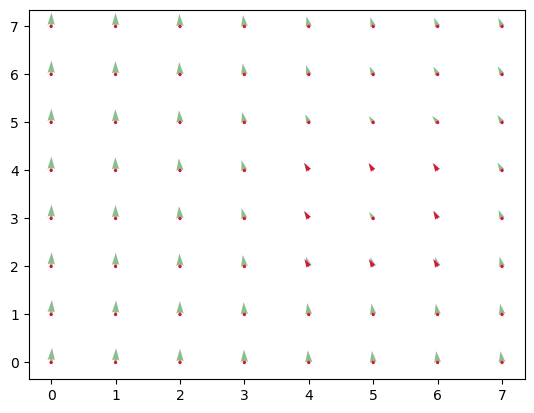

102 [5.63074086 3.85171387] [-0.00144834  0.00209472]


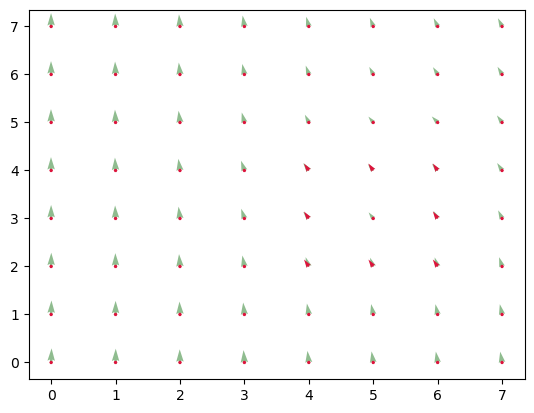

103 [5.62494752 3.86009276] [-0.00157873  0.00193011]


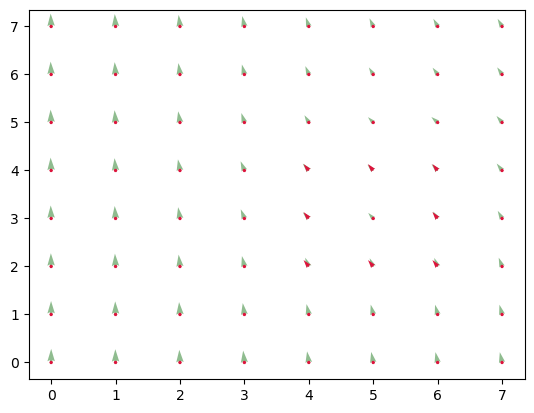

104 [5.6186326 3.8678132] [-0.00171935  0.00176894]


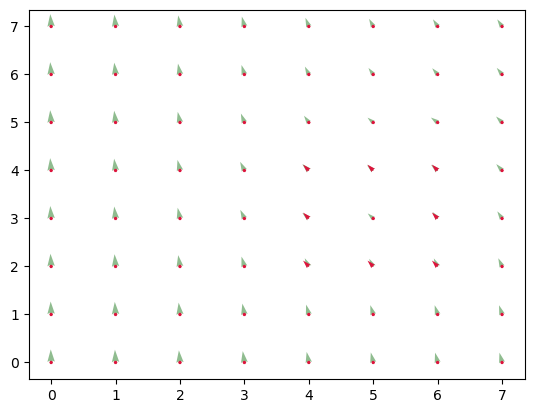

105 [5.61175519 3.87488897] [-0.00186899  0.00161317]


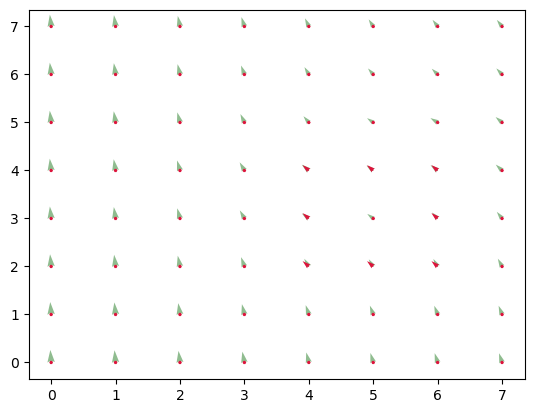

106 [5.60427922 3.88134163] [-0.00202959  0.00146288]


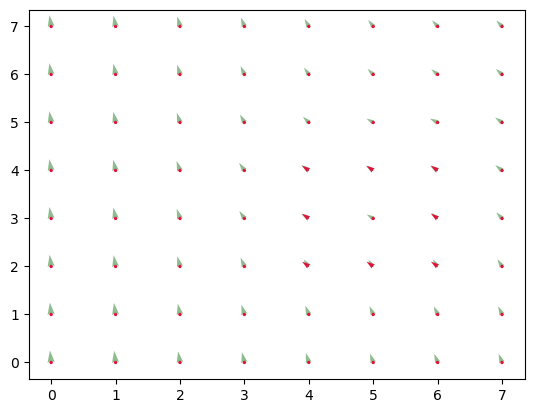

107 [5.59616088 3.88719317] [-0.00220073  0.00132032]


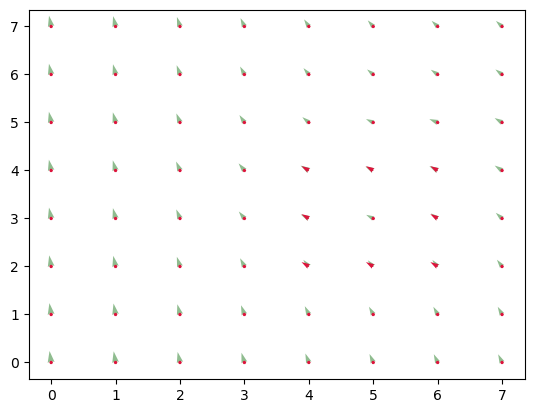

108 [5.58735794 3.89247445] [-0.00238138  0.00118617]


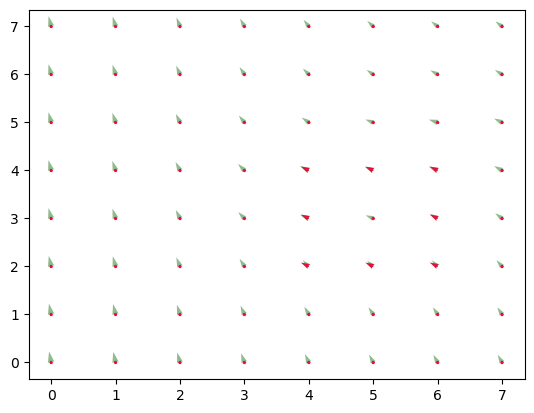

109 [5.57783243 3.89721911] [-0.00248334  0.00115418]


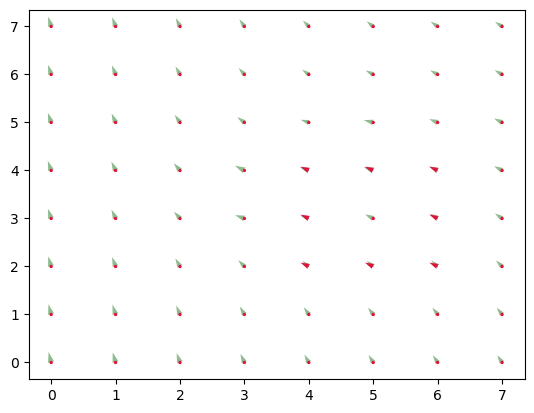

110 [5.56789906 3.90183582] [-0.00260565  0.00109679]


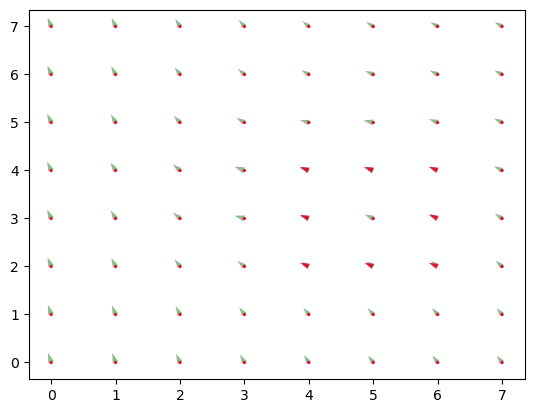

111 [5.55747647 3.90622296] [-0.00276239  0.00102379]


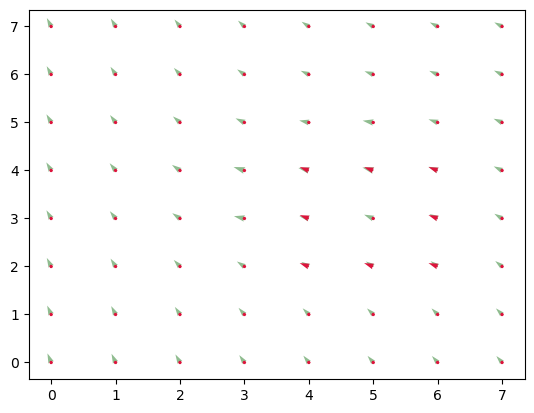

112 [5.54642691 3.91031811] [-0.00293908  0.00094613]


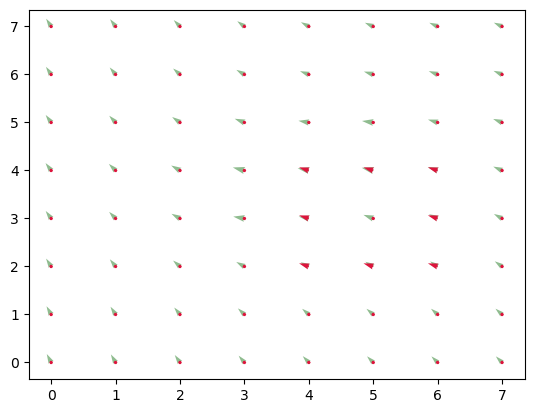

113 [5.53467057 3.91410263] [-0.00312875  0.00086854]


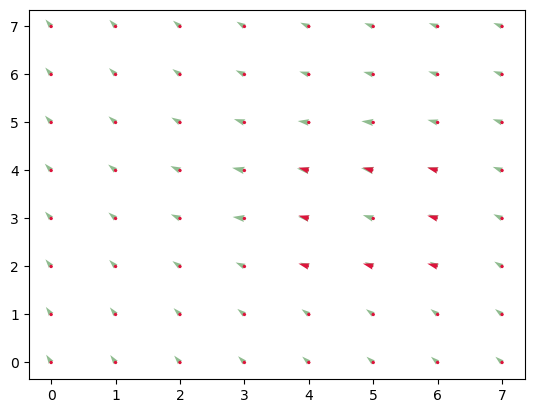

114 [5.52215559 3.91757678] [-0.00332801  0.00079433]


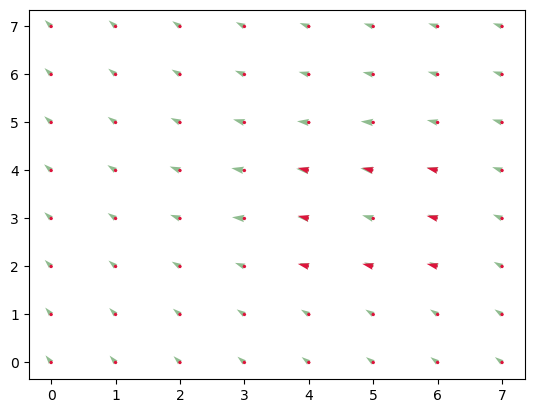

115 [5.50884354 3.9207541 ] [-0.00353354  0.00072449]


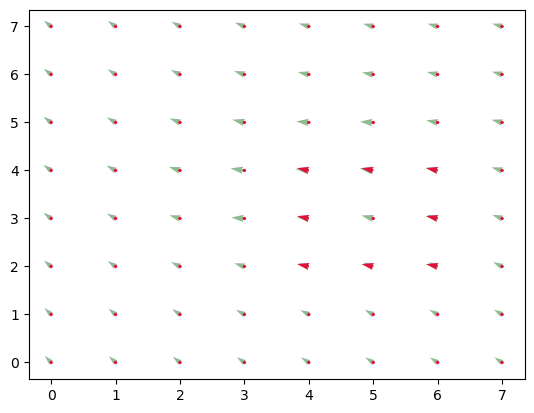

116 [5.49470939 3.92365205] [-0.00374347  0.00066047]


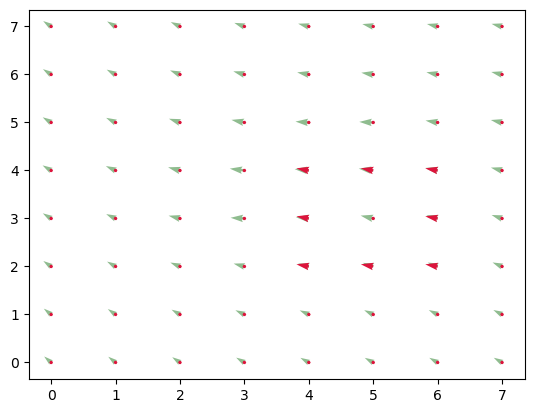

117 [5.47973551 3.92629394] [-0.00395521  0.00060246]


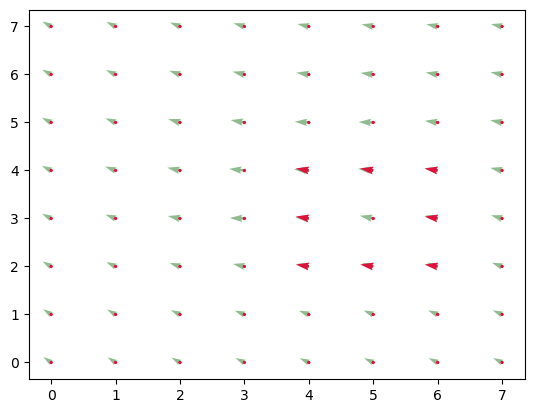

118 [5.46391466 3.92870376] [-0.00416726  0.00055095]


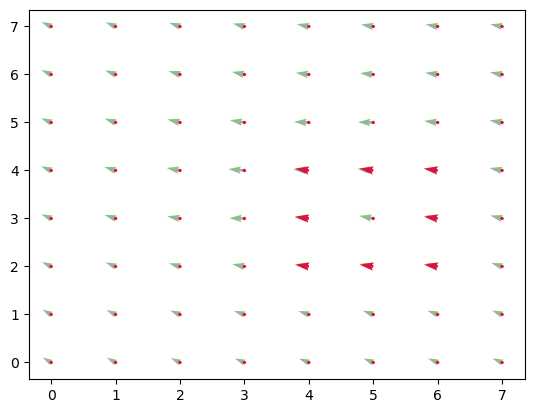

119 [5.44724561 3.93090757] [-0.00437811  0.00050621]


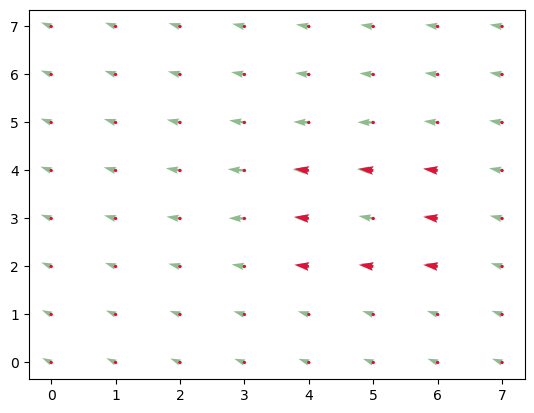

120 [5.42973317 3.93293242] [-0.0045862   0.00046774]


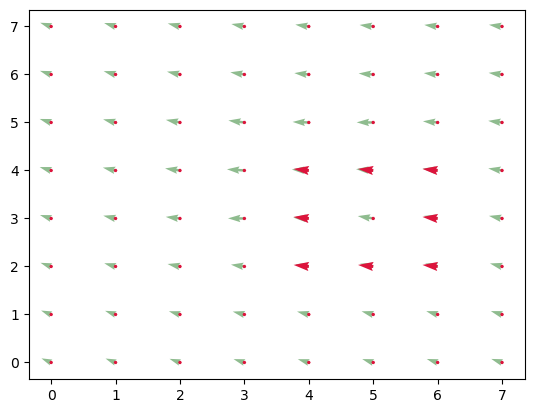

121 [5.41138838 3.93480339] [-0.00478931  0.00043561]


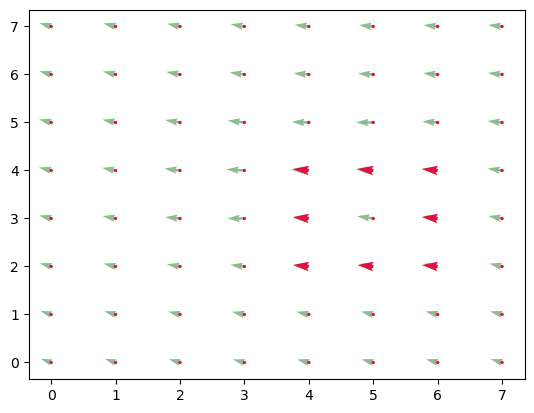

122 [5.39223115 3.93654585] [-0.00498478  0.00040985]


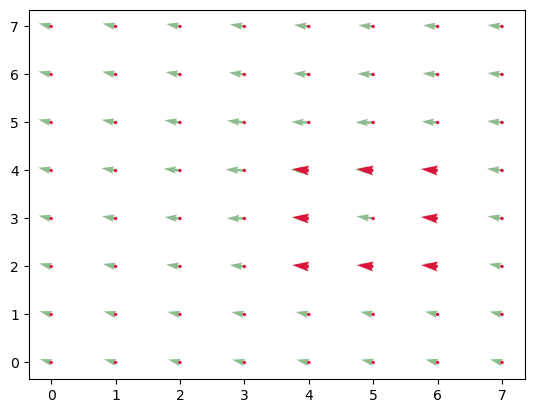

123 [5.37229203 3.93818524] [-0.00517326  0.00039046]


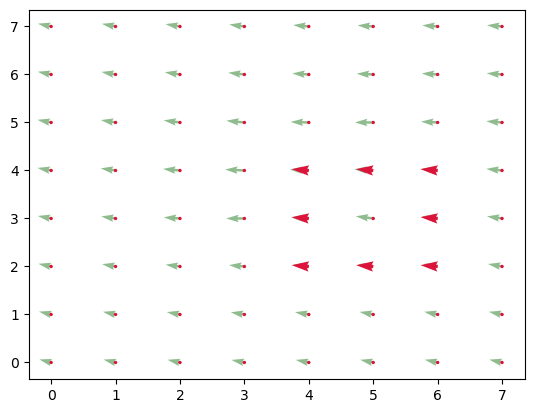

124 [5.35159899 3.93974708] [-0.00535505  0.00037753]


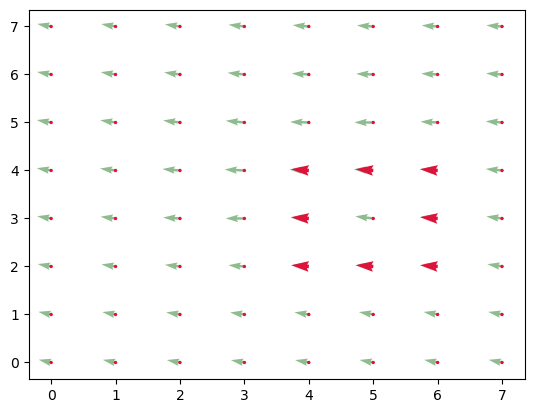

125 [5.33017877 3.94125721] [-0.00552963  0.00037029]


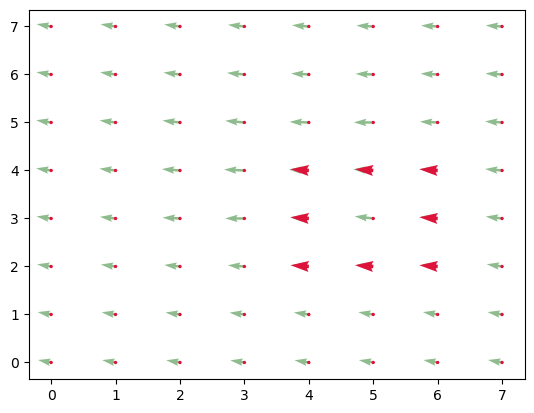

126 [5.30806024 3.94273836] [-0.00569704  0.00036933]


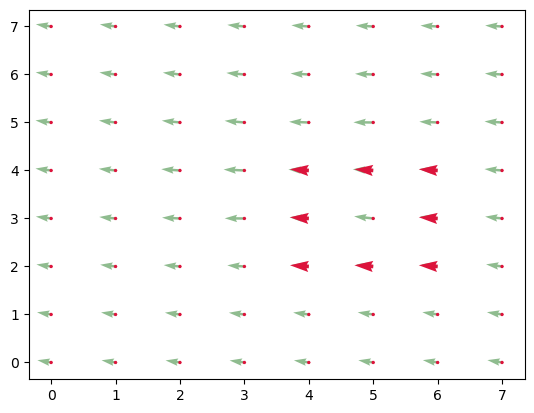

127 [5.28527209 3.9442157 ] [-0.00585714  0.0003748 ]


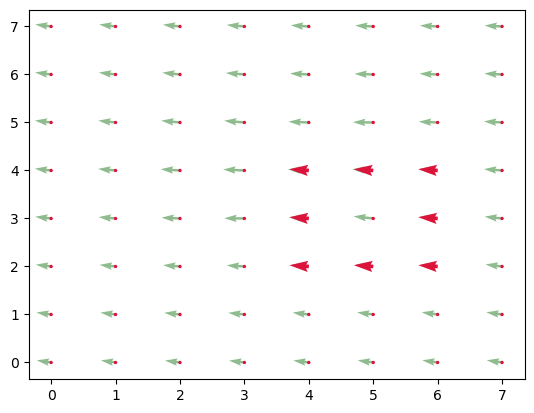

128 [5.26184354 3.94571489] [-0.0060112   0.00038588]


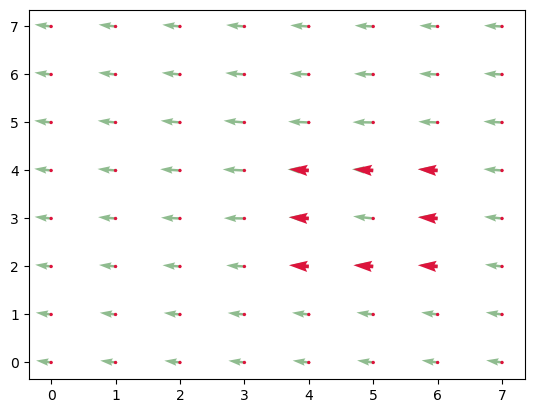

129 [5.23779874 3.94725843] [-0.00615922  0.00040327]


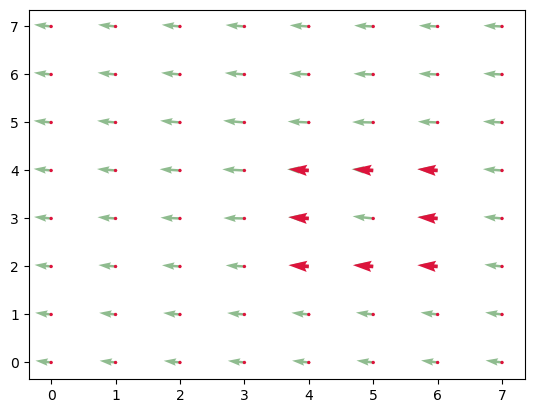

130 [5.21316184 3.94887153] [-0.00629918  0.00042621]


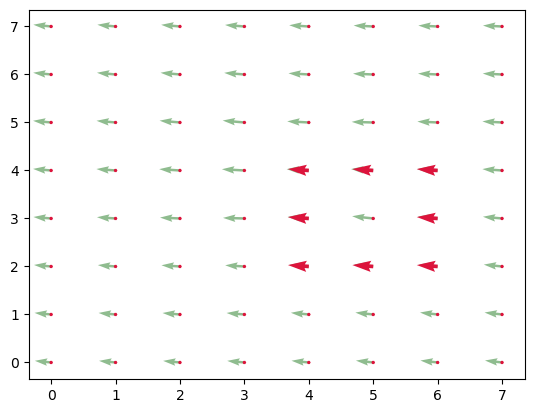

131 [5.1879651  3.95057636] [-0.00643247  0.0004549 ]


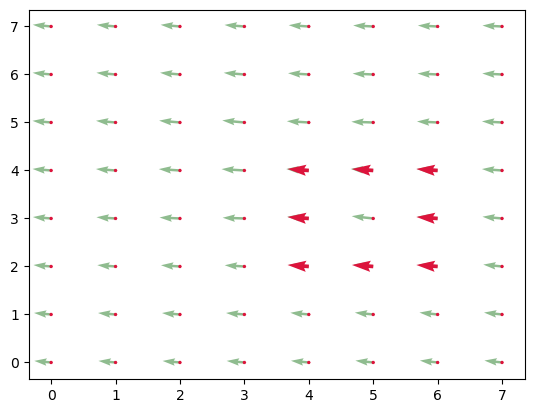

132 [5.1622352  3.95239596] [-0.00656095  0.00048892]


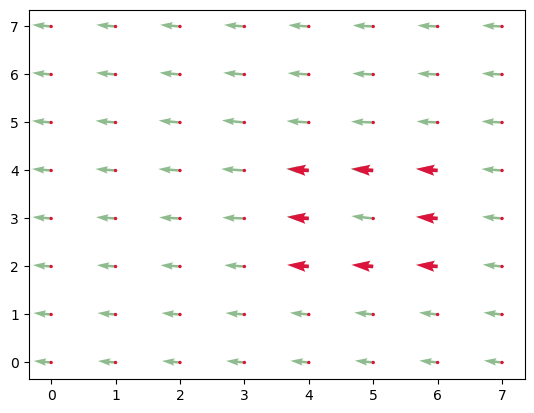

133 [5.13599139 3.95435162] [-0.00668444  0.00052815]


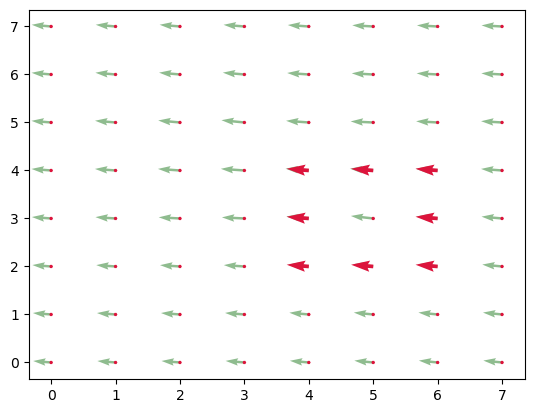

134 [5.10925363 3.95646421] [-0.00680138  0.00057205]


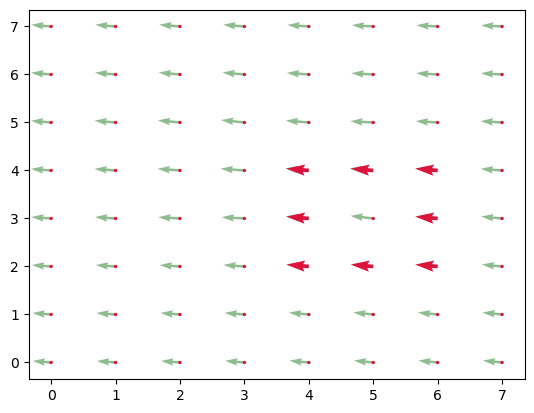

135 [5.08204811 3.95875242] [-0.00691255  0.00062044]


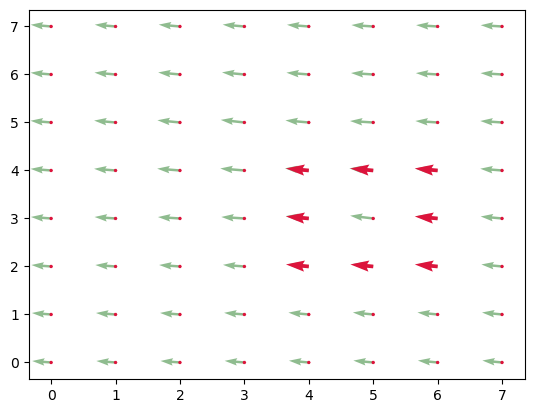

136 [5.0543979  3.96123419] [-0.00693514  0.00063655]


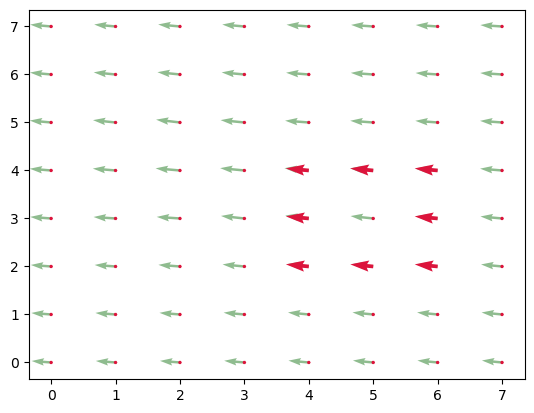

137 [5.02665735 3.96378037] [-0.00697937  0.00066701]


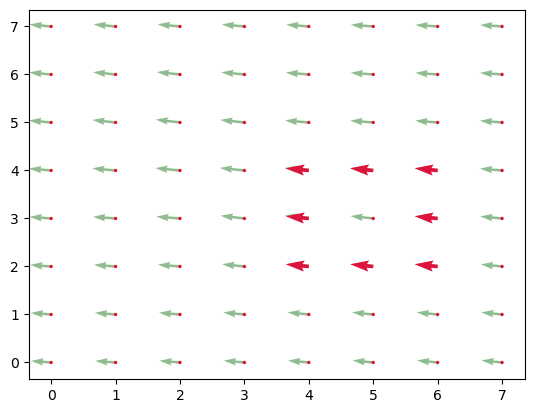

138 [4.99873988 3.96644841] [-0.00704605  0.00070511]


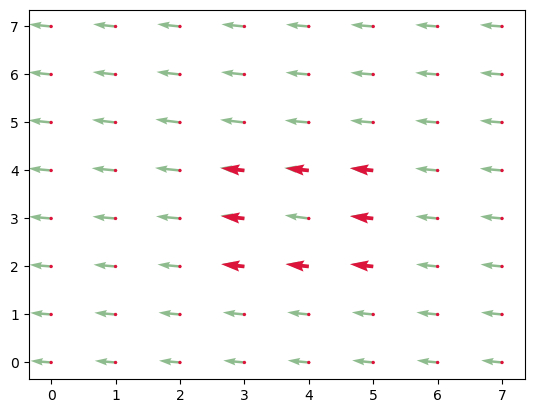

139 [4.97055567 3.96926885] [-0.00710106  0.00073344]


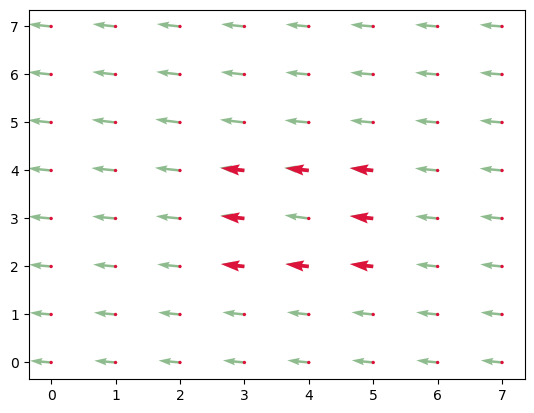

140 [4.94215145 3.97220261] [-0.00717385  0.00077398]


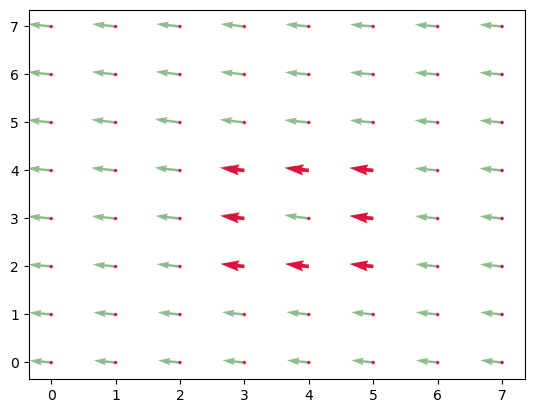

141 [4.91345606 3.97529854] [-0.00724833  0.00081891]


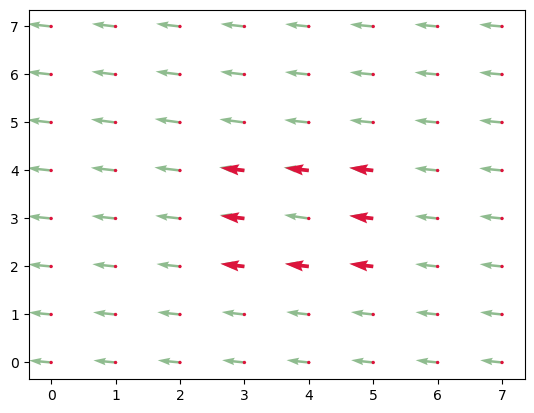

142 [4.88446274 3.9785742 ] [-0.007321    0.00086626]


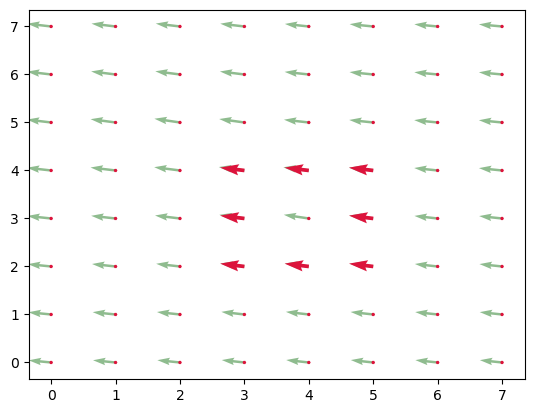

143 [4.85517874 3.98203922] [-0.00739013  0.00091537]


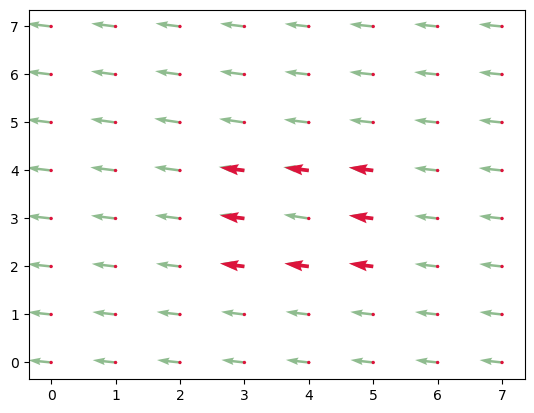

144 [4.82561821 3.98570072] [-0.0074546   0.00096524]


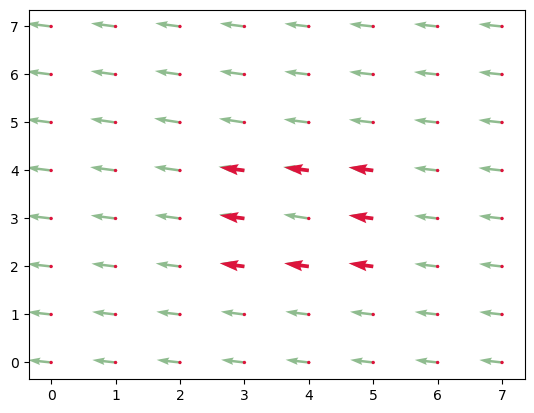

145 [4.79579982 3.98956167] [-0.00751652  0.00101963]


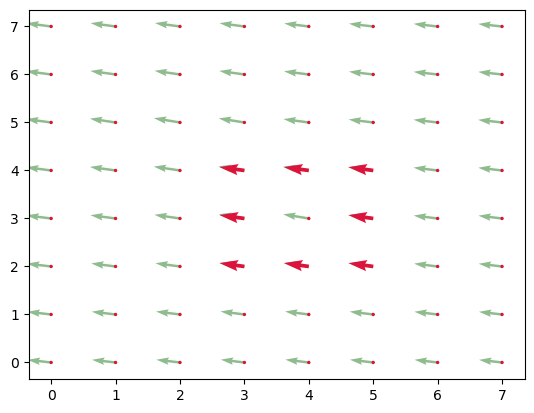

146 [4.76573372 3.9936402 ] [-0.00756959  0.00106912]


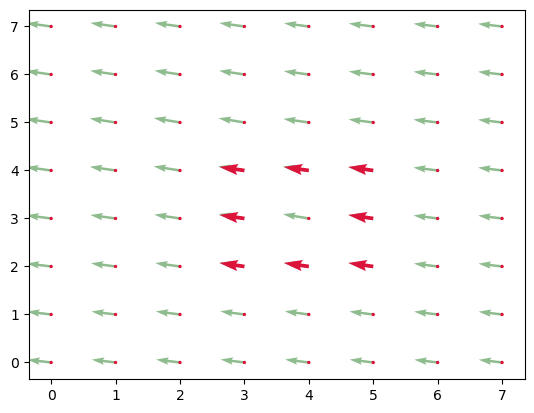

147 [4.73545536 3.99791668] [-0.00761409  0.00111771]


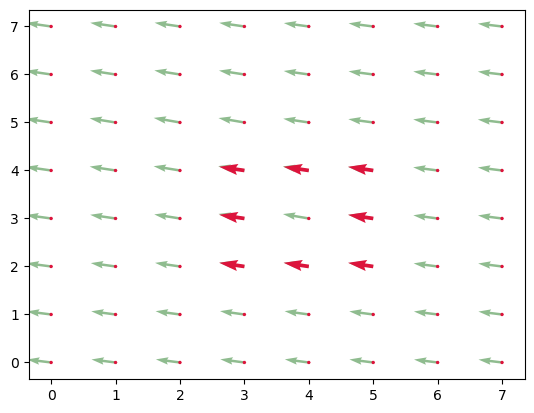

148 [4.70499901 4.00238753] [-0.00765318  0.0011555 ]


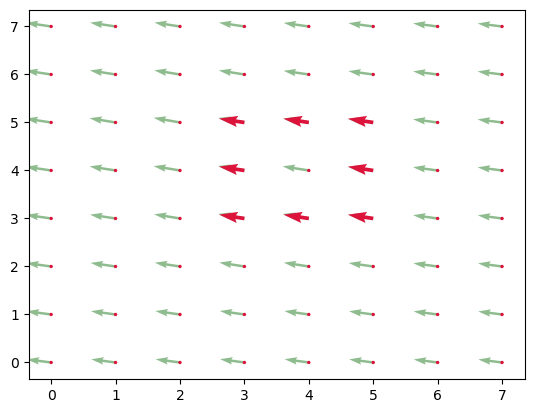

149 [4.67438629 4.00700953] [-0.00768389  0.00119875]


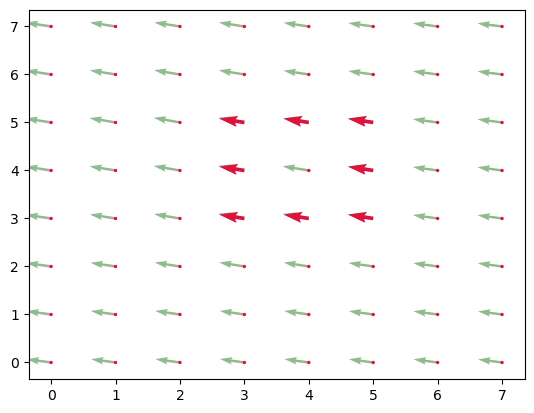

150 [4.64365074 4.01180452] [-0.00770282  0.00124577]


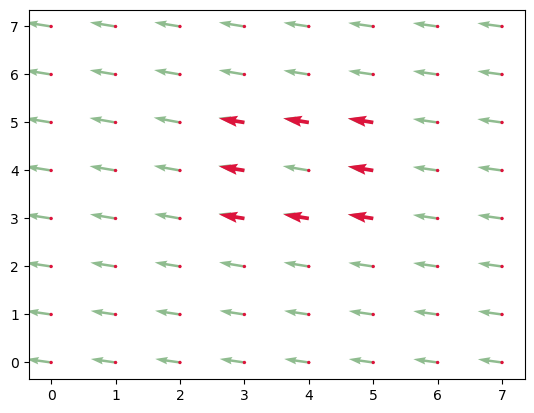

151 [4.61283947 4.01678759] [-0.00771053  0.00128672]


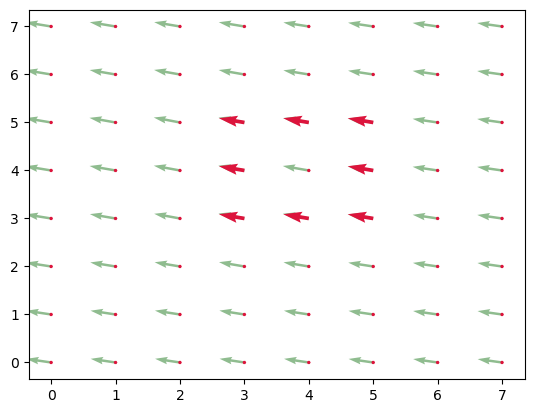

152 [4.58199734 4.02193449] [-0.00770907  0.00132718]


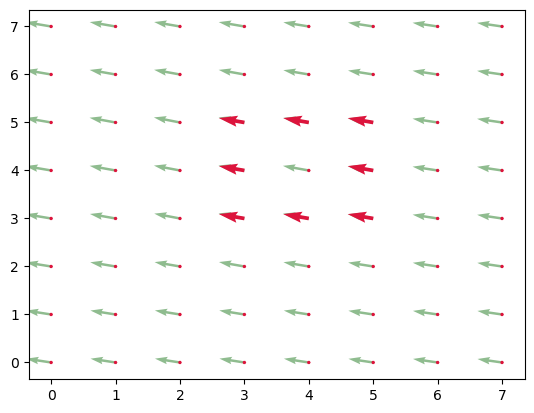

153 [4.55116104 4.0272432 ] [-0.00771791  0.00135875]


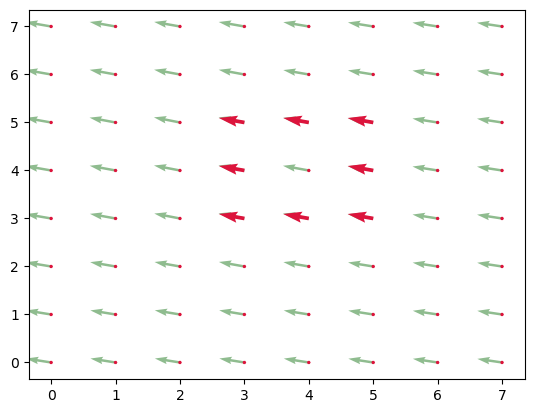

154 [4.52028938 4.03267818] [-0.00770585  0.00139553]


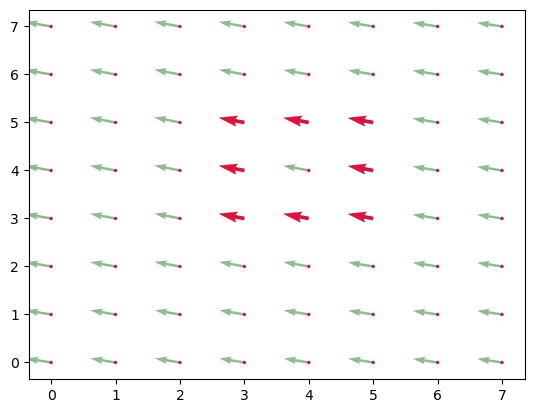

155 [4.489466   4.03826031] [-0.0076814  0.0014338]


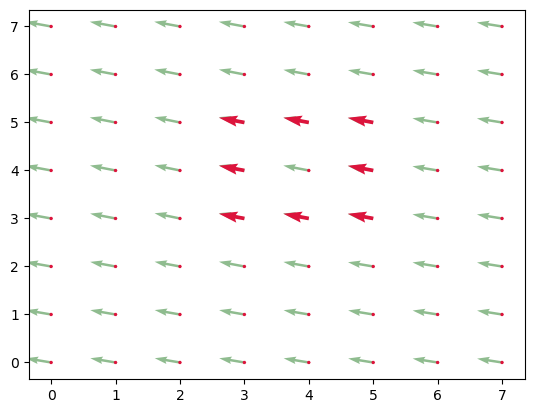

156 [4.4587404 4.0439955] [-0.00764726  0.00147306]


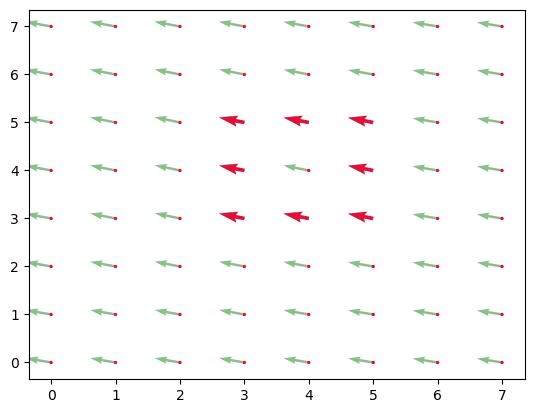

157 [4.42815135 4.04988775] [-0.00760505  0.00151376]


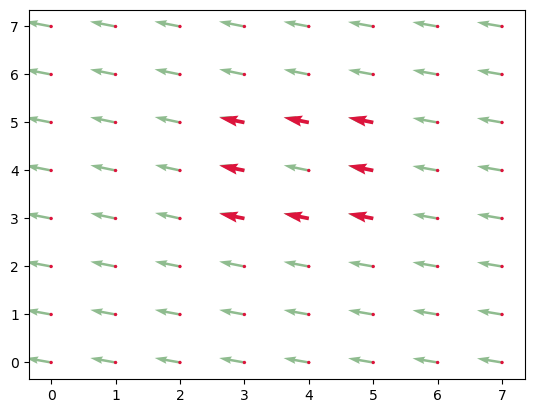

158 [4.39773116 4.05594278] [-0.00755655  0.00155655]


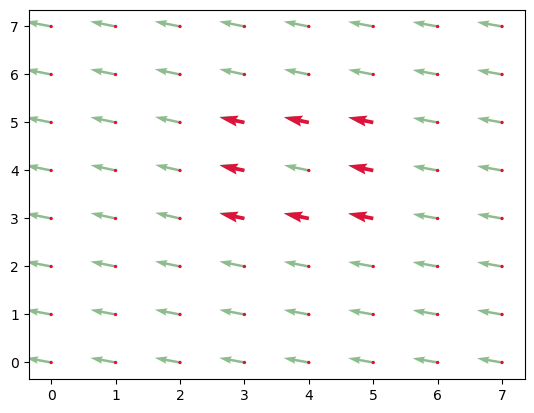

159 [4.36750497 4.06216898] [-0.00750395  0.00160197]


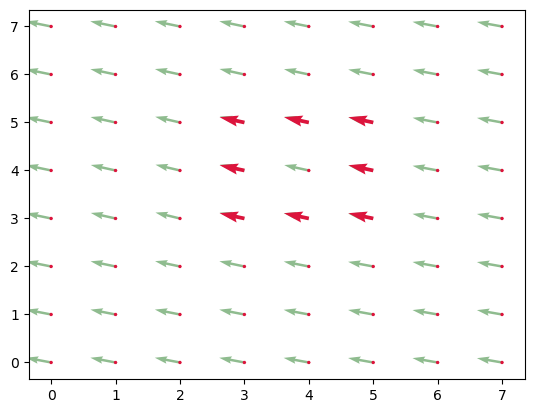

160 [4.33748919 4.06857686] [-0.0074475   0.00165073]


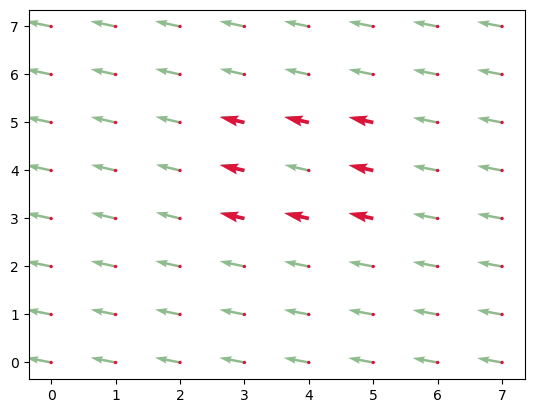

161 [4.30769918 4.07517976] [-0.00738959  0.00170281]


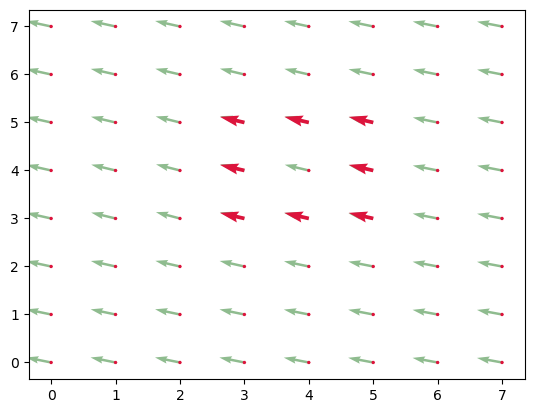

162 [4.27814082 4.08199099] [-0.00733125  0.00175959]


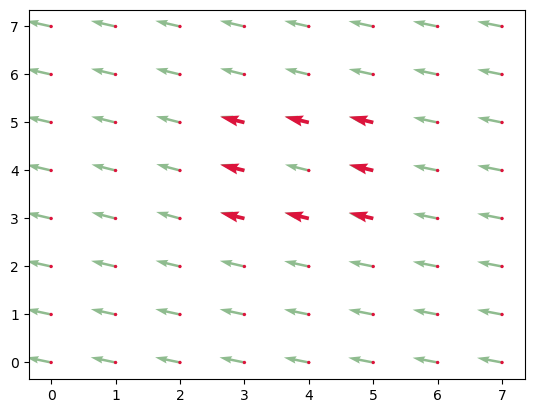

163 [4.24881582 4.08902934] [-0.00727517  0.0018204 ]


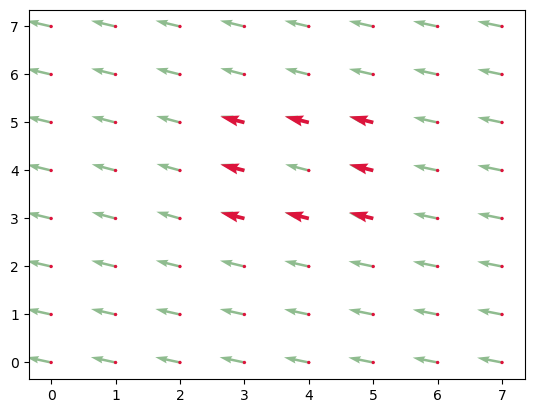

164 [4.21971515 4.09631092] [-0.00722143  0.00188611]


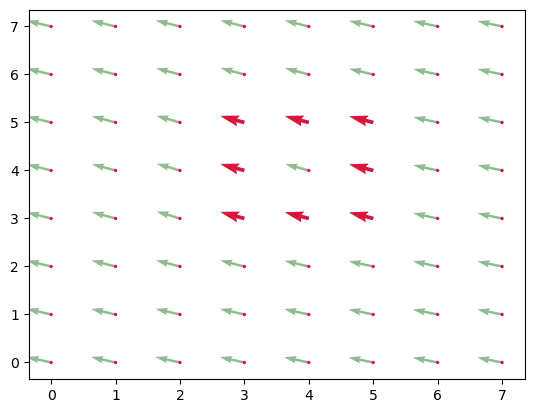

165 [4.19082944 4.10385537] [-0.00718787  0.0019345 ]


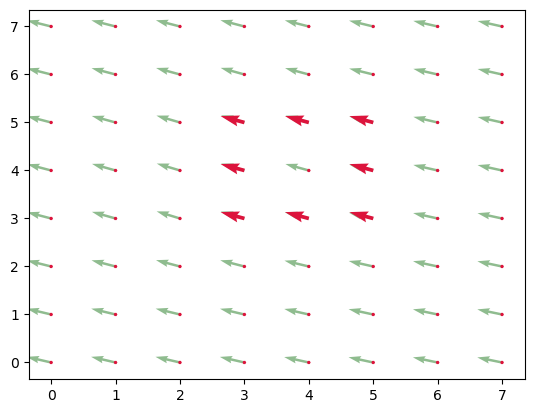

166 [4.16207796 4.11159337] [-0.00718245  0.00192613]


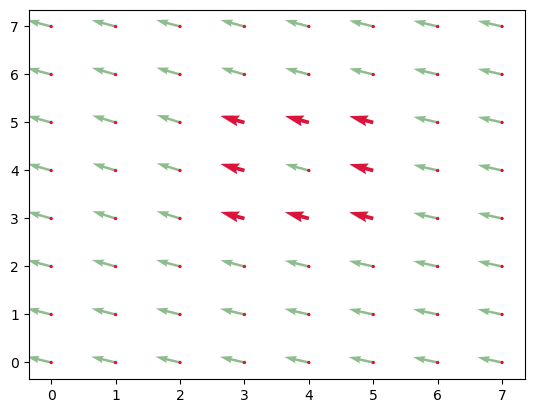

167 [4.13334817 4.11929791] [-0.00716311  0.00195904]


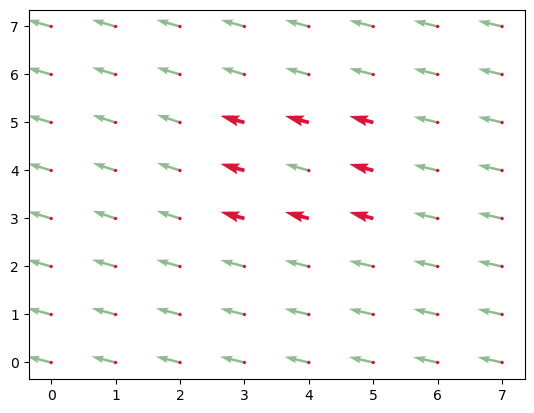

168 [4.10469575 4.12713406] [-0.00713728  0.00200921]


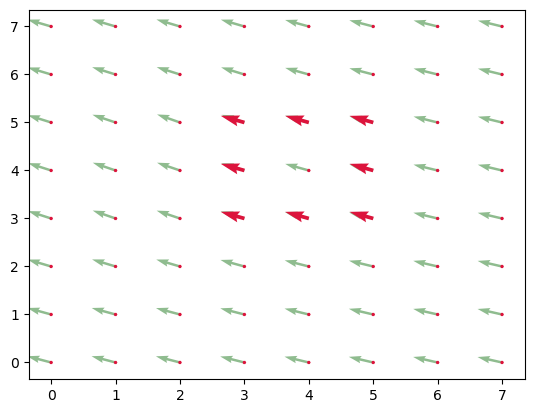

169 [4.07614664 4.1351709 ] [-0.00711675  0.00205453]


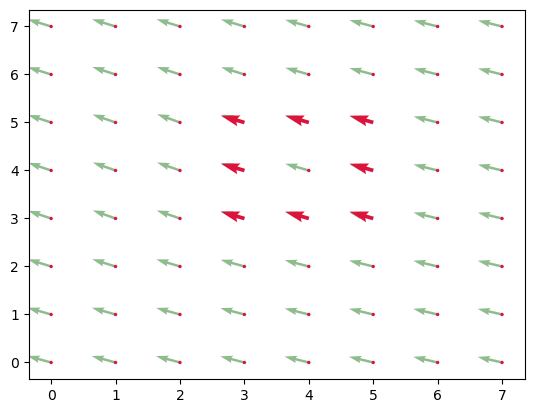

170 [4.04767963 4.14338904] [-0.00709222  0.00211519]


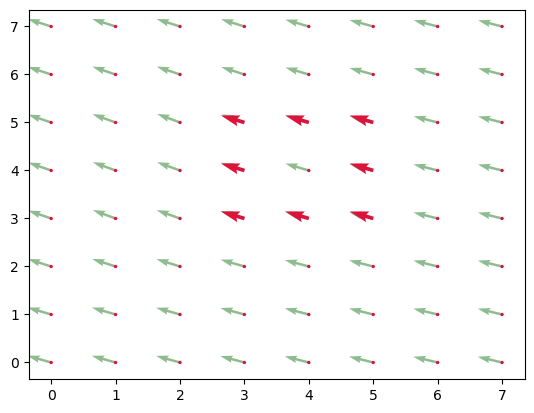

171 [4.01931076 4.15184978] [-0.00706893  0.00218379]


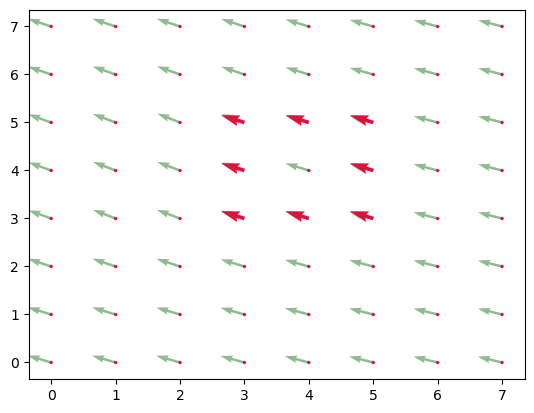

172 [3.99103502 4.16058494] [-0.00705193  0.0022415 ]


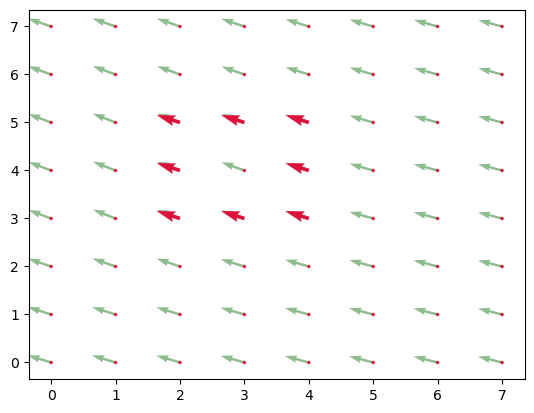

173 [3.96282728 4.16955093] [-0.00703538  0.0023152 ]


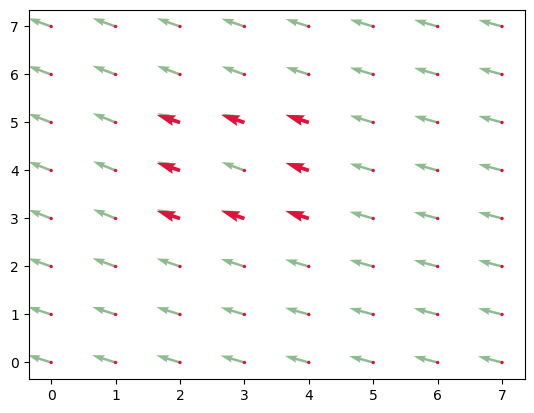

174 [3.93468576 4.17881172] [-0.0070225   0.00239614]


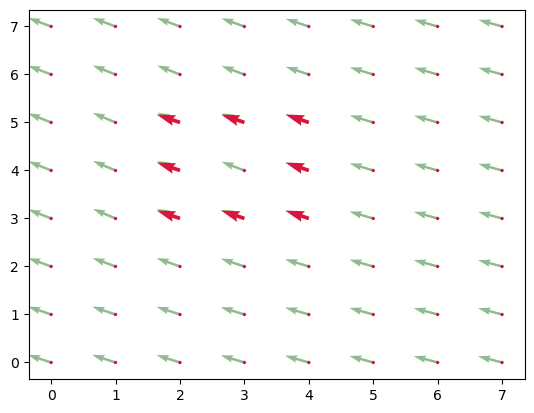

175 [3.90659575 4.18839629] [-0.00701241  0.00248245]


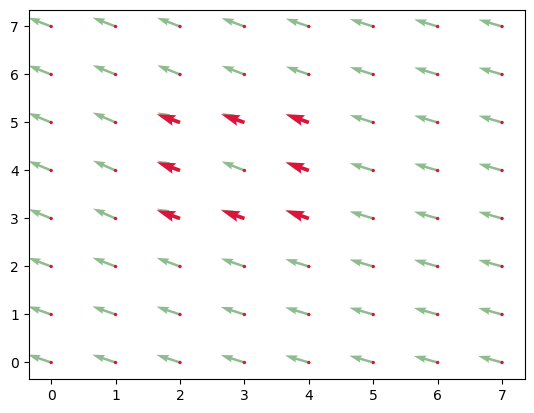

176 [3.87854611 4.19832608] [-0.00700504  0.00255544]


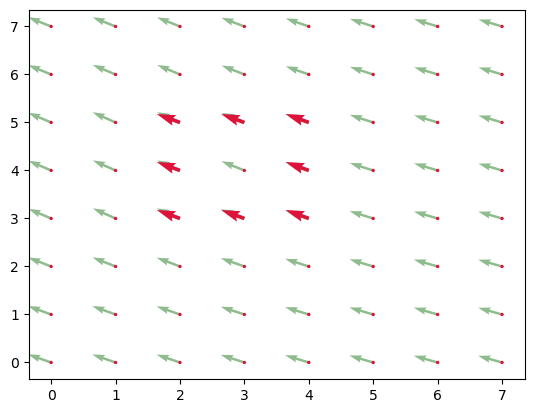

177 [3.85052594 4.20854783] [-0.00700091  0.00264413]


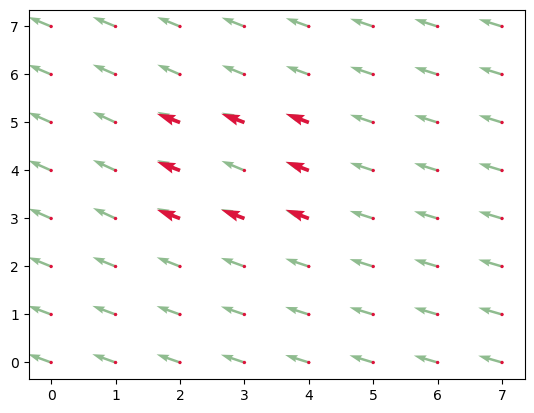

178 [3.8225223  4.21912435] [-0.00699977  0.00273949]


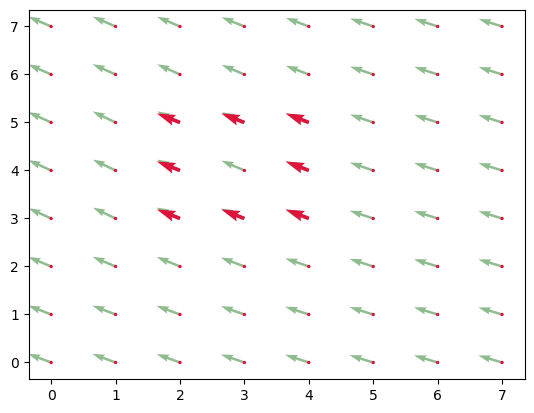

179 [3.79452321 4.23008232] [-0.00700037  0.00282045]


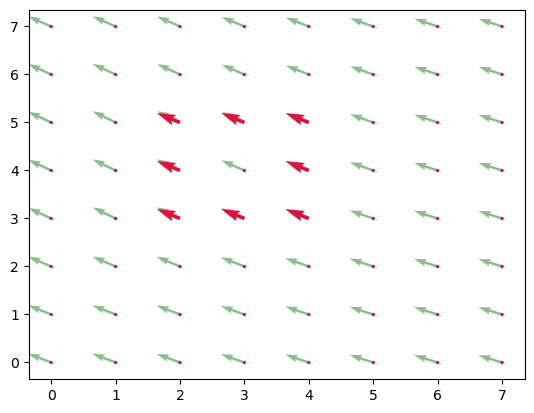

180 [3.76652175 4.24136414] [-0.00700526  0.0029182 ]


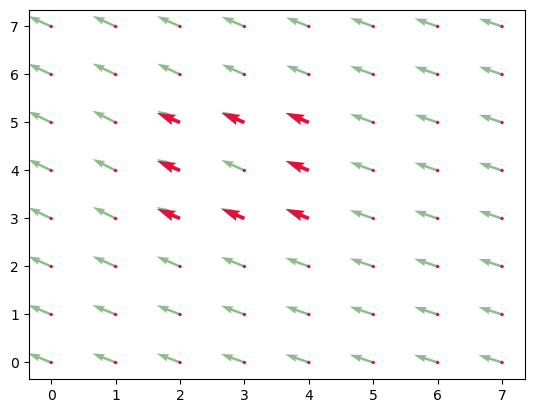

181 [3.73850071 4.25303692] [-0.00701844  0.00304334]


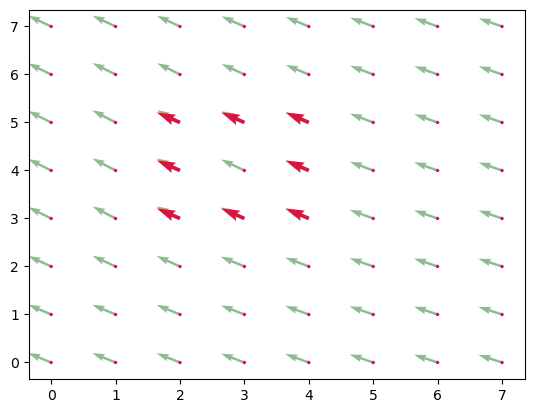

182 [3.71042695 4.26521029] [-0.00702832  0.00315829]


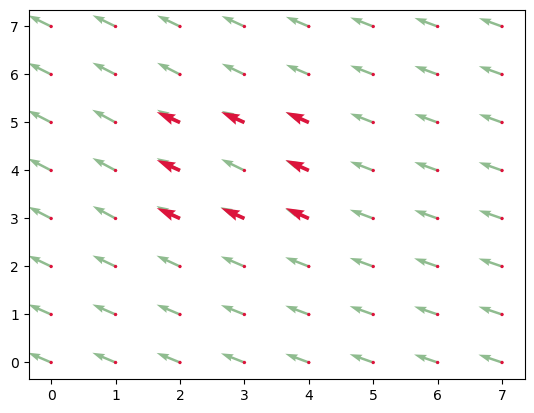

183 [3.68231368 4.27784347] [-0.00704607  0.00329906]


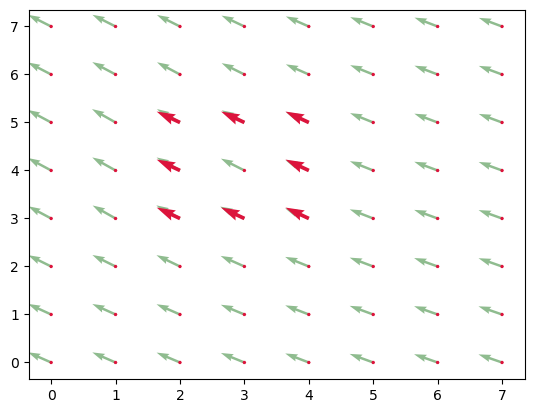

184 [3.65412939 4.29103971] [-0.00706215  0.00342758]


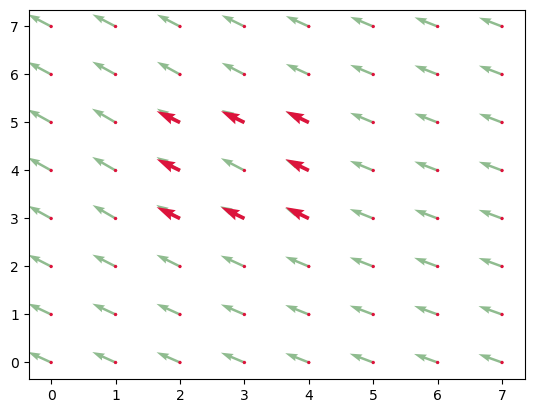

185 [3.6258808  4.30475002] [-0.00708403  0.00358439]


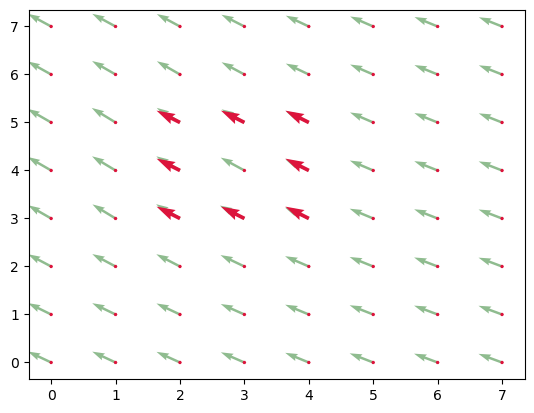

186 [3.59754467 4.31908758] [-0.00710079  0.00372282]


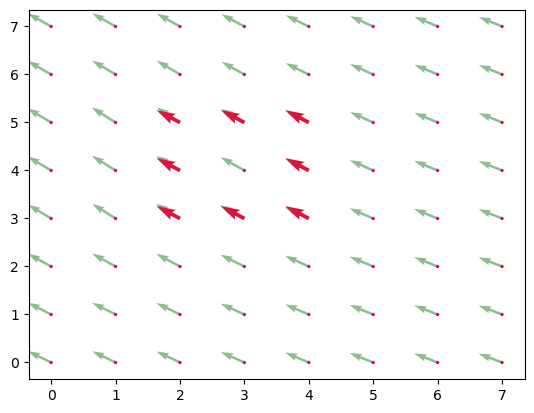

187 [3.56914152 4.33397885] [-0.00712024  0.00389288]


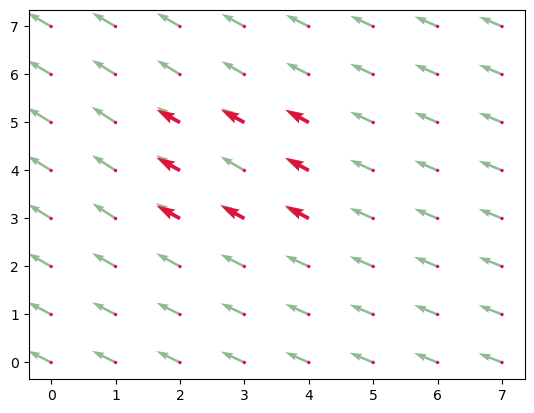

188 [3.54066054 4.34955037] [-0.0071384  0.0040435]


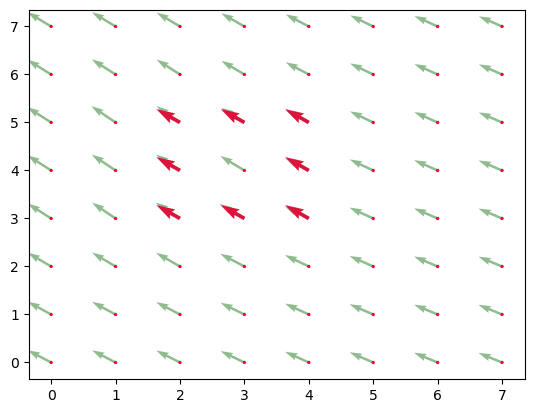

189 [3.51210695 4.36572438] [-0.00715561  0.00422942]


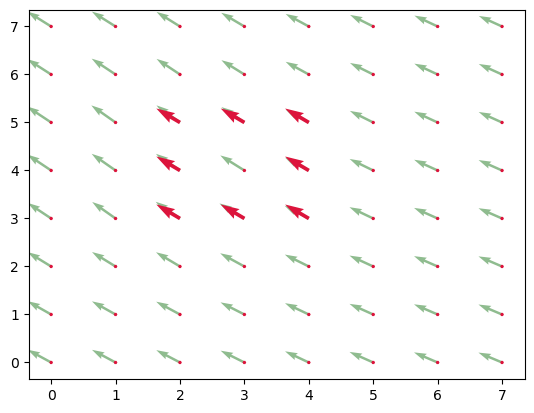

190 [3.48348452 4.38264207] [-0.00723682  0.00440644]


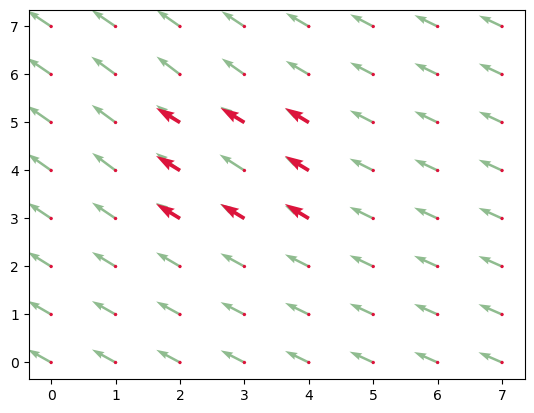

191 [3.45453724 4.40026784] [-0.00726026  0.00455079]


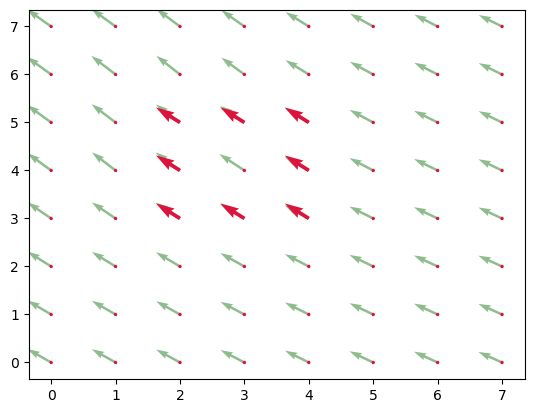

192 [3.42549621 4.418471  ] [-0.00727068  0.00469489]


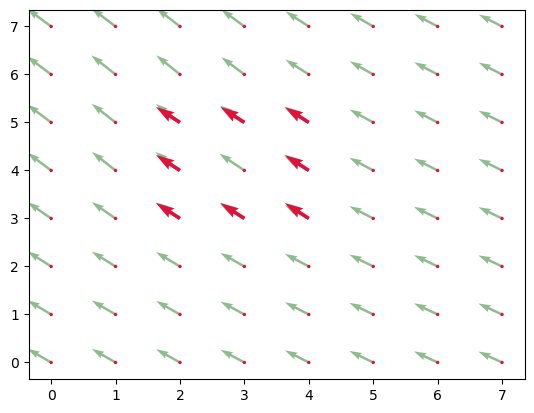

193 [3.39641349 4.43725056] [-0.00728231  0.00484776]


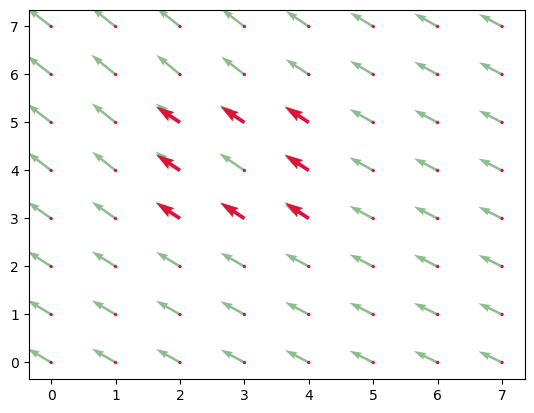

194 [3.36728426 4.45664159] [-0.00729063  0.00500366]


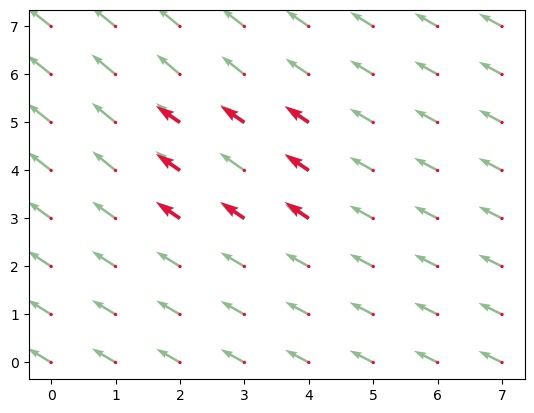

195 [3.33812176 4.47665622] [-0.00729365  0.00520605]


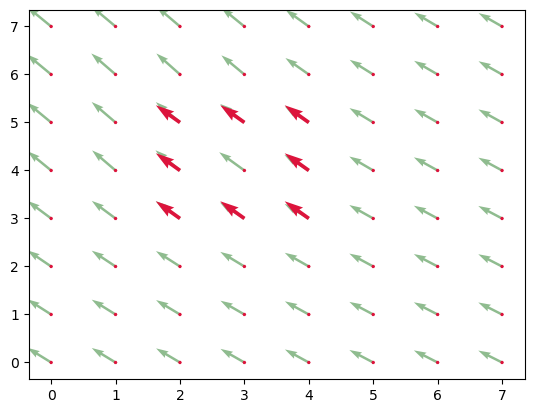

196 [3.30894717 4.49748043] [-0.00729101  0.0053746 ]


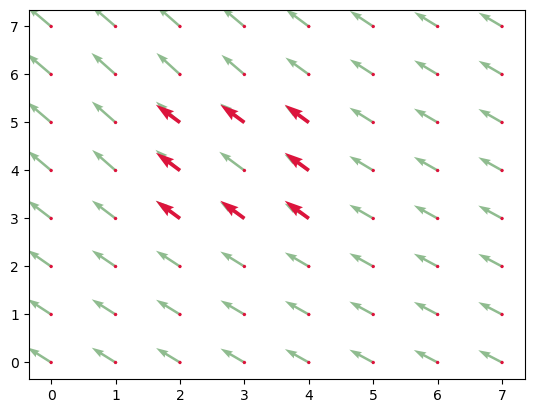

197 [3.27978313 4.51897882] [-0.00728412  0.00558547]


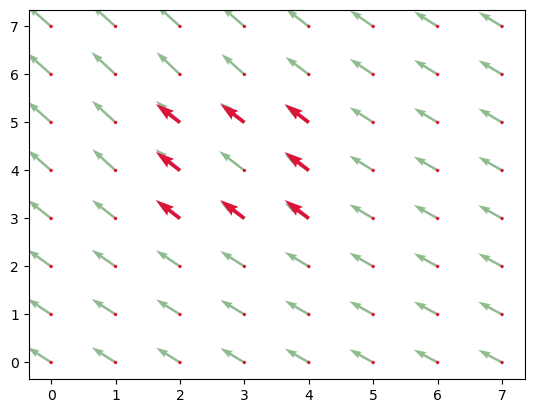

198 [3.25064666 4.54132069] [-0.00726595  0.0058055 ]


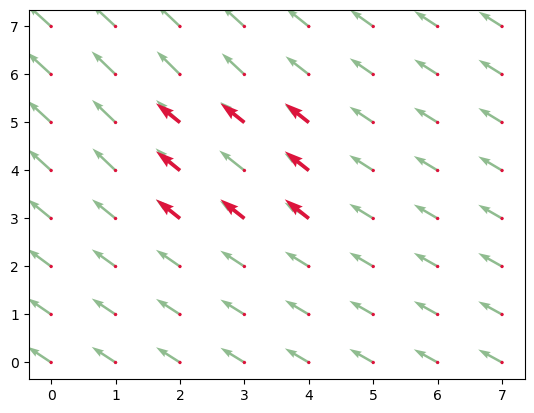

199 [3.22158284 4.56454268] [-0.00725224  0.00598452]


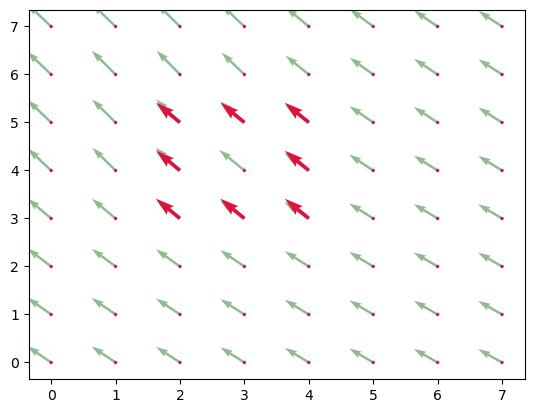

200 [3.19257387 4.58848076] [-0.00723853  0.00589557]


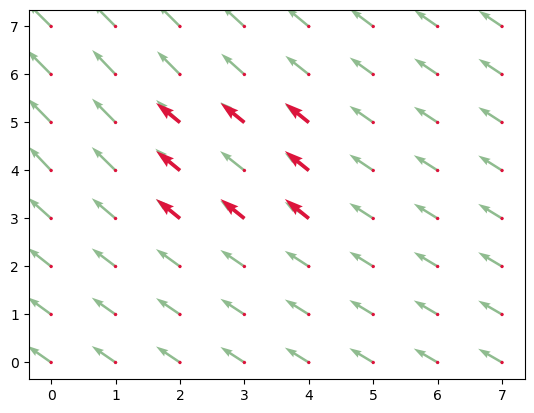

201 [3.16361975 4.61206303] [-0.0072115   0.00595369]


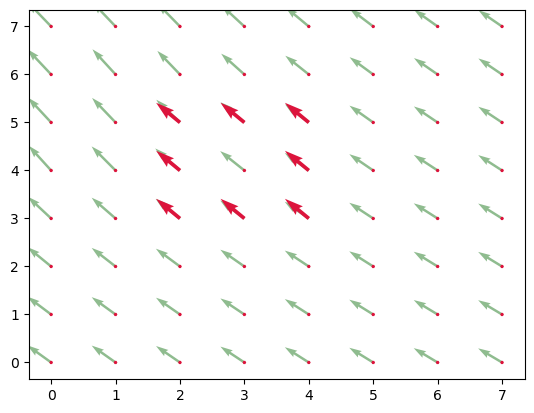

202 [3.13477375 4.63587778] [-0.00718868  0.00604257]


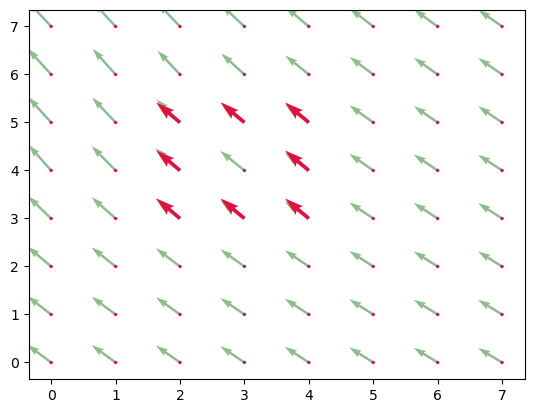

203 [3.10601905 4.66004804] [-0.0071534   0.00616809]


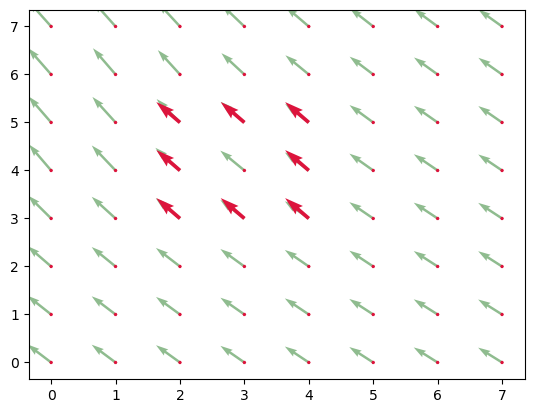

204 [3.07740543 4.6847204 ] [-0.0071235   0.00628692]


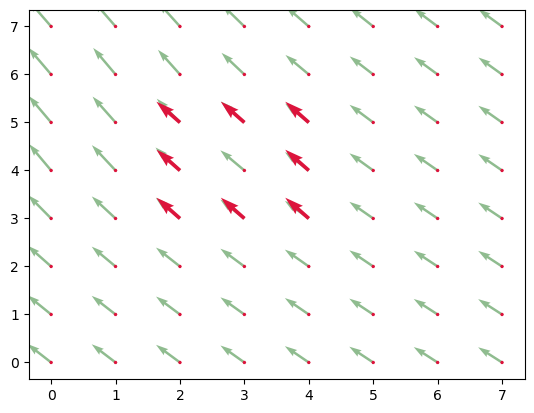

205 [3.04891143 4.7098681 ] [-0.00707482  0.00642148]


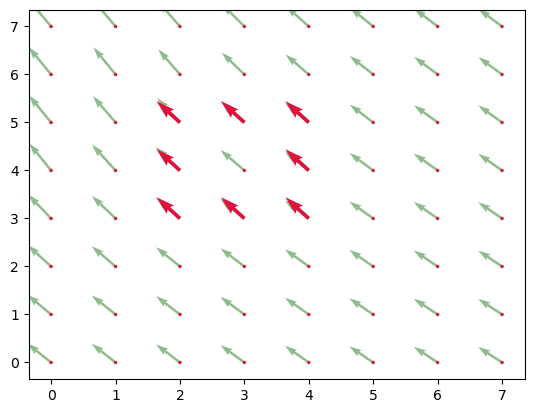

206 [3.02061217 4.735554  ] [-0.00701224  0.00655357]


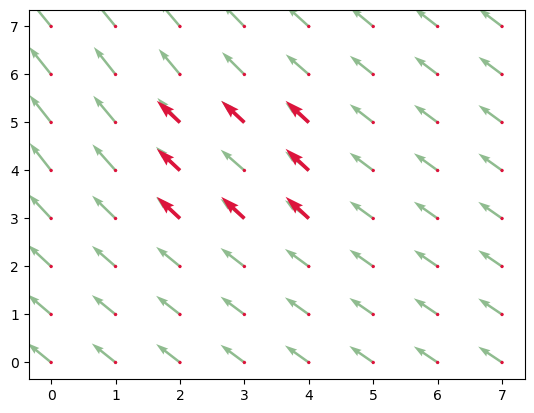

207 [2.99256322 4.76176828] [-0.00695447  0.00667012]


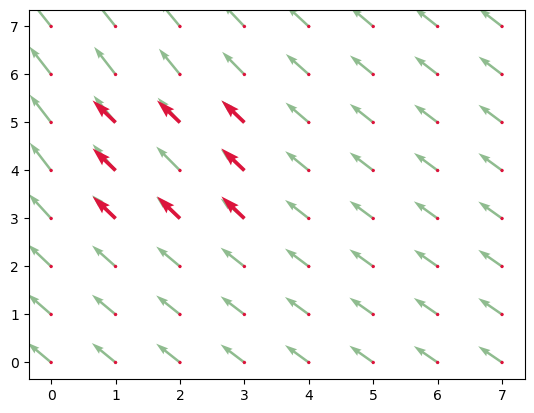

208 [2.96474534 4.78844878] [-0.00689522  0.00678002]


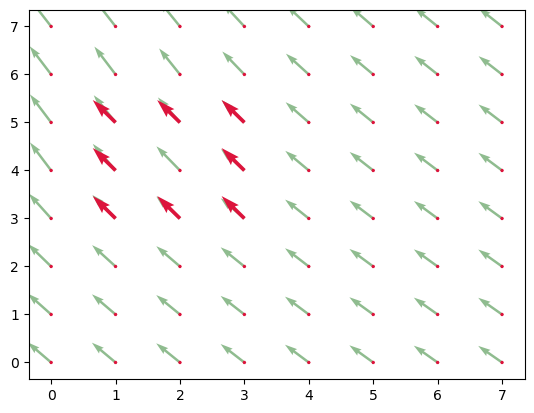

209 [2.93716446 4.81556887] [-0.00684419  0.00688183]


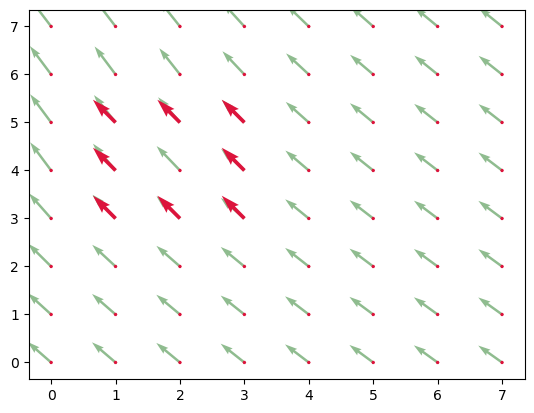

210 [2.90978769 4.84309617] [-0.00678265  0.00697557]


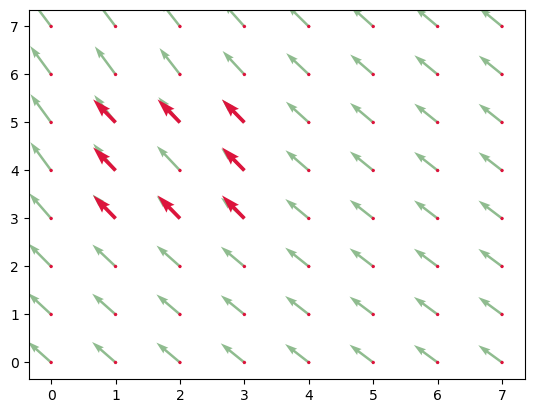

211 [2.88265709 4.87099847] [-0.00667144  0.00705703]


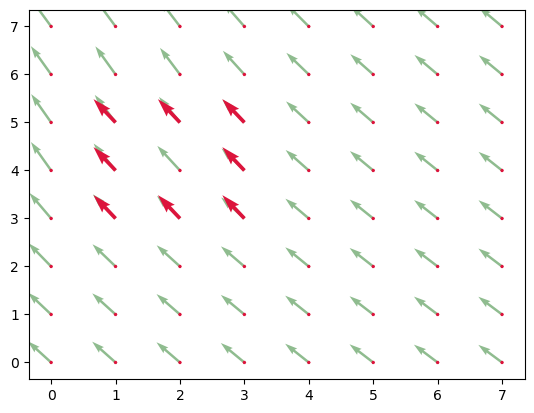

212 [2.85597134 4.8992266 ] [-0.00657138  0.00711968]


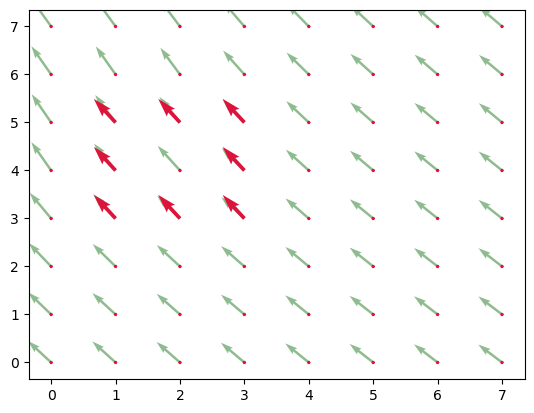

213 [2.8296858  4.92770531] [-0.00649808  0.00718117]


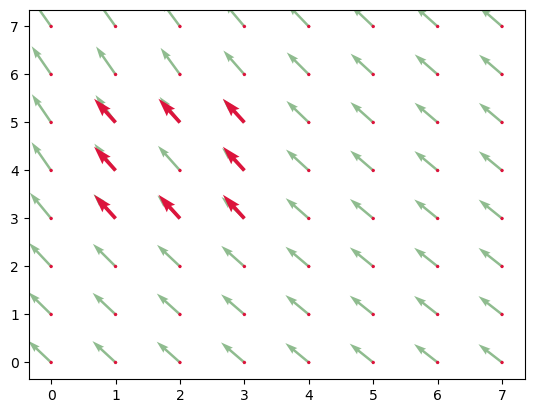

214 [2.8036935  4.95642999] [-0.00641845  0.00722824]


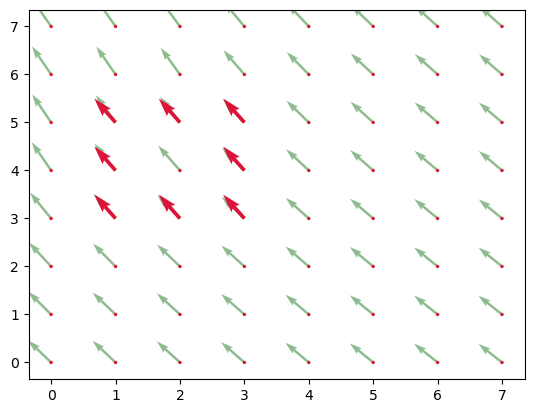

215 [2.7780197  4.98534296] [-0.00633953  0.00726382]


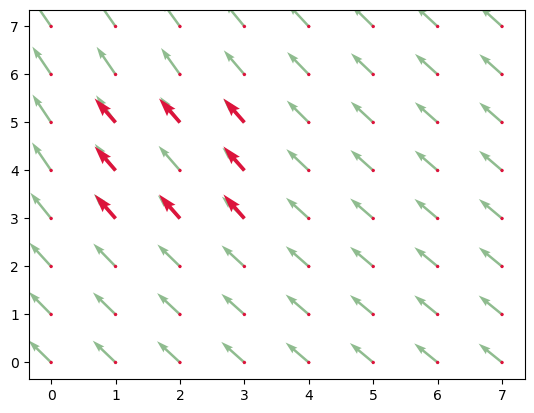

216 [2.75266158 5.01439822] [-0.0062624   0.00728673]


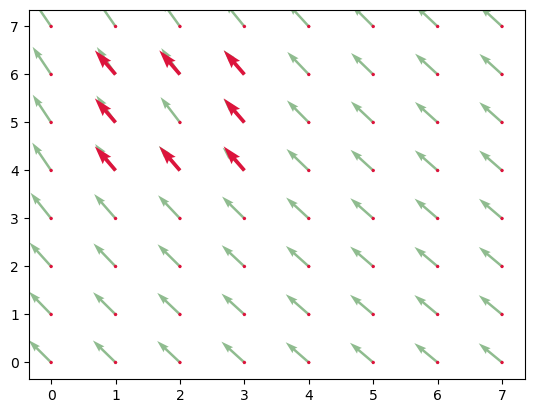

217 [2.727612   5.04354513] [-0.00617279  0.00728401]


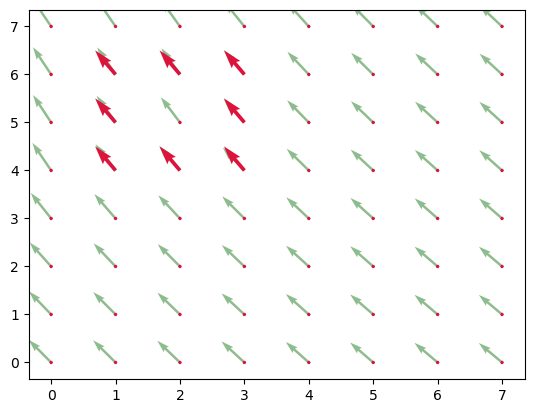

218 [2.70292083 5.07268119] [-0.00608248  0.00726347]


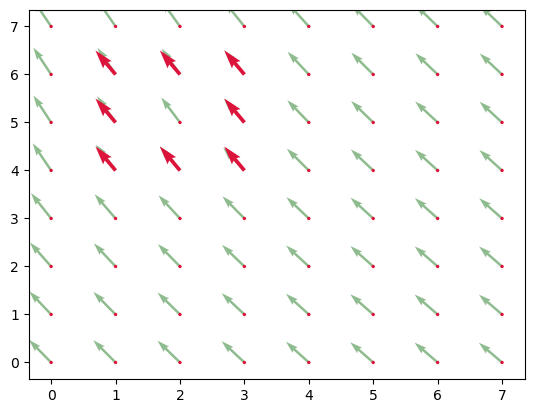

219 [2.6785909  5.10173505] [-0.00600461  0.00724509]


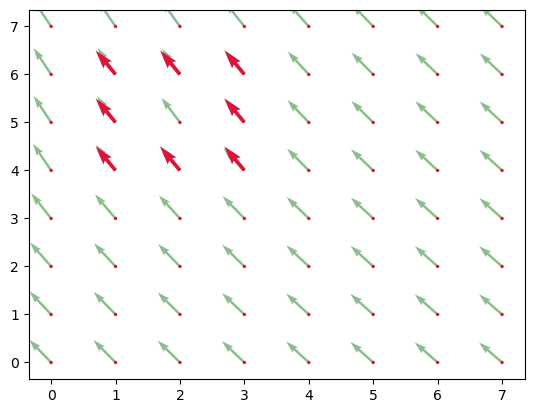

220 [2.65457247 5.1307154 ] [-0.00593125  0.0072199 ]


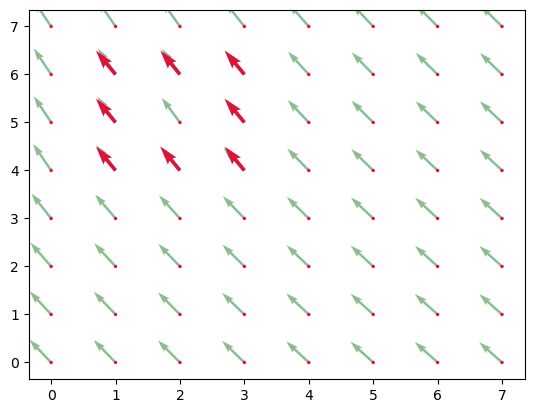

221 [2.63084745 5.15959498] [-0.00585313  0.00716378]


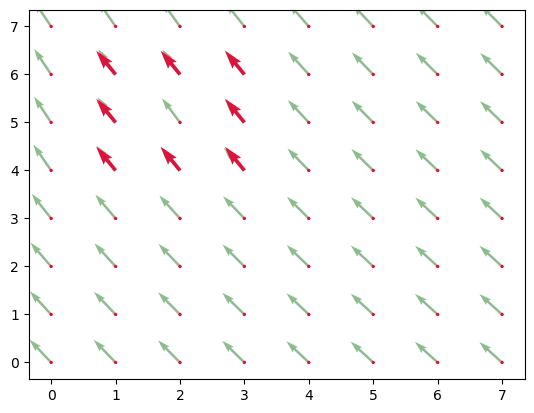

222 [2.60743493 5.18825012] [-0.00579315  0.00713688]


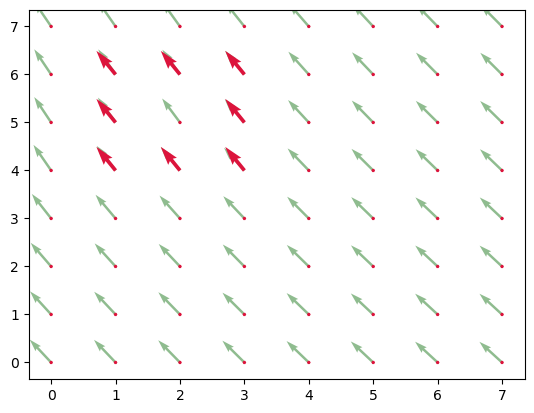

223 [2.58426231 5.21679762] [-0.00572859  0.00708948]


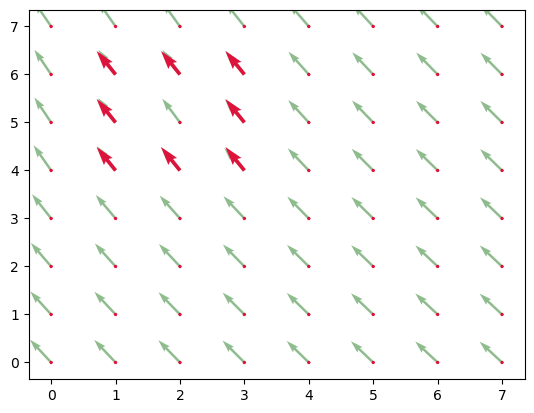

224 [2.56134797 5.24515556] [-0.00572247  0.0070092 ]


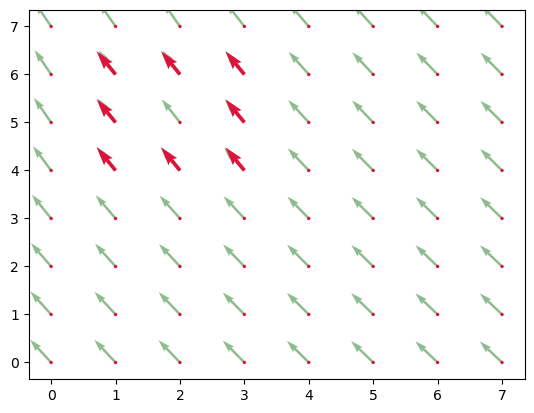

225 [2.53845807 5.27319234] [-0.00568682  0.00692859]


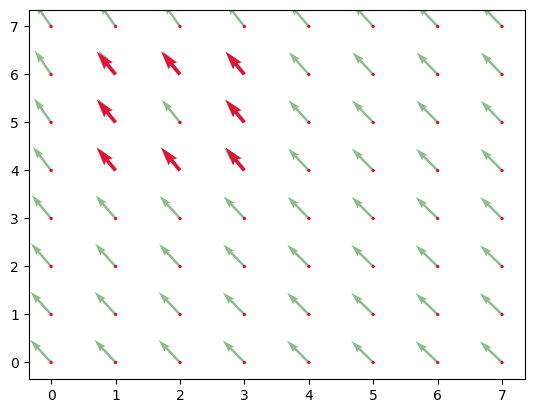

226 [2.5157108  5.30090668] [-0.0056389   0.00684921]


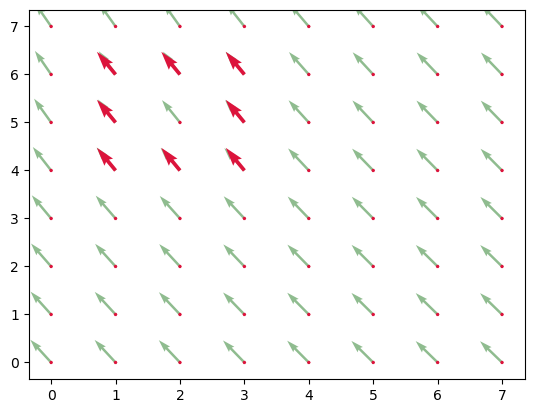

227 [2.4931552  5.32830352] [-0.0055991   0.00679825]


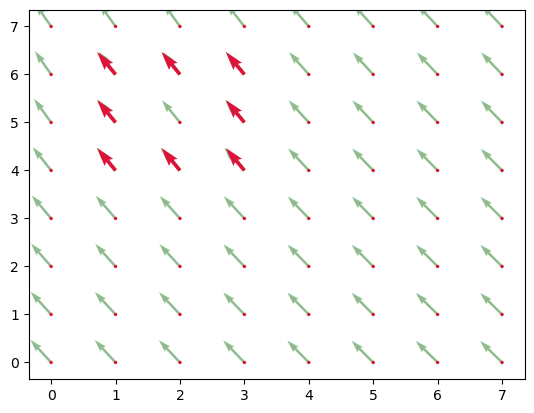

228 [2.47075878 5.3554965 ] [-0.00554642  0.00672362]


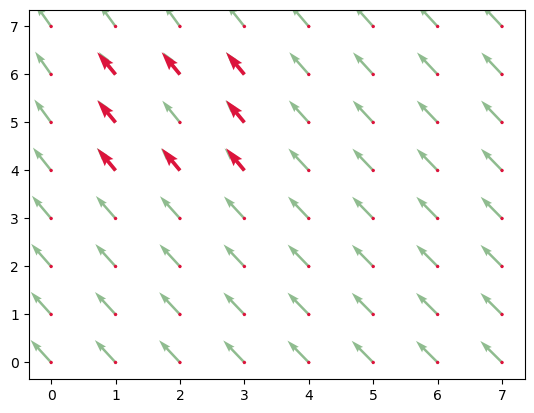

229 [2.44857312 5.38239099] [-0.00550357  0.0066742 ]


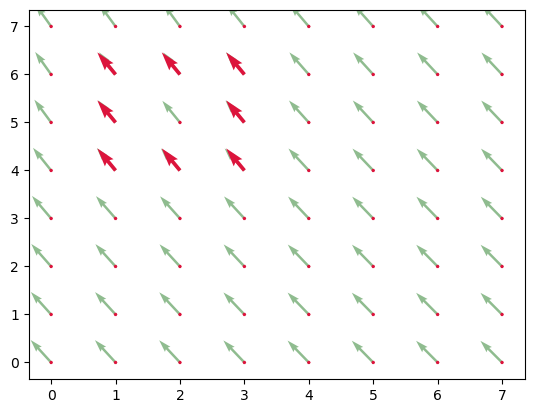

230 [2.42655886 5.4090878 ] [-0.00544974  0.00659661]


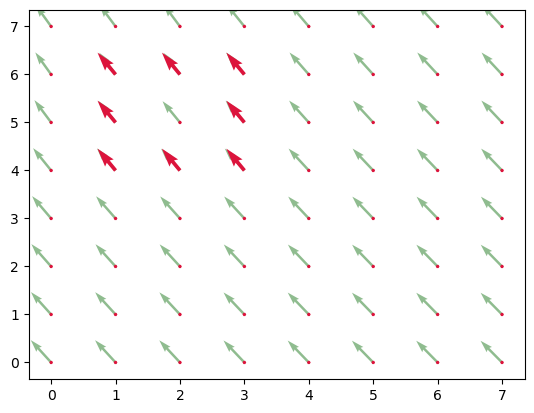

231 [2.40475989 5.43547425] [-0.00539631  0.00650738]


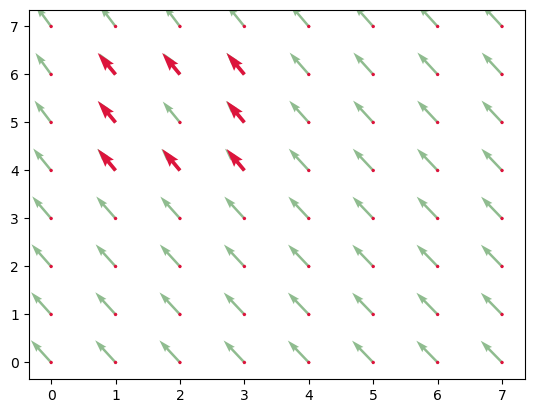

232 [2.38317466 5.46150376] [-0.00534309  0.00641072]


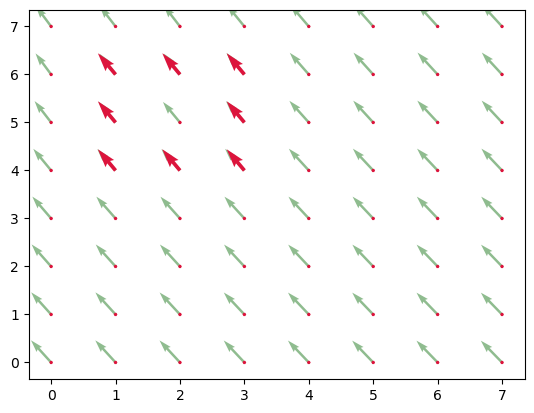

233 [2.36180231 5.48714665] [-0.00529076  0.00630857]


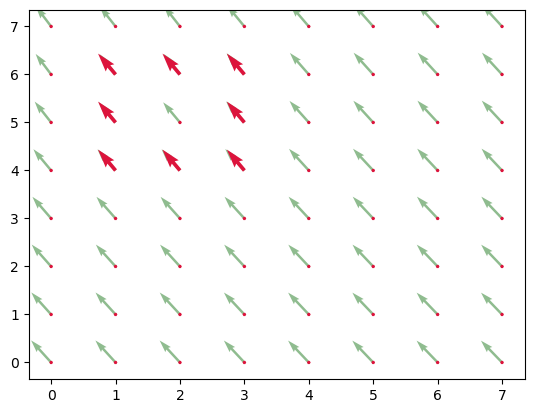

234 [2.34063927 5.51238092] [-0.00523933  0.00620292]


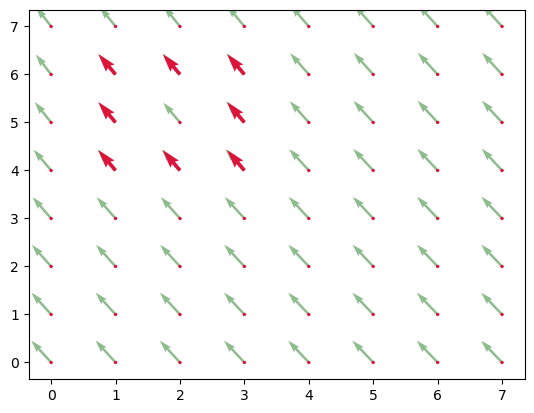

235 [2.31968195 5.53719259] [-0.00519323  0.0061336 ]


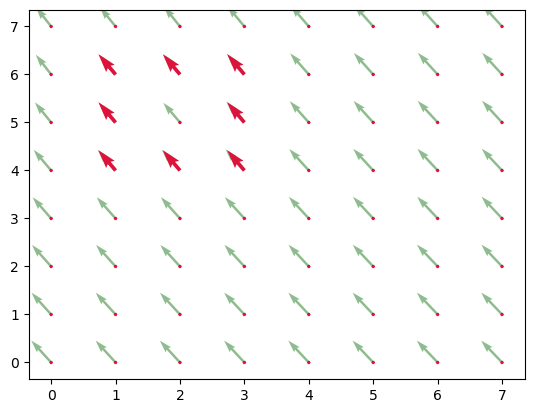

236 [2.29890902 5.561727  ] [-0.0051439   0.00603387]


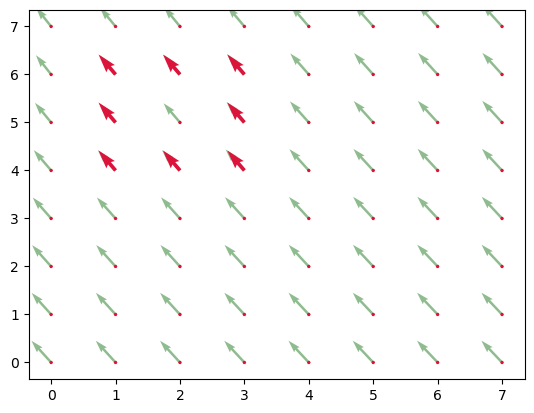

237 [2.27833343 5.5858625 ] [-0.00509841  0.00596771]


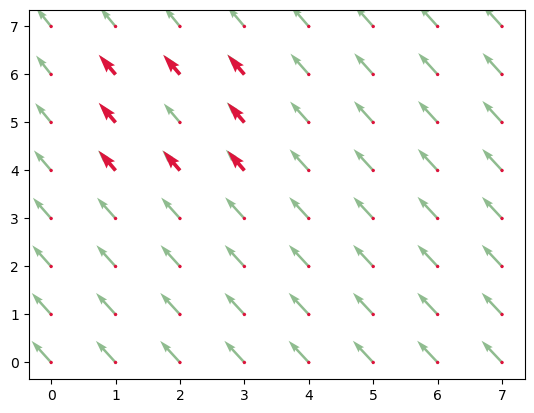

In [63]:
U_final = U.reshape((n_frames, height, width, 2))

test_body_movement = np.zeros_like(U_final)

test_body_poses = np.zeros((n_frames, 2))
test_body_vels = np.zeros((n_frames, 2))
boundary = np.array([[1, 0], [1, 1], [0, 1], [-1, 1], [-1, 0], [-1, -1], [0, -1], [1, -1]])
# test_body_poses[0] = [2, 4]
test_body_poses[0] = [3, 1]


dt = 4

for frame in range(n_frames):
    u_frame = U_final[frame]

    body_vel = np.zeros(2)
    for b in boundary:
        p = test_body_poses[frame] + b
        body_vel += interpolation(u_frame, p[0], p[1])

    body_vel /= len(boundary)

    for b in boundary:
        p = test_body_poses[frame] + b
        test_body_movement[frame][int(p[0]), int(p[1])] = body_vel

    if (frame < n_frames - 1):
        test_body_poses[frame + 1] = test_body_poses[frame] + dt * body_vel

    print(frame, test_body_poses[frame], body_vel)

    plt.quiver(*P, np.array(u_frame[:, :, 0]), np.array(u_frame[:, :, 1]),
               color=['darkseagreen'], scale=0.15, width=0.005)
    
    plt.quiver(*P, np.array(test_body_movement[frame][:, :, 0]), np.array(test_body_movement[frame][:, :, 1]),
               color=['crimson'], scale=0.15)
    plt.show()
